# Assignment 5: Combine Data Cleaning, Feature Cleaning, Modeling and Interpretability

Name: Deepthi Nasika

NUID: 002474582

# MIT License

MIT License

Copyright (c) 2024 Deepthi-Nasika

Permission is hereby granted, free of charge, to any person obtaining a copy
of this software and associated documentation files (the "Software"), to deal
in the Software without restriction, including without limitation the rights
to use, copy, modify, merge, publish, distribute, sublicense, and/or sell
copies of the Software, and to permit persons to whom the Software is
furnished to do so, subject to the following conditions:

The above copyright notice and this permission notice shall be included in all
copies or substantial portions of the Software.

THE SOFTWARE IS PROVIDED "AS IS", WITHOUT WARRANTY OF ANY KIND, EXPRESS OR
IMPLIED, INCLUDING BUT NOT LIMITED TO THE WARRANTIES OF MERCHANTABILITY,
FITNESS FOR A PARTICULAR PURPOSE AND NONINFRINGEMENT. IN NO EVENT SHALL THE
AUTHORS OR COPYRIGHT HOLDERS BE LIABLE FOR ANY CLAIM, DAMAGES OR OTHER
LIABILITY, WHETHER IN AN ACTION OF CONTRACT, TORT OR OTHERWISE, ARISING FROM,
OUT OF OR IN CONNECTION WITH THE SOFTWARE OR THE USE OR OTHER DEALINGS IN THE
SOFTWARE.

# Abstract

A global superstore dataset has been selected, with the target variable considered as "Profit" and the remaining variables as independent variables. Regression is performed on this dataset to predict the value of "Profit" using a set of features that contribute the most towards the prediction. Data cleaning is conducted to impute missing values using various imputation methods. Important features that have a strong impact on predicting the target variable "Profit" are identified through methods such as Correlation Analysis, Random Forest Feature Importance, and Recursive Feature Elimination. AutoML is then employed to determine the best model suitable for the global superstore dataset, aiming for maximum accuracy and minimum errors. Further analysis is conducted using SHAP analysis, LIME analysis, and Partial Dependence Plots on linear models, tree-based models, and the AutoML model trained on the dataset to interpret the model's performance

# Dataset

The dataset contains information about a global superstore which include various attributes related to sales transactions, customer orders, and shipping details. The dataset contains both numeric and categorical variables.

Here is the description of columns present in the dataset:


1.   category: The category of products sold in the superstore.
2.   city: The city where the order was placed.
1.   country: The country in which the superstore is located.
2.   customer_id: A unique identifier for each customer.
1.   customer_name: The name of the customer who placed the order.
1.   discount: The discount applied to the order.
1.   market: The market or region where the superstore operates.
1.   order_date: The date when the order was placed.
1.   order_id: A unique identifier for each order.
2.   order_priority: The priority level of the order.
2.   product_id: A unique identifier for each product.
2.   product_name: The name of the product.
2.   profit: The profit generated from the order.
2.   quantity: The quantity of products ordered.
1.   region: The region where the order was placed.
1.   row_id: A unique identifier for each row in the dataset.
1.   sales: The total sales amount for the order.
2.   segment: The customer segment (e.g., consumer, corporate, or home office).
2.   ship_date: The date when the order was shipped.
2.   ship_mode: The shipping mode used for the order.
1.   shipping_cost: The cost of shipping for the order.
2.   state: The state or region within the country.
1.   sub_category: The sub-category of products within the main category.
2.   year: The year in which the order was placed.
1.   market2: Another column related to market information.
2.   weeknum: The week number when the order was placed.

# Installing Dependencies

All the required packages are installed here

In [1]:
!pip install eli5

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 216.2/216.2 kB 2.9 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Created wheel for eli5: filename=eli5-0.13.0-py2.py3-none-any.whl size=107720 sha256=6e43825eef64d89f49e8a29d3950eeffb0bd60e7e0c1673e49c25bc886c267f3
  Stored in directory: /root/.cache/pip/wheels/b8/58/ef/2cf4c306898c2338d51540e0922c8e0d6028e07007085c0004
Successfully built eli5


In [11]:
# Importing required libraries
!pip install requests
!pip install tabulate
!pip install "colorama>=0.3.8"
!pip install future
!pip install simplejson
!pip install scikit-learn
!pip install --upgrade distutils
!pip install shap
!pip install lime
!pip install h2o
!pip install pydot
!pip install --upgrade scikit-learn
!pip3 install -U scikit-learn scipy matplotlib
!pip install -U scikit-learn --user

ERROR: Could not find a version that satisfies the requirement distutils (from versions: none)
ERROR: No matching distribution found for distutils


In [12]:
!pip install -f http://h2o-release.s3.amazonaws.com/h20/latest_stable_Py.html h2o

Looking in links: http://h2o-release.s3.amazonaws.com/h20/latest_stable_Py.html


In [4]:
#!kill -9 -1

# Importing Libraries

All the required libraries are imported here

In [5]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pylab as plt
from matplotlib import pyplot
from statsmodels.graphics.gofplots import qqplot
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestRegressor
from sklearn.ensemble import RandomForestClassifier
from sklearn.impute import SimpleImputer
from sklearn.preprocessing import LabelEncoder
from sklearn.linear_model import LinearRegression
from sklearn.feature_selection import RFE
from sklearn.metrics import mean_squared_error
from sklearn.metrics import accuracy_score, confusion_matrix
from scipy import stats

In [6]:
import h2o
from h2o.automl import H2OAutoML
import random, os, sys
from datetime import datetime
import pandas as pd
import logging
import csv
import optparse
import time
import simplejson as json
from distutils.util import strtobool
import psutil
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
sns.set(context="notebook", palette="Spectral", style="darkgrid", font_scale=1.5, color_codes=True)
import warnings
warnings.filterwarnings('ignore')
import os
import statsmodels.api as sm
from statsmodels.compat import lzip
import statsmodels.stats.api as sms
from sklearn.model_selection import train_test_split as tts
from statsmodels.stats.outliers_influence import variance_inflation_factor
from sklearn.linear_model import LinearRegression
from sklearn.linear_model import LassoCV
from sklearn.linear_model import RidgeCV
from sklearn.metrics import r2_score, mean_squared_error, mean_absolute_error
from yellowbrick.regressor import ResidualsPlot
from sklearn.model_selection import KFold
from sklearn.model_selection import cross_val_score
from sklearn.model_selection import GridSearchCV, RandomizedSearchCV

In [7]:
import pandas as pd
import numpy as np
import shap
import lime
from lime import lime_tabular
import sklearn
from sklearn.model_selection import train_test_split
from sklearn.impute import SimpleImputer
from sklearn.ensemble import HistGradientBoostingRegressor
import random
from sklearn.ensemble import RandomForestRegressor
from sklearn.inspection import PartialDependenceDisplay
from sklearn.inspection import partial_dependence
from matplotlib.pyplot import figure
from sklearn.tree import export_graphviz
import pydot
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import h2o
from h2o.automl import H2OAutoML
from h2o.estimators.gbm import H2OGradientBoostingEstimator
from h2o.grid.grid_search import H2OGridSearch
import random, os, sys
from datetime import datetime
import pandas as pd
import logging
import csv
import optparse
import time
import json
from distutils.util import strtobool
import psutil
import numpy as np
from matplotlib.pyplot import figure
import numpy as np
import pandas as pd
import matplotlib.pylab as plt
import seaborn as sns

plt.rcParams["figure.figsize"] = (32, 24)

# **Data Cleaning and Feature Selection**

## Reading dataset

In [8]:
# Importing the processed data into h2o dataframe
url = "https://raw.githubusercontent.com/Deepthi-Nasika/DSEMT_Assignments/main/Data/dataset_superstore.csv"
encoded_url = "https://raw.githubusercontent.com/Deepthi-Nasika/DSEMT_Assignments_002474582/main/Data/dataset_superstore_encoded.csv"

data = pd.read_csv(url)
data.head()

,Category,City,Country,Customer.ID,Customer.Name,Discount,Market,Order.Date,Order.ID,Order.Priority,...,Sales,Segment,Ship.Date,Ship.Mode,Shipping.Cost,State,Sub.Category,Year,Market2,weeknum
0,Office Supplies,Los Angeles,United States,LS-172304,Lycoris Saunders,0.0,US,07-01-2011 00:00,CA-2011-130813,High,...,19,Consumer,09-01-2011 00:00,Second Class,4.37,California,Paper,2011,North America,2
1,Office Supplies,Los Angeles,United States,MV-174854,Mark Van Huff,0.0,US,21-01-2011 00:00,CA-2011-148614,Medium,...,19,Consumer,26-01-2011 00:00,Standard Class,0.94,California,Paper,2011,North America,4
2,Office Supplies,Los Angeles,United States,CS-121304,Chad Sievert,0.0,US,05-08-2011 00:00,CA-2011-118962,Medium,...,21,Consumer,09-08-2011 00:00,Standard Class,1.81,California,Paper,2011,North America,32
3,Office Supplies,Los Angeles,United States,CS-121304,Chad Sievert,0.0,US,05-08-2011 00:00,CA-2011-118962,Medium,...,111,Consumer,09-08-2011 00:00,Standard Class,4.59,California,Paper,2011,North America,32
4,Office Supplies,Los Angeles,United States,AP-109154,Arthur Prichep,0.0,US,29-09-2011 00:00,CA-2011-146969,High,...,6,Consumer,03-10-2011 00:00,Standard Class,1.32,California,Paper,2011,North America,40


## Question-1: What are the data types?

In [68]:
# Identify categorical and numeric columns
numeric_columns = data.select_dtypes(include=['number']).columns.tolist()
categorical_columns = data.select_dtypes(include=['object', 'category']).columns.tolist()

print(f"Total number of Numerical columns are: {len(numeric_columns)} \nThey are {numeric_columns}")
print(f"Total number of Categorical columns are: {len(categorical_columns)} \nThey are {categorical_columns}")

Total number of Numerical columns are: 8 
They are ['Discount', 'Profit', 'Quantity', 'Row.ID', 'Sales', 'Shipping.Cost', 'Year', 'weeknum']
Total number of Categorical columns are: 18 
They are ['Category', 'City', 'Country', 'Customer.ID', 'Customer.Name', 'Market', 'Order.Date', 'Order.ID', 'Order.Priority', 'Product.ID', 'Product.Name', 'Region', 'Segment', 'Ship.Date', 'Ship.Mode', 'State', 'Sub.Category', 'Market2']


Out of 26 variables,

Numerical variables = 8

 ['Discount', 'Profit', 'Quantity', 'Row.ID', 'Sales', 'Shipping.Cost', 'Year', 'weeknum']

Categorical variables = 18

 ['Category', 'City', 'Country', 'Customer.ID', 'Customer.Name', 'Market', 'Order.Date', 'Order.ID', 'Order.Priority', 'Product.ID', 'Product.Name', 'Region', 'Segment', 'Ship.Date', 'Ship.Mode', 'State', 'Sub.Category', 'Market2']

## Encoding Data

### Converting Categorical Data to Numerical Data

In [9]:
# Initialize the LabelEncoder
label_encoder = LabelEncoder()

# Categorical Columns
categorical_cols = data.select_dtypes(include=['object']).columns
print(categorical_cols)

for cat in categorical_cols:
  data[cat] = label_encoder.fit_transform(data[cat])

Index(['Category', 'City', 'Country', 'Customer.ID', 'Customer.Name', 'Market',
       'Order.Date', 'Order.ID', 'Order.Priority', 'Product.ID',
       'Product.Name', 'Region', 'Segment', 'Ship.Date', 'Ship.Mode', 'State',
       'Sub.Category', 'Market2'],
      dtype='object')


### Converting Real to Numeric

In [10]:
real_cols = ['Discount', 'Profit', 'Shipping.Cost']
data[real_cols] = data[real_cols].astype(int)

In [13]:
data.head()

,Category,City,Country,Customer.ID,Customer.Name,Discount,Market,Order.Date,Order.ID,Order.Priority,...,Sales,Segment,Ship.Date,Ship.Mode,Shipping.Cost,State,Sub.Category,Year,Market2,weeknum
0,1,1910,139,2909,481,0,6,281,722,1,...,19,0,388,2,4,192,12,2011,5,2
1,1,1910,139,3341,498,0,6,939,920,3,...,19,0,1203,3,0,192,12,2011,5,4
2,1,1910,139,1057,141,0,6,213,572,3,...,21,0,416,3,1,192,12,2011,5,32
3,1,1910,139,1057,141,0,6,213,572,3,...,111,0,416,3,4,192,12,2011,5,32
4,1,1910,139,277,60,0,6,1342,905,1,...,6,0,133,3,1,192,12,2011,5,40


## Question-2: Are there missing values?

In [72]:
data.isnull().sum()

Category          0
City              0
Country           0
Customer.ID       0
Customer.Name     0
Discount          0
Market            0
Order.Date        0
Order.ID          0
Order.Priority    0
Product.ID        0
Product.Name      0
Profit            0
Quantity          0
Region            0
Row.ID            0
Sales             0
Segment           0
Ship.Date         0
Ship.Mode         0
Shipping.Cost     0
State             0
Sub.Category      0
Year              0
Market2           0
weeknum           0
dtype: int64

There are no missing values and the dataset is clean which means no imputations are required.

## Question-3: What are the likely distributions of the numeric variables?

#### Q-Q Plot

<Figure size 800x500 with 0 Axes>

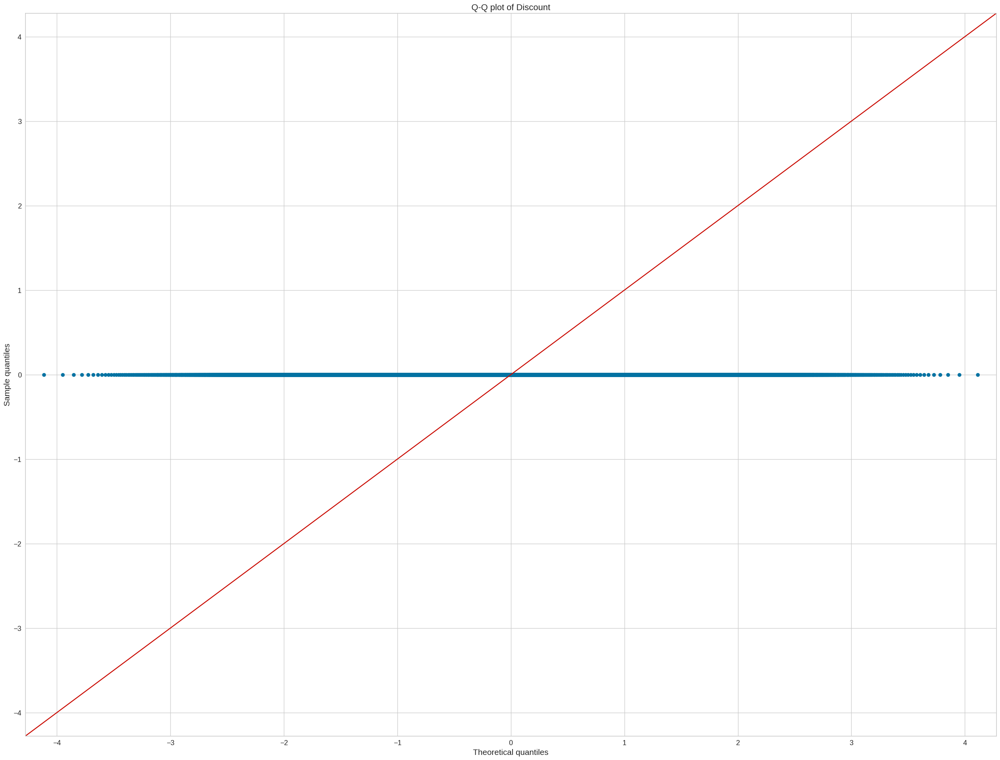

<Figure size 800x500 with 0 Axes>

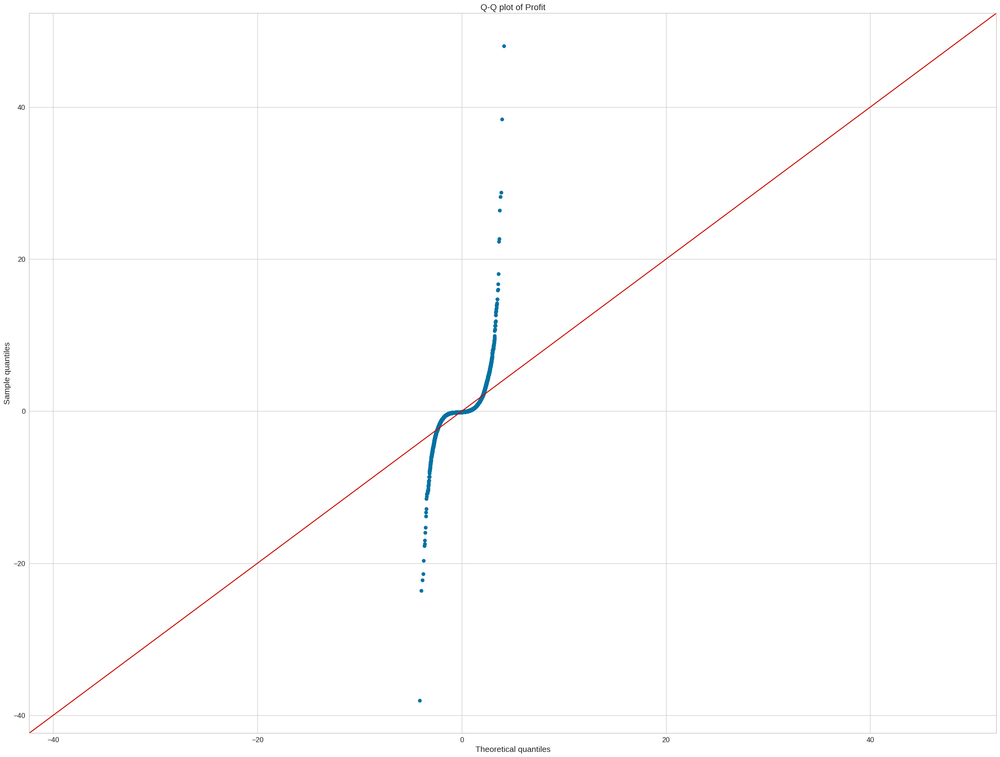

<Figure size 800x500 with 0 Axes>

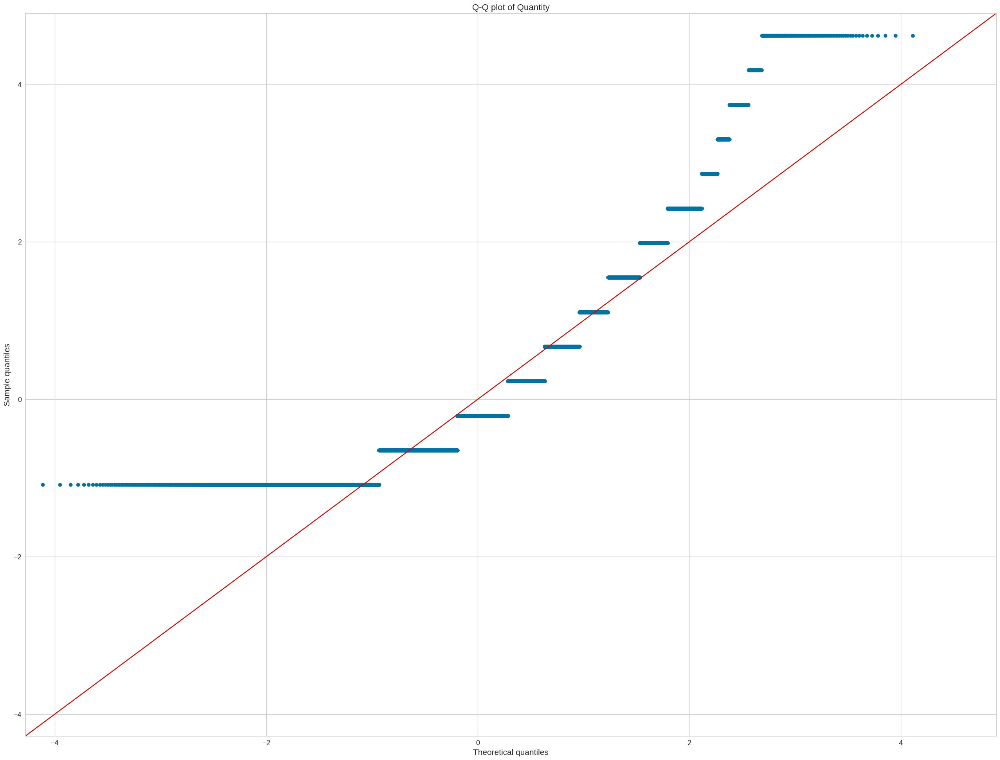

<Figure size 800x500 with 0 Axes>

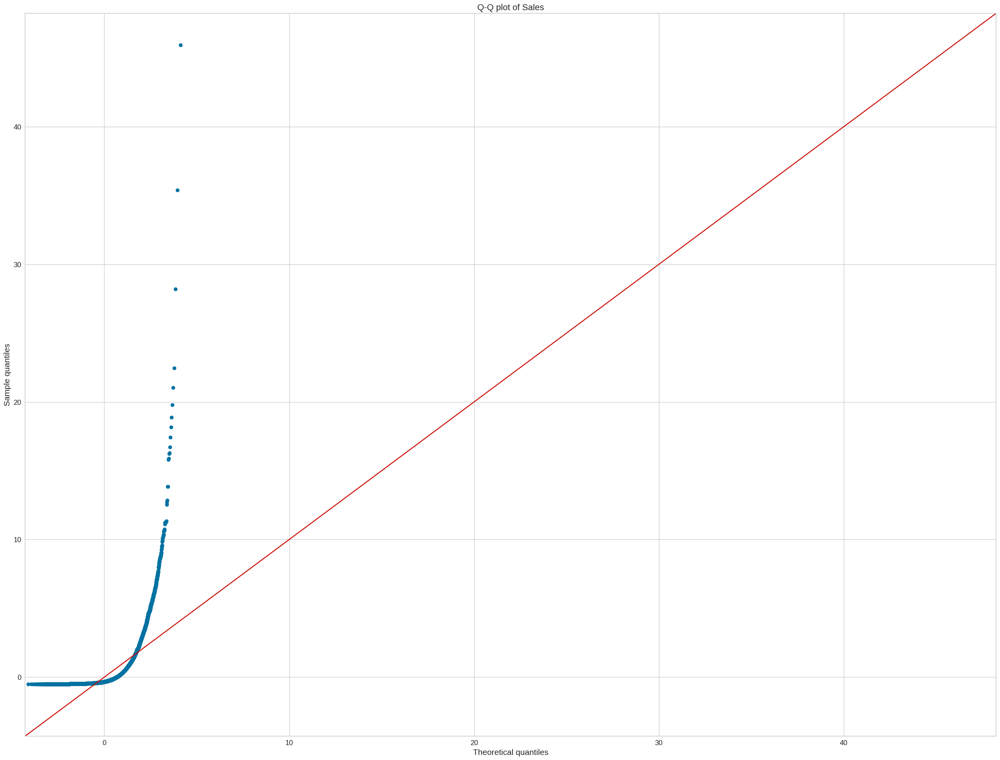

<Figure size 800x500 with 0 Axes>

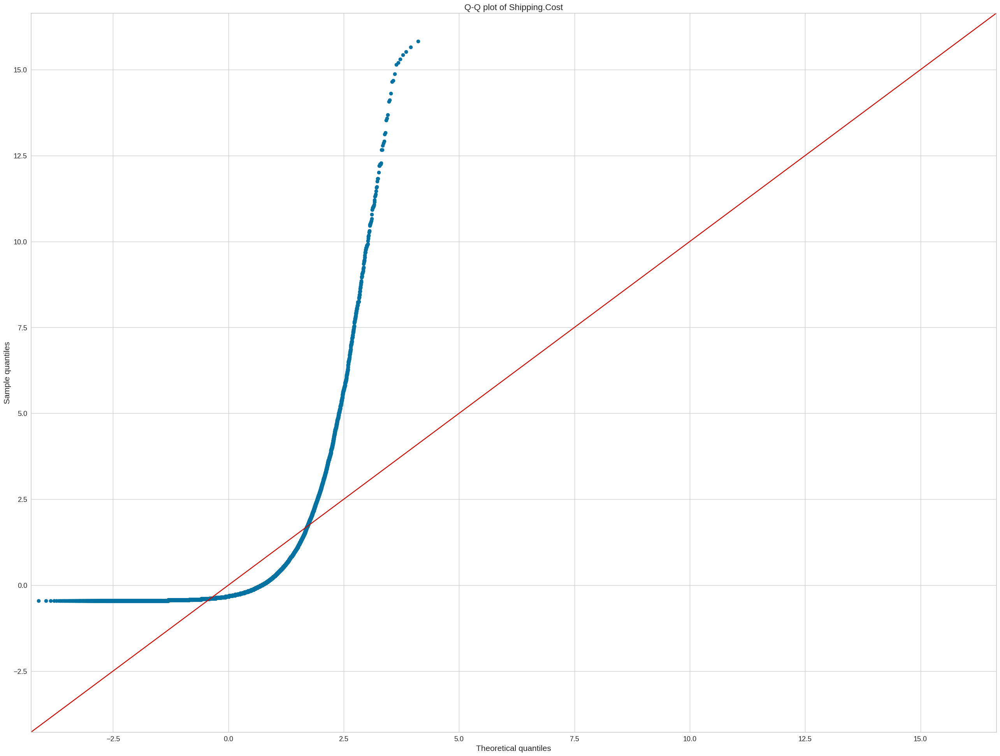

In [73]:
from statsmodels.graphics.gofplots import qqplot
data_norm = data[["Discount", "Profit", "Quantity", "Sales", "Shipping.Cost"]]
for c in data_norm.columns[:]:
  plt.figure(figsize=(8,5))
  fig=qqplot(data_norm[c],line='45',fit='True')
  plt.xticks(fontsize=13)
  plt.yticks(fontsize=13)
  plt.xlabel("Theoretical quantiles",fontsize=15)
  plt.ylabel("Sample quantiles",fontsize=15)
  plt.title("Q-Q plot of {}".format(c),fontsize=16)
  plt.grid(True)
  plt.show()

With the Q-Q plot above, we can conclude that Quantity, Discount follows normal distribution as they fall close to the line.

### Histogram Plot

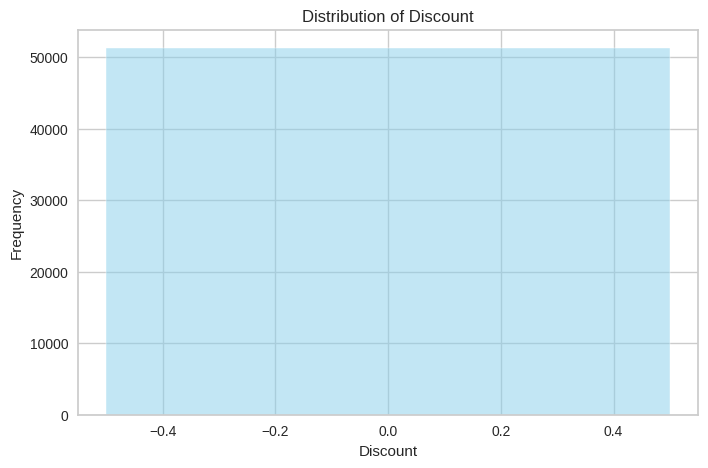

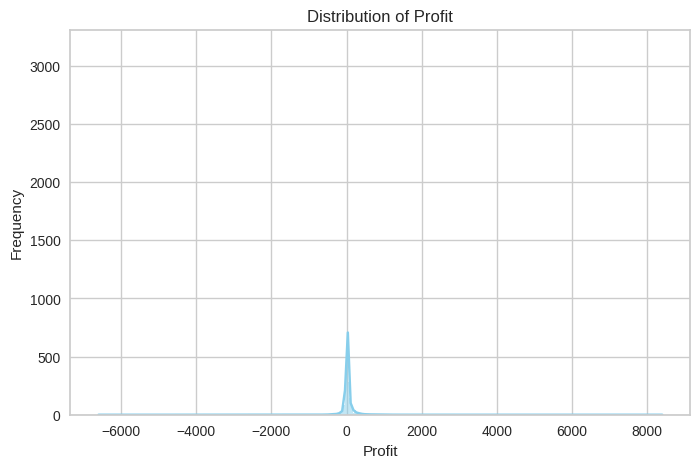

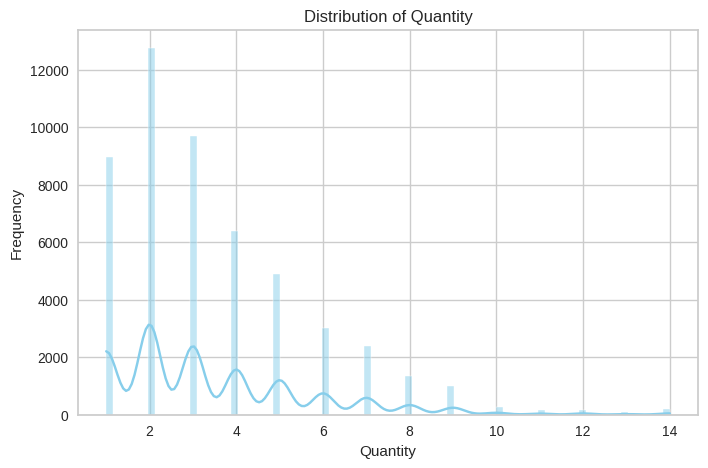

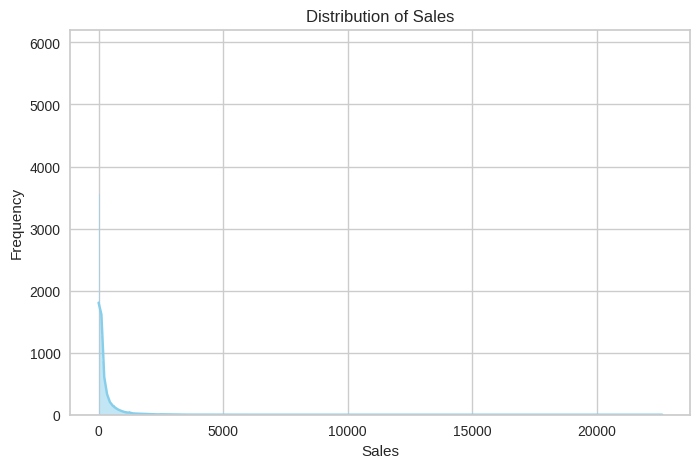

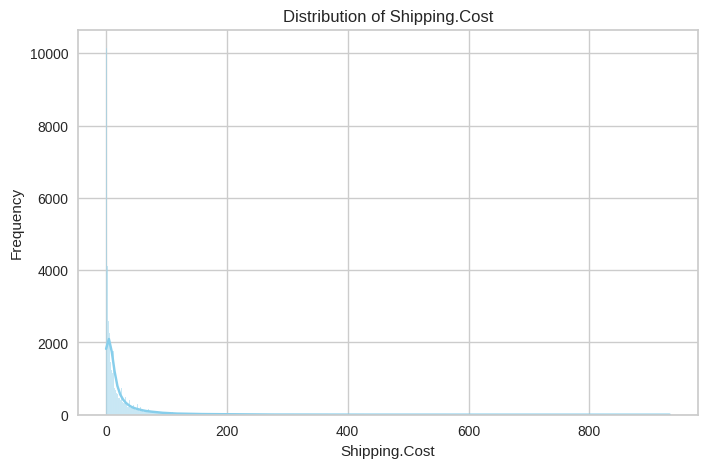

In [74]:
# Select numeric columns
numeric_columns = data[
    ["Discount", "Profit", "Quantity", "Sales", "Shipping.Cost"]
]

# Visualize distributions of numeric variables
for column in numeric_columns:
    plt.figure(figsize=(8, 5))
    sns.histplot(data[column], kde=True, color='skyblue')
    plt.title(f'Distribution of {column}')
    plt.xlabel(column)
    plt.ylabel('Frequency')
    plt.show()

With the above histograms plotted, we can conclude that 'Profit' is normally distributed. 'Sales' and 'Shipping.Cost' are right skewed distribution. 'Quantity' is multi-modal distribution.

## Question-4: Which independent variables are useful to predict a target (dependent variable)? (Use at least three methods)

### ***Method 1: Correlation Analysis***

 Correlation analysis is used for feature selection by identifying independent variables that have a significant correlation with the target variable. Variables with higher correlation coefficients are more likely to be important predictors of the target variable and can be selected for inclusion in the predictive model.

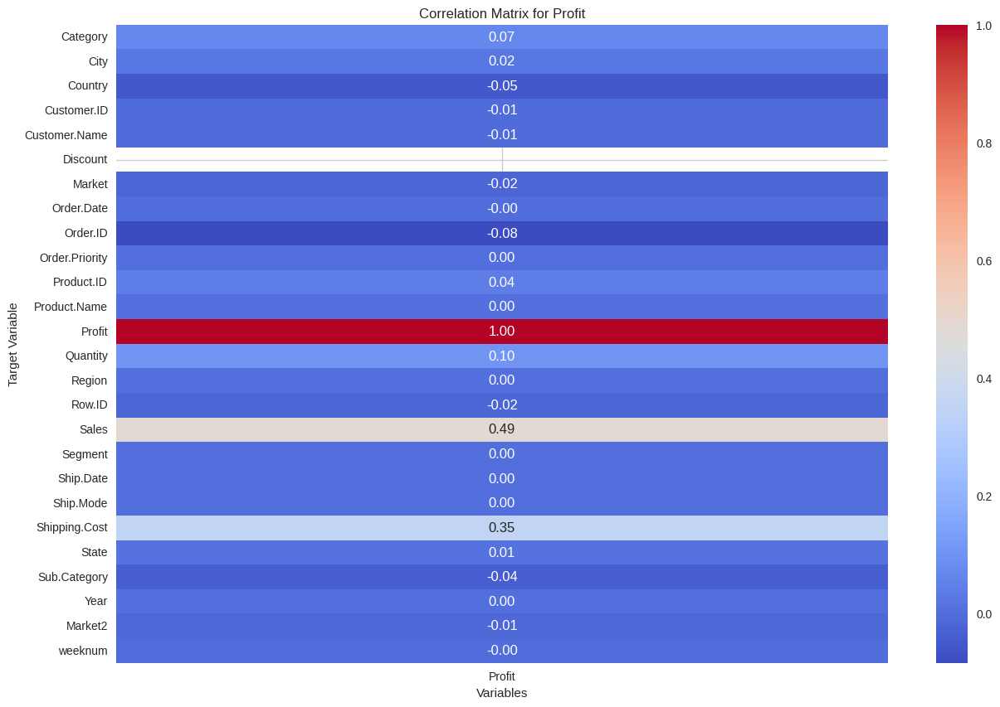

In [35]:
# Method 1: Correlation Analysis
target_var = "Profit"

# Calculate correlation matrix
correlation_matrix = data.corr()

# Filter correlation matrix for the target variable
target_correlation = correlation_matrix[target_var]

# Plot correlation matrix
plt.figure(figsize=(15, 10))
sns.heatmap(target_correlation.to_frame(), annot=True, cmap='coolwarm', fmt=".2f")
plt.title(f"Correlation Matrix for {target_var}")
plt.xlabel("Variables")
plt.ylabel("Target Variable")
plt.show()

With the above correlation analysis performed, we can conclude that 'Sales'(0.49), 'Shipping.Cost' (0.35), 'Quantity' (0.10), 'Category' (0.07) has a significant correlation with the target variable 'Profit'.

#### HeatMap of Correlation Matrix

<Axes: >

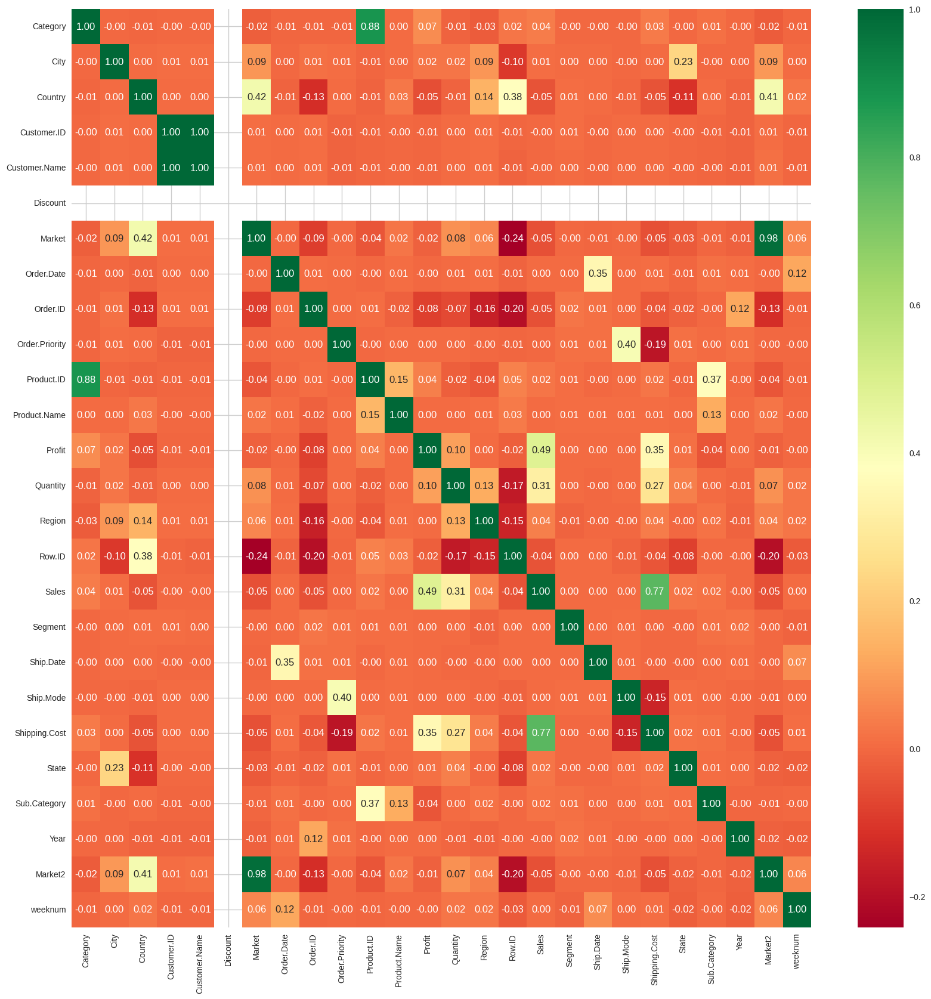

In [36]:
# heatmap of the same correlation matrix.
plt.figure(figsize=(20,20))
sns.heatmap(data.corr(), annot=True, cmap="RdYlGn", fmt=".2f")

With the heatmap, [Sales, Shipping.Cost, Quantity, Category] has a significant contribution in predicting the target variable 'Profit'.

### ***Method 2: Random Forest Regressor Feature Importance***

It provides a straightforward way to measure the importance of each feature in predicting the target variable. By analyzing the feature importances computed by Random Forest, we can identify the most influential independent variables that contribute significantly to the predictive performance of the model.

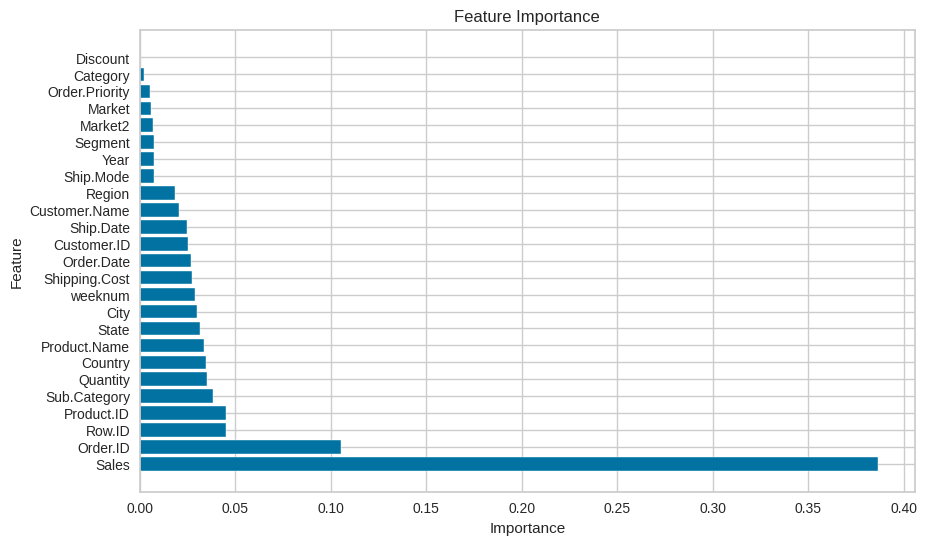

In [75]:
X = data.drop(columns=['Profit'])
y = data['Profit']

# Create Random Forest Regressor model
rf_regressor = RandomForestRegressor(random_state=0)
# Fit the model to the data
rf_regressor.fit(X, y)

# Get feature importances
feature_importances = rf_regressor.feature_importances_

# Create a DataFrame to store feature importances along with their corresponding feature names
feature_importance_df = pd.DataFrame({'Feature': X.columns, 'Importance': feature_importances})
# Sort the DataFrame by importance values in descending order
feature_importance_df = feature_importance_df.sort_values(by='Importance', ascending=False)

# Visualize feature importances
plt.figure(figsize=(10, 6))
plt.barh(feature_importance_df['Feature'], feature_importance_df['Importance'])
plt.xlabel('Importance')
plt.ylabel('Feature')
plt.title('Feature Importance')
plt.show()

According to the Random Forest Regressor, the most important features in predicting the target variable are Sales, Sub.Category, Quantity. (ID's are not considered as important features as they are unique for every data sample and cannot be used to train the model)

### ***Method 3: Recursive Feature Elimination***

Recursive Feature Elimination (RFE) is a technique used for feature selection, particularly in machine learning tasks. It works by recursively removing the least important features and building models on the remaining features until the specified number of features is reached.

In [51]:
# Initialize a linear regression model
lr_model = LinearRegression()

# Initialize RFE
rfe = RFE(lr_model, n_features_to_select=10)

# Fit RFE
rfe.fit(X, y)

# Get the selected features
selected_features = X.columns[rfe.support_]
print(selected_features)

# Get ranking of features
feature_ranking = pd.Series(rfe.ranking_, index=X.columns).sort_values(ascending=True)
print(feature_ranking)

Index(['Category', 'Market', 'Order.Priority', 'Quantity', 'Sales', 'Segment',
       'Ship.Mode', 'Sub.Category', 'Year', 'Market2'],
      dtype='object')
Category           1
Year               1
Sub.Category       1
Ship.Mode          1
Segment            1
Sales              1
Market2            1
Order.Priority     1
Quantity           1
Market             1
Country            2
Shipping.Cost      3
Region             4
Customer.Name      5
Product.ID         6
State              7
City               8
Customer.ID        9
Order.ID          10
Order.Date        11
Ship.Date         12
weeknum           13
Product.Name      14
Row.ID            15
Discount          16
dtype: int64


With the Recursive Feature Elimination the important features are ['Category', 'Market', 'Order.Priority', 'Quantity', 'Sales', 'Segment',
       'Ship.Mode', 'Sub.Category', 'Year', 'Market2']

## Question-5: Which independent variables have missing data? How much?

The code below stores the null/missing values in *missing_data* list. As there are no missing values the *missing_independent_variables* returns an empty list.

In [76]:
missing_data = data.drop(columns=['Profit']).isnull().sum()

# Filter for independent variables with missing data
missing_independent_variables = missing_data[missing_data > 0]

print("Independent variables with missing data:")
print(missing_independent_variables)

Independent variables with missing data:
Series([], dtype: int64)


There are no independent variables with missing data.

## Question-6: Do the training and test sets have the same data?

In [53]:
same_X_data = X_train.equals(X_test)
same_y_data = y_train.equals(y_test)

if same_X_data or same_y_data:
    print("Training and test sets have the same data")
else:
    print("Training and test sets have different data")

Training and test sets have different data


## Question-7:  In the predictor variables independent of all the other predictor variables?

In [47]:
independence = (correlation_matrix.abs() < 0.1).all().all()

if independence:
    print("The predictor variables are independent of all the other predictor variables.")
else:
    print("The predictor variables are dependent of all the other predictor variables.")

The predictor variables are dependent of all the other predictor variables.


Answer:

We determined whether the relationship between predictor variables is independent or not using correlation matrix. The above independence variable stores the boolean values and returns True if the predictor variables are independent of each other and returns False if they are dependent.

## Question-8: Which predictor variables are the most important?

Answer:

Random Forest Regression is used to determine the feature importance of predictor variables.

In [56]:
# Initialize Random Forest model
rf_model = RandomForestRegressor()

# Fit the model to the data
rf_model.fit(X, y)

# Get feature importances
feature_importances = pd.Series(rf_model.feature_importances_, index=X.columns).sort_values(ascending=False)

# Print the most important predictor variables
print("Most important predictor variables:")
print(feature_importances)

Most important predictor variables:
Sales             0.384230
Order.ID          0.108862
Product.ID        0.046031
Row.ID            0.044916
Sub.Category      0.040835
Country           0.035204
Quantity          0.034552
Product.Name      0.033258
City              0.031584
Shipping.Cost     0.030240
State             0.029200
Ship.Date         0.025015
weeknum           0.024962
Customer.Name     0.023675
Customer.ID       0.023632
Order.Date        0.023486
Region            0.018778
Segment           0.007343
Year              0.006955
Market            0.006588
Ship.Mode         0.006151
Order.Priority    0.005995
Market2           0.005892
Category          0.002616
Discount          0.000000
dtype: float64


The most important predictor variables Sales, Category, Quantity according to the Random Forest Regressor.

## Question-9: Do the ranges of the predictor variables make sense?

In [55]:
data.describe()

,Category,City,Country,Customer.ID,Customer.Name,Discount,Market,Order.Date,Order.ID,Order.Priority,...,Sales,Segment,Ship.Date,Ship.Mode,Shipping.Cost,State,Sub.Category,Year,Market2,weeknum
count,51290.000000,51290.000000,51290.000000,51290.000000,51290.000000,51290.0,51290.000000,51290.000000,51290.000000,51290.000000,...,51290.000000,51290.000000,51290.000000,51290.000000,51290.000000,51290.000000,51290.000000,51290.000000,51290.000000,51290.000000
mean,1.005167,1841.952018,79.073738,2441.409476,398.191870,0.0,3.351063,720.810470,12564.185299,2.118308,...,246.498440,0.665139,743.597660,2.254709,25.883057,561.326204,7.497446,2012.777208,2.684948,31.287112
std,0.624701,1010.420361,46.684209,1407.451550,229.209363,0.0,2.219025,410.007327,7209.601672,1.081088,...,487.567175,0.766199,423.283906,1.083110,57.297507,304.144081,4.844664,1.098931,1.815819,14.429795
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,2011.000000,0.000000,1.000000
25%,1.000000,935.000000,44.000000,1234.000000,199.000000,0.0,1.000000,367.000000,6410.250000,1.000000,...,31.000000,0.000000,378.000000,2.000000,2.000000,311.000000,3.000000,2012.000000,1.000000,20.000000
50%,1.000000,1917.000000,81.000000,2440.000000,399.000000,0.0,4.000000,725.000000,12524.500000,3.000000,...,85.000000,0.000000,751.000000,3.000000,7.000000,572.000000,7.000000,2013.000000,3.000000,33.000000
75%,1.000000,2717.000000,134.000000,3662.000000,597.000000,0.0,5.000000,1076.000000,18815.000000,3.000000,...,251.000000,1.000000,1106.000000,3.000000,24.000000,820.000000,12.000000,2014.000000,4.000000,44.000000
max,2.000000,3635.000000,146.000000,4872.000000,794.000000,0.0,6.000000,1429.000000,25034.000000,3.000000,...,22638.000000,2.000000,1463.000000,3.000000,933.000000,1093.000000,16.000000,2014.000000,5.000000,53.000000


Mean values stand between min and max for all independent variables. Thus, the range of predictor variables makes sense

## Question-10: What are the distributions of the predictor variables?   

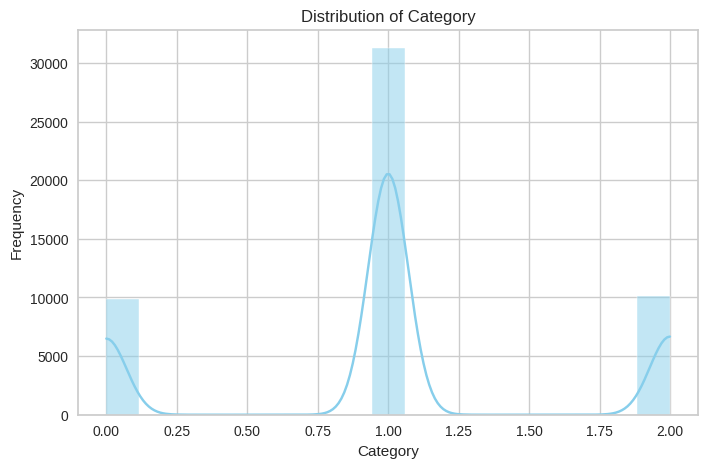

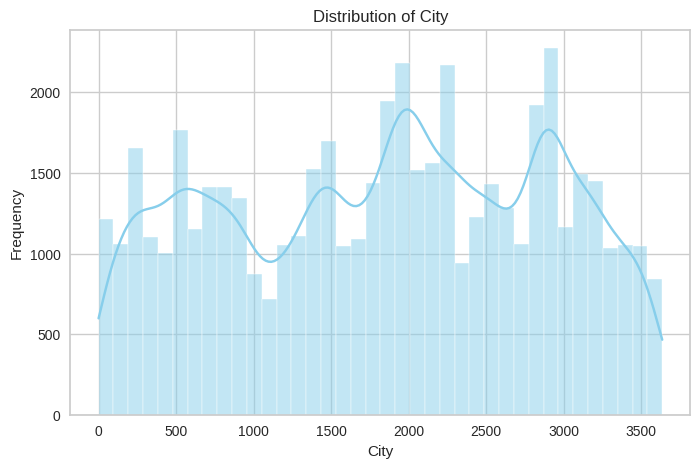

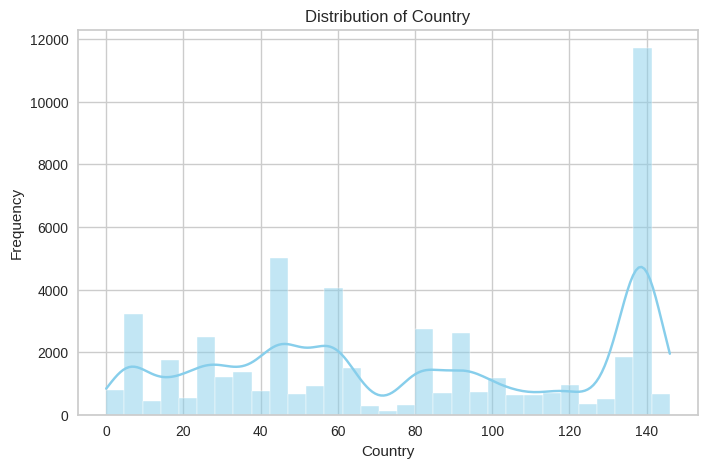

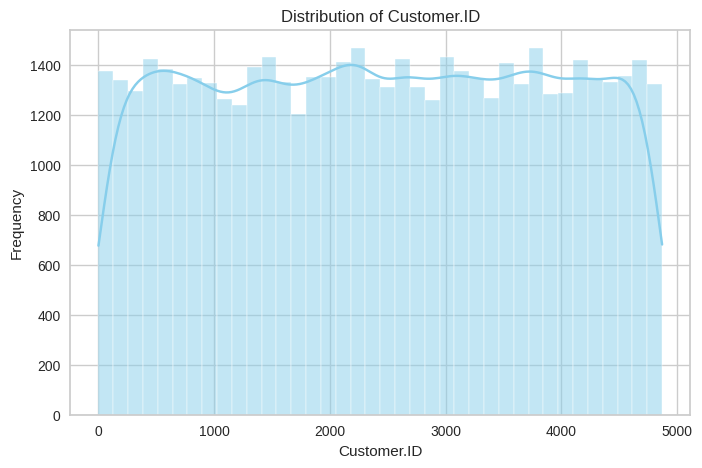

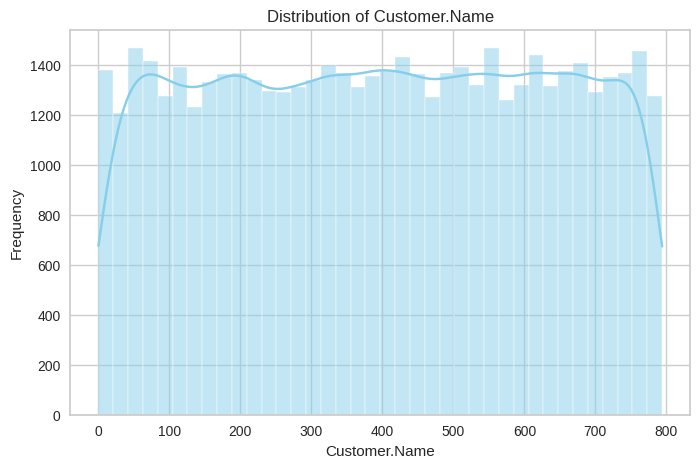

...

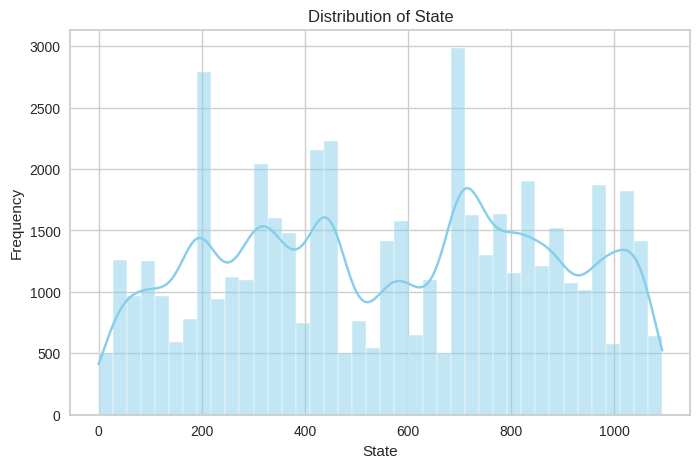

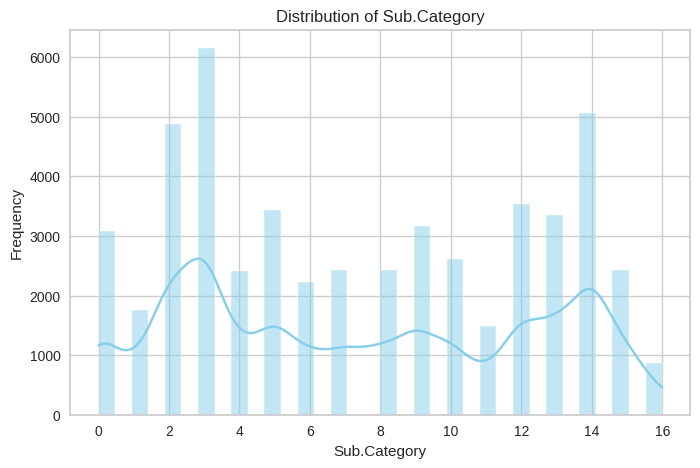

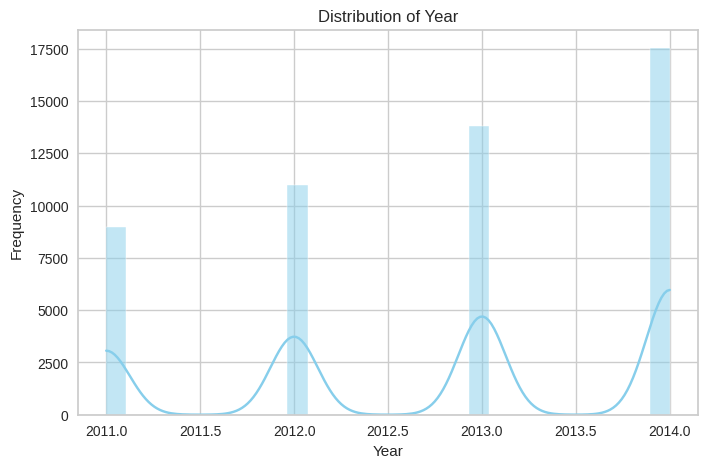

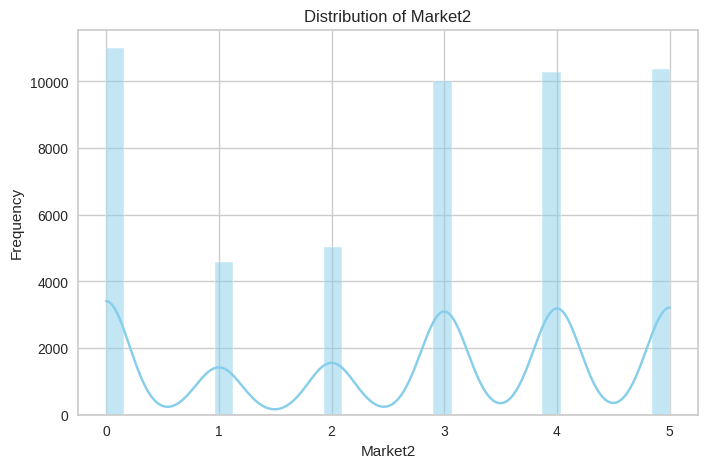

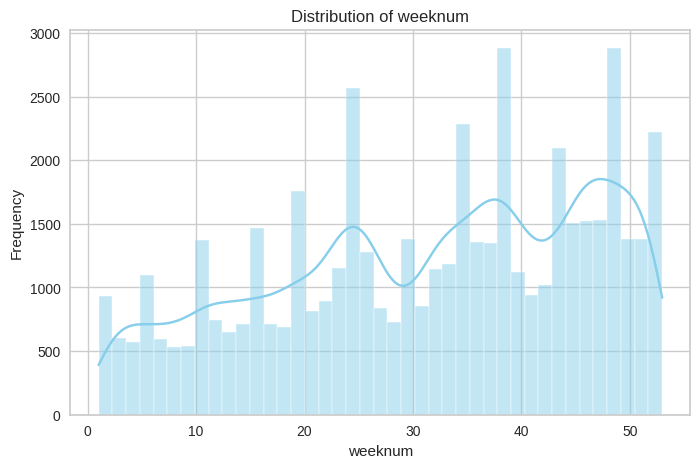

In [61]:
# Plot histograms for each predictor variable
for column in X.columns:
    plt.figure(figsize=(8, 5))
    sns.histplot(data[column], kde=True, color='skyblue')
    plt.title(f'Distribution of {column}')
    plt.xlabel(column)
    plt.ylabel('Frequency')
    plt.show()

From the above histogram plots, we can conclude that few predictors like Sales, Shipping.Cost are right skewed, few like Category are normally distributed.

## Question-11: Remove outliers and keep outliers (does if have an effect of the final predictive model)?

In [77]:
# Select target variable and independent variables
target_variable = 'Profit'
independent_variables = ['Sales', 'Shipping.Cost', 'Quantity', 'Category']

# Method 1: Train the model with original data (including outliers)
model_original = LinearRegression()
model_original.fit(X_train, y_train)
y_pred_original = model_original.predict(X_test)
mse_original = mean_squared_error(y_test, y_pred_original)

# Method 2: Remove outliers and train the model
# Define a function to remove outliers using modified Z-score method
def remove_outliers(df, cols, threshold=3):
    z_scores = stats.zscore(df[cols])
    df_outliers_removed = df[(z_scores < threshold).all(axis=1)]
    return df_outliers_removed

# Remove outliers from the independent variables
data_no_outliers = remove_outliers(data, independent_variables)

# Split the data into training and test sets
X_no_outliers = data_no_outliers[independent_variables]
y_no_outliers = data_no_outliers[target_variable]
X_train_no_outliers, X_test_no_outliers, y_train_no_outliers, y_test_no_outliers = train_test_split(X_no_outliers, y_no_outliers, test_size=0.2, random_state=42)

# Train the model without outliers
model_no_outliers = LinearRegression()
model_no_outliers.fit(X_train_no_outliers, y_train_no_outliers)
y_pred_no_outliers = model_no_outliers.predict(X_test_no_outliers)
mse_no_outliers = mean_squared_error(y_test_no_outliers, y_pred_no_outliers)

# Compare the performance of both models
print("Mean Squared Error (MSE) with original data (including outliers):", mse_original)
print("Mean Squared Error (MSE) after removing outliers:", mse_no_outliers)


Mean Squared Error (MSE) with original data (including outliers): 29445.13274512624
Mean Squared Error (MSE) after removing outliers: 9423.804485664048


Yes, Removing outliers has an effect on the final predictive model as the mean squared error is reduced significantly.

## Question-12: Remove 1%, 5%, and 10% of your data randomly and impute the values back using at least 3 imputation methods. How well did the methods recover the missing values?  That is remove some data, check the % error on residuals for numeric data and check for bias and variance of the error.

In [78]:
# Select numeric columns for imputation
numeric_columns = data.columns

# Define function to remove random percentage of data
def remove_random_data(df, percentage):
    random_indices = np.random.choice(df.index, size=int(len(df) * percentage), replace=False)
    df_removed = df.copy()
    df_removed.loc[random_indices, numeric_columns] = np.nan
    return df_removed

# Define function for imputation using mean
def impute_mean(df):
    return df.fillna(df.mean())

# Define function for imputation using median
def impute_median(df):
    return df.fillna(df.median())

# Define function for imputation using most frequent
def impute_most_frequent(df):
    imputer = SimpleImputer(strategy='most_frequent', missing_values=np.nan)
    return pd.DataFrame(imputer.fit_transform(df), columns=df.columns)

# Define function to evaluate imputation methods
def evaluate_imputation(df_original, df_imputed):
    residuals = df_original[numeric_columns] - df_imputed[numeric_columns]
    mean_residuals = residuals.mean()
    bias = mean_residuals.mean()
    variance = mean_residuals.var()
    return bias, variance

def calculate_percent_error(data_original, data_imputed):
    residuals = data_original - data_imputed
    epsilon = 0.0000001  # Add a small epsilon value to avoid division by zero
    percent_error = ((residuals.abs() + epsilon) / (data_original + epsilon)) * 100
    return percent_error.mean()

# Remove 1%, 5%, and 10% of data randomly and impute values using three different methods
percentages = [0.01, 0.05, 0.1]
imputation_methods = [impute_mean, impute_median, impute_most_frequent]

for percentage in percentages:
    for imputation_method in imputation_methods:
        # Remove random percentage of data
        data_removed = remove_random_data(data, percentage)

        # Impute missing values using the selected method
        data_imputed = imputation_method(data_removed)

        # Calculate percent error on residuals
        percent_error = calculate_percent_error(data[numeric_columns], data_imputed)
        print(f"Imputation Method: {imputation_method.__name__}, Removed Percentage: {percentage * 100}%")
        print(f"Percent Error: {percent_error.to_string()}%")

        # Evaluate imputation method
        bias, variance = evaluate_imputation(data[numeric_columns], data_imputed[numeric_columns])
        print(f"Randomly removed {percentage * 100}% of data and imputed using {imputation_method.__name__}:")
        print(f"Bias: {bias}")
        print(f"Variance: {variance}")
        print()


Imputation Method: impute_mean, Removed Percentage: 1.0%
Percent Error: Category          2.058370e+06
City              4.153709e+00
Country           1.541805e+06
Customer.ID       4.758464e+07
Customer.Name     7.761033e+06
Discount          1.000000e+02
Market            7.775951e+06
Order.Date        2.056908e+00
Order.ID          3.287516e+00
Order.Priority    1.363087e+06
Product.ID        3.087518e+00
Product.Name      2.163427e+00
Profit            1.161350e+07
Quantity          7.474985e-01
Region            5.427910e+06
Row.ID            2.804821e+00
Sales             7.067081e+00
Segment           3.280479e+06
Ship.Date         2.224433e+00
Ship.Mode         3.164566e+06
Shipping.Cost     2.622927e+07
State             1.800002e+00
Sub.Category      4.677230e+06
Year              4.855097e-04
Market2           6.230196e+06
weeknum           1.011394e+00%
Randomly removed 1.0% of data and imputed using impute_mean:
Bias: -0.15713304216884502
Variance: 0.5055201898643217

Imp


*   When 1.0% of the data is removed and imputed back, the best imputation method is Impute Mean as it has low bias and variance compared to Impute Median and Impute Mode imputation methods.
*   When 5.0% of the data is randomly removed, Impute Median performs slightly better than Impute Mean in terms of bias and variance.
*   When 10.0% of the data is randomly removed, Impute Mean performs the best in terms of bias and variance, followed by Impute Median.





## Accuracy and Confusion Matrix

Answer:

The Random Forest Classifier is used to train data and achieved accuracy for the model is 99.9%

In [89]:
raw_data = pd.read_csv(url)
raw_data.head()

,Category,City,Country,Customer.ID,Customer.Name,Discount,Market,Order.Date,Order.ID,Order.Priority,...,Sales,Segment,Ship.Date,Ship.Mode,Shipping.Cost,State,Sub.Category,Year,Market2,weeknum
0,Office Supplies,Los Angeles,United States,LS-172304,Lycoris Saunders,0.0,US,07-01-2011 00:00,CA-2011-130813,High,...,19,Consumer,09-01-2011 00:00,Second Class,4.37,California,Paper,2011,North America,2
1,Office Supplies,Los Angeles,United States,MV-174854,Mark Van Huff,0.0,US,21-01-2011 00:00,CA-2011-148614,Medium,...,19,Consumer,26-01-2011 00:00,Standard Class,0.94,California,Paper,2011,North America,4
2,Office Supplies,Los Angeles,United States,CS-121304,Chad Sievert,0.0,US,05-08-2011 00:00,CA-2011-118962,Medium,...,21,Consumer,09-08-2011 00:00,Standard Class,1.81,California,Paper,2011,North America,32
3,Office Supplies,Los Angeles,United States,CS-121304,Chad Sievert,0.0,US,05-08-2011 00:00,CA-2011-118962,Medium,...,111,Consumer,09-08-2011 00:00,Standard Class,4.59,California,Paper,2011,North America,32
4,Office Supplies,Los Angeles,United States,AP-109154,Arthur Prichep,0.0,US,29-09-2011 00:00,CA-2011-146969,High,...,6,Consumer,03-10-2011 00:00,Standard Class,1.32,California,Paper,2011,North America,40


In [90]:

# Define the target variable and independent variables
target_variable = 'Profit'
independent_variables = raw_data.select_dtypes(include=['object', 'category']).columns.tolist()

# Discretize the target variable into categories
data['Profit_Category'] = pd.cut(data[target_variable], bins=3, labels=['Low', 'Medium', 'High'])

# Split the data into train and test sets
X = data[independent_variables]
y = data['Profit_Category']
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Initialize and train a Random Forest Classifier
classifier = RandomForestClassifier(random_state=42)
classifier.fit(X_train, y_train)

# Predict the target variable on the test set
y_pred = classifier.predict(X_test)

# Calculate accuracy
accuracy = accuracy_score(y_test, y_pred)
print("Accuracy:", accuracy)

# Create a confusion matrix
conf_matrix = confusion_matrix(y_test, y_pred)
print("Confusion Matrix:")
print(conf_matrix)


Accuracy: 0.9992201208812634
Confusion Matrix:
[[    0     0     1]
 [    0     0     7]
 [    0     0 10250]]


The accuracy is very high and the confusion matrix has class imabalance issue as it predicts the values for all the instances in the 3rd class but not for first and second classes.

# **AutoML**

* Automated machine learning, also known as AutoML, is the process of automating the end-to-end process of building machine learning models. This includes tasks such as data preprocessing, feature engineering, model selection, and hyperparameter tuning for a given dataset. AutoML systems use a combination of optimization algorithms, statistical methods, and machine learning techniques to automatically search for the best model, tuning the model's parameters and selecting the best features to use.

* H2O is one such open-source AutoML framework developed by H2O.ai. It provides a suite of machine learning algorithms and tools that enable users to build and deploy scalable machine learning models.

* H2O's AutoML functionality automates the process of training and tuning a large number of models, allowing users to find the best-performing model for their dataset with minimal effort. It automatically performs feature engineering, model selection, hyperparameter optimization, and model evaluation, providing users with insights into the performance of different models and enabling them to deploy the best model for their use case.

H2O AutoML is initialized to run with the mininum memory size possible. If the H2O initialization is failed, then it will be logged as Critical Error in the log file


In [94]:
min_mem_size=6
run_time=222

In [95]:
pct_memory=0.5
virtual_memory=psutil.virtual_memory()
min_mem_size=int(round(int(pct_memory*virtual_memory.available)/1073741824,0))
print(min_mem_size)

2


In [96]:
port_no = random.randint(5555, 55555)

try:
    h2o.init(strict_version_check=False, min_mem_size_GB=min_mem_size, port=port_no)
except:
    logging.critical('h2o.init')
    h2o.download_all_logs(dirname=logs_path, filename=logfile)
    h2o.cluster().shutdown()
    sys.exit(2)

Checking whether there is an H2O instance running at http://localhost:55011..... not found.
Attempting to start a local H2O server...
  Java Version: openjdk version "11.0.22" 2024-01-16; OpenJDK Runtime Environment (build 11.0.22+7-post-Ubuntu-0ubuntu222.04.1); OpenJDK 64-Bit Server VM (build 11.0.22+7-post-Ubuntu-0ubuntu222.04.1, mixed mode, sharing)
  Starting server from /usr/local/lib/python3.10/dist-packages/h2o/backend/bin/h2o.jar
  Ice root: /tmp/tmp14nx6vq5
  JVM stdout: /tmp/tmp14nx6vq5/h2o_unknownUser_started_from_python.out
  JVM stderr: /tmp/tmp14nx6vq5/h2o_unknownUser_started_from_python.err
  Server is running at http://127.0.0.1:55011
Connecting to H2O server at http://127.0.0.1:55011 ... successful.


H2O_cluster_uptime:,03 secs
H2O_cluster_timezone:,Etc/UTC
H2O_data_parsing_timezone:,UTC
H2O_cluster_version:,3.46.0.1
H2O_cluster_version_age:,20 days
H2O_cluster_name:,H2O_from_python_unknownUser_m6pmt6
H2O_cluster_total_nodes:,1
H2O_cluster_free_memory:,3.170 Gb
H2O_cluster_total_cores:,2
H2O_cluster_allowed_cores:,2
H2O_cluster_status:,"locked, healthy"



H2O dataframe is created inorder to perform H2O model training. An instance of H2O AutoML is created, the data has been divided into training and testing (80:20)


In [97]:
# Loading Encoded data
df = h2o.import_file(path = encoded_url)

Parse progress: |████████████████████████████████████████████████████████████████| (done) 100%


In [98]:
pct_rows = 0.80
df_train, df_test = df.split_frame([pct_rows])

In [99]:
print(df_train.shape)
print(df_test.shape)

(41079, 26)
(10211, 26)


In [100]:
X = df.columns
y = 'Profit'
X.remove(y)

## H2O AutoML Execution

Run AutoML. The max_runtime_secs argument provides a way to limit the AutoML run by time.

In [129]:
# Set up AutoML
aml = H2OAutoML(max_runtime_secs=run_time, seed=1)
# Pass the data through H2oAutoML
aml.train(X, y, df_train)

AutoML progress: |
01:20:56.764: _train param, Dropping bad and constant columns: [Discount]

███
01:21:06.458: _train param, Dropping bad and constant columns: [Discount]
01:21:06.830: _train param, Dropping bad and constant columns: [Discount]

██
01:21:12.526: _train param, Dropping unused columns: [Discount]


01:21:13.550: _train param, Dropping bad and constant columns: [Discount]

██
01:21:18.344: _train param, Dropping bad and constant columns: [Discount]

█████
01:21:38.367: _train param, Dropping bad and constant columns: [Discount]

██
01:21:43.528: _train param, Dropping bad and constant columns: [Discount]

█
01:21:46.514: _train param, Dropping bad and constant columns: [Discount]


01:21:49.718: _train param, Dropping unused columns: [Discount]

█
01:21:51.265: _train param, Dropping unused columns: [Discount]


01:21:52.636: _train param, Dropping bad and constant columns: [Discount]

█
01:21:54.483: _train param, Dropping bad and constant columns: [Discount]

██████
01

key,value
Stacking strategy,blending
Number of base models (used / total),3/6
# GBM base models (used / total),1/1
# XGBoost base models (used / total),1/1
# DRF base models (used / total),1/2
# DeepLearning base models (used / total),0/1
# GLM base models (used / total),0/1
Metalearner algorithm,GLM
Metalearner fold assignment scheme,AUTO
Metalearner nfolds,0


Here is the breakdown of parameters:

* max_models: This parameter tells H2OAutoML to train a maximum of 15 different models. The AutoML process will stop after the fifteenth model has been trained
* seed: This sets the random seed for reproducibility. Using a seed ensures that the model training process is deterministic, meaning you'll get the same results each time you run the code with the same dataset and parameters
* verbosity: This sets the verbosity level of the training process. A value of "debug" will output more detailed progress and diagnostic messages that can help in understanding the internal process or for debugging
* nfolds: This specifies the number of folds for cross-validation. Setting it to 0 means that cross-validation is not used. Instead, the validation set will be used for model evaluation. If nfolds is set to a number greater than 1, H2OAutoML will use that number of folds for cross-validation to evaluate model performance



X indicates predictor variables,

y indicates target variable,

The autoML model is being trained with the training data df_train given 3 values (X, y, df_train). The model's performance is being tested on the test dataset df_test. Firstly, the test dataset is converted into H2O dataframe and then the H2O AutoML model's performance is tested on the dataframe. The metrics such as MAE, MSE, RMSE, RMSLE are displayed above.



Interpreting the above metrics

* MAE: The mean absolute error (MAE) is the average absolute difference between the target values and the predicted values. This metric ranges from zero to infinity; a lower value indicates a higher quality model.

* RMSE: The root-mean-square error metric is a frequently used measure of the differences between the values predicted by a model or an estimator and the values observed. This metric ranges from zero to infinity; a lower value indicates a higher quality model.

* RMSLE: The root-mean-squared logarithmic error metric is similar to RMSE, except that it uses the natural logarithm of the predicted and actual values plus 1. RMSLE penalizes under-prediction more heavily than over-prediction. It can also be a good metric when you don't want to penalize differences for large prediction values more heavily than for small prediction values. This metric ranges from zero to infinity; a lower value indicates a higher quality model. The RMSLE evaluation metric is returned only if all label and predicted values are non-negative.

* r^2: r squared (r^2) is the square of the Pearson correlation coefficient between the labels and predicted values. This metric ranges between zero and one; a higher value indicates a higher quality model.

* MAPE: Mean absolute percentage error (MAPE) is the average absolute percentage difference between the labels and the predicted values. This metric ranges between zero and infinity; a lower value indicates a higher quality model.

* K-fold cross-validation is used to validate a model internally, i.e., estimate the model performance without having to sacrifice a validation split.

Next, we will view the AutoML Leaderboard. Since we specified a leaderboard_frame in the h2o.automl() function for scoring and ranking the models, the AutoML leaderboard uses the performance on this data to rank the models.

A default performance metric for each machine learning task (binary classification, multiclass classification, regression) is specified internally and the leaderboard will be sorted by that metric. In the case of regression, the default ranking metric is mean residual deviance.

Conclusion - The errors on training data are comparitively less than the errors on testing data as the model has been trained on the training data.

In [102]:
print(aml.leaderboard)

model_id                                           rmse      mse      mae    rmsle    mean_residual_deviance
GBM_4_AutoML_1_20240403_04855                   126.021  15881.2  43.7193      nan                   15881.2
GBM_3_AutoML_1_20240403_04855                   126.124  15907.3  44.8361      nan                   15907.3
XGBoost_grid_1_AutoML_1_20240403_04855_model_2  127.175  16173.6  42.9273      nan                   16173.6
DRF_1_AutoML_1_20240403_04855                   127.981  16379.2  43.1161      nan                   16379.2
XRT_1_AutoML_1_20240403_04855                   129.272  16711.2  43.3562      nan                   16711.2
GBM_2_AutoML_1_20240403_04855                   129.587  16792.9  45.761       nan                   16792.9
GBM_1_AutoML_1_20240403_04855                   131.569  17310.5  44.3644      nan                   17310.5
GBM_5_AutoML_1_20240403_04855                   131.752  17358.7  45.9336      nan                   17358.7
GBM_grid_1_AutoML_1

In [73]:
best_model = aml.get_best_model()
print(best_model)

Model Details
H2OGradientBoostingEstimator : Gradient Boosting Machine
Model Key: GBM_1_AutoML_3_20240403_03429


Model Summary: 
    number_of_trees    number_of_internal_trees    model_size_in_bytes    min_depth    max_depth    mean_depth    min_leaves    max_leaves    mean_leaves
--  -----------------  --------------------------  ---------------------  -----------  -----------  ------------  ------------  ------------  -------------
    70                 70                          113427                 15           15           15            24            223           123.543

ModelMetricsRegression: gbm
** Reported on train data. **

MSE: 15741.27793047071
RMSE: 125.46424961107729
MAE: 38.17706090563119
RMSLE: NaN
Mean Residual Deviance: 15741.27793047071

ModelMetricsRegression: gbm
** Reported on validation data. **

MSE: 15128.093195278258
RMSE: 122.99631374670648
MAE: 44.30109543473528
RMSLE: NaN
Mean Residual Deviance: 15128.093195278258

Scoring History: 
    timestamp   

The best model according to the H2O AutoML is Gradient Boosting Machine and the performance metrics on training data and testing data are listed above.

In [103]:
df_pd = pd.read_csv(encoded_url)

## Analysing relation between variables

* MultiCollinearity: Multicollinearity refers to the situation in which two or more predictor variables in a regression model are highly correlated with each other. It occurs when there are linear relationships among the independent variables. This can cause issues in regression analysis because it makes it difficult to determine the individual effect of each predictor variable on the dependent variable.

* VIF: VIF stands for "Variance Inflation Factor", which is a statistical measure used to detect multicollinearity in a regression analysis. VIF values range from 1 (indicating no multicollinearity) to infinity (indicating perfect multicollinearity). Generally, a value greater than 5 or 10 means that the independent variable is highly correlated with some other variable and should be dropped from the features list.

* OLS Regression Model: Ordinary Least Square regression is type of anaylsis where it identifies the relation between one or two independent variable and a dependent variable by minimizing the squared difference between actual and predictor variable. For any predictor var, p_value < 0.05 means that the predictor has significant impact in predicting the target variable.

In [104]:
df_pd.columns

Index(['Category', 'City', 'Country', 'Customer.ID', 'Customer.Name',
       'Discount', 'Market', 'Order.Date', 'Order.ID', 'Order.Priority',
       'Product.ID', 'Product.Name', 'Profit', 'Quantity', 'Region', 'Row.ID',
       'Sales', 'Segment', 'Ship.Date', 'Ship.Mode', 'Shipping.Cost', 'State',
       'Sub.Category', 'Year', 'Market2', 'weeknum'],
      dtype='object')

Dropping columns which has the ID's as they have no significant impact when training the model because it has unique values for all data samples.

'Customer.ID', 'Order.ID', 'Product.ID', 'Row.ID' are the unique identifiers and adds no value to train the model.

In [105]:
df_pd =  df_pd.drop(['Customer.ID', 'Order.ID', 'Product.ID', 'Row.ID'], axis = 1)

### Variance Inflation Factor

VIF stands for Variance Inflation Factor.It signifies multicollinearity among set of different independent variable. A value greater than 10 means that the independent variable is highly correlated with some other variable. Will calculate VIF value for all variables to check the dependency and then will drop the variables with high VIF value.

In [77]:
# Indicate which variables to compute VIF
num_cols = df_pd.select_dtypes(include=[np.number])
#Compute VIF
vif = pd.DataFrame()
vif["Variables"] = num_cols.columns
vif["VIF"] = [variance_inflation_factor(num_cols.values, i) for i in range(num_cols.shape[1])]
vif

,Variables,VIF
0,Category,3.612217
1,City,4.653650
2,Country,4.878835
3,Customer.Name,4.020699
4,Discount,NaN
5,Market,90.467695
6,Order.Date,4.708757
7,Order.Priority,6.104838
8,Product.Name,4.033105
9,Profit,1.361129


VIF for 'Discount', 'Market', 'Year' and 'Market2' is greater than 10. 'Market' and 'Market2' specify the same thing. Dropping the columns = [ 'Discount', 'Market', 'Year']



In [106]:
df_pd.columns = df_pd.columns.str.replace('.', '_')

In [107]:
df_pd.columns

Index(['Category', 'City', 'Country', 'Customer_Name', 'Discount', 'Market',
       'Order_Date', 'Order_Priority', 'Product_Name', 'Profit', 'Quantity',
       'Region', 'Sales', 'Segment', 'Ship_Date', 'Ship_Mode', 'Shipping_Cost',
       'State', 'Sub_Category', 'Year', 'Market2', 'weeknum'],
      dtype='object')

### Ordinary Least Squares

Ordinary least squares (OLS) regression is a statistical method of analysis used for multivariate model that estimates the relationship between one or more independent variables and a dependent variable; the method estimates the relationship by minimizing the sum of the squares in the difference between the observed and predicted values of the dependent variable. Independent variable with the p_value < 0.05 contributes more in the model to predict the target variable.

In [80]:
import statsmodels.formula.api as smf
# Assuming dfpd is the correct DataFrame and all columns are appropriately named
results = smf.ols('Profit ~ Category + City + Country + Customer_Name + Order_Date + Order_Priority + Product_Name + Quantity + Region + Sales + Segment + Ship_Date + Ship_Mode + Shipping_Cost + State + Sub_Category + Market2 + weeknum', data=df_pd).fit()
results_summary = results.summary()
print(results_summary)

                            OLS Regression Results                            
Dep. Variable:                 Profit   R-squared:                       0.246
Model:                            OLS   Adj. R-squared:                  0.245
Method:                 Least Squares   F-statistic:                     927.7
Date:                Wed, 03 Apr 2024   Prob (F-statistic):               0.00
Time:                        00:37:01   Log-Likelihood:            -3.3021e+05
No. Observations:               51290   AIC:                         6.605e+05
Df Residuals:                   51271   BIC:                         6.606e+05
Df Model:                          18                                         
Covariance Type:            nonrobust                                         
                     coef    std err          t      P>|t|      [0.025      0.975]
----------------------------------------------------------------------------------
Intercept          1.9662      4.168      0.


As seen from the OLS summary p-value for 'Customer_Name', 'Order_Date', 'Order_Priority', 'Region', 'Segment', 'Ship_Date', 'Ship_Mode', 'State' and 'weeknum' is greater than 0.05. Dropping them will give us a model with all variables whose p-values are less than 0.05.

In [108]:
df1 = df_pd.drop(['Customer_Name', 'Discount', 'Market', 'Order_Date', 'Order_Priority', 'Region', 'Segment', 'Ship_Date', 'Ship_Mode', 'State', 'Year', 'weeknum'], axis=1)

The correlation matrix is simply a table of correlations. Each random variable in the table is correlated with each of the other values in the table. This allows us to see which pairs have the highest correlation.It also tells us if it is directly dependent or inversely by signifying the positive and negative signs.

In [109]:
df1.corr()

,Category,City,Country,Product_Name,Profit,Quantity,Sales,Shipping_Cost,Sub_Category,Market2
Category,1.000000,-0.002737,-0.007099,0.001946,0.066312,-0.009578,0.036390,0.032526,0.014290,-0.024124
City,-0.002737,1.000000,0.003159,0.001324,0.021860,0.022314,0.007091,0.003557,-0.000884,0.092239
Country,-0.007099,0.003159,1.000000,0.029090,-0.053735,-0.011571,-0.046146,-0.047266,0.003743,0.414575
Product_Name,0.001946,0.001324,0.029090,1.000000,0.004639,0.002443,0.002066,0.005773,0.128905,0.022169
Profit,0.066312,0.021860,-0.053735,0.004639,1.000000,0.104428,0.485172,0.354604,-0.040282,-0.014816
Quantity,-0.009578,0.022314,-0.011571,0.002443,0.104428,1.000000,0.313580,0.272601,0.003890,0.074414
Sales,0.036390,0.007091,-0.046146,0.002066,0.485172,0.313580,1.000000,0.768066,0.017167,-0.049657
Shipping_Cost,0.032526,0.003557,-0.047266,0.005773,0.354604,0.272601,0.768066,1.000000,0.012203,-0.051456
Sub_Category,0.014290,-0.000884,0.003743,0.128905,-0.040282,0.003890,0.017167,0.012203,1.000000,-0.006086
Market2,-0.024124,0.092239,0.414575,0.022169,-0.014816,0.074414,-0.049657,-0.051456,-0.006086,1.000000


The correlation matrix above represents that the predictor variables = ['Sales', 'Shipping_Cost', 'Quantity', 'Category'] has high impact in predicting the target variable.

Text(0.5, 1.0, 'Variable Correlation')

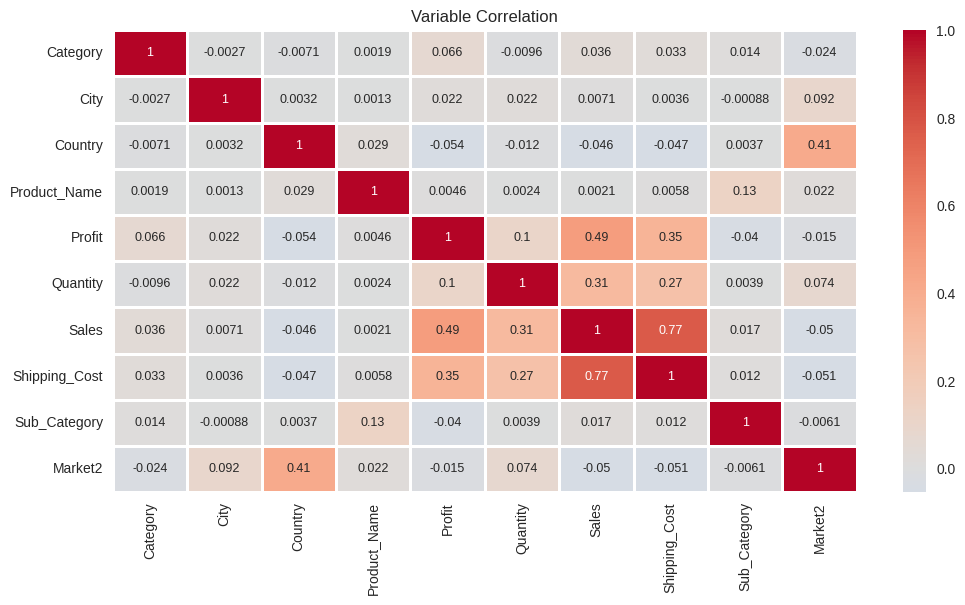

In [83]:
# Representing matrix as a plot
from IPython.core.pylabtools import figsize
f,ax=plt.subplots(figsize=(12,6))

sns.heatmap(df1.corr(), center=0, linewidth=0.8, cmap='coolwarm', annot=True, annot_kws={"size":9})
plt.title('Variable Correlation')

Plotting all variables against other variables to see if relation exists between them. Basically it tells the same thing as correlation matrix but in a graphical way.

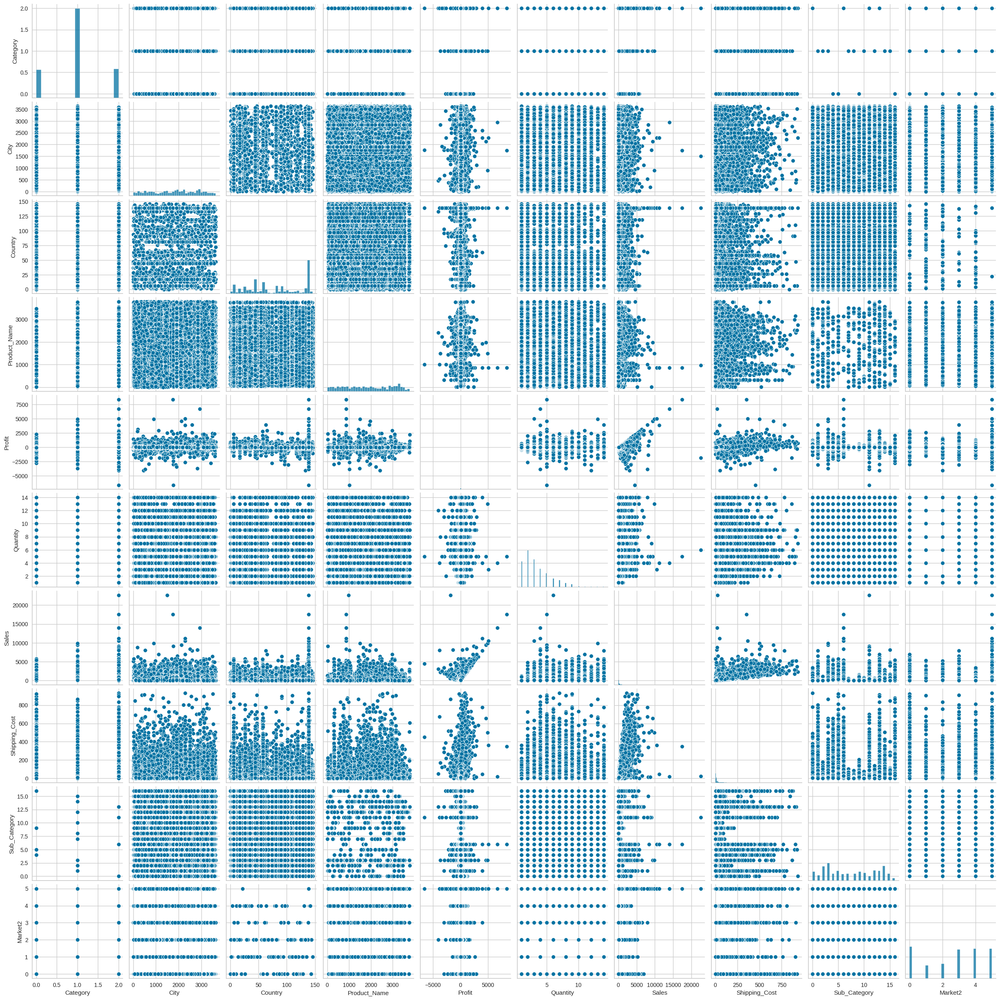

In [84]:
sns.pairplot(df1)

## H2O AutoML Reexecution on new model

The H2O AutoML model is trained on the updated data with significant features to predict the target variable.

In [118]:
df2 = df.drop(['Customer.ID', 'Order.ID', 'Product.ID', 'Row.ID', 'Customer.Name', 'Discount', 'Market', 'Order.Date', 'Order.Priority', 'Region', 'Segment', 'Ship.Date', 'Ship.Mode', 'State', 'Year', 'weeknum'],axis=1)

In [119]:
df2_train,df2_test = df2.split_frame([pct_rows])

In [120]:
# Seperate dependent variable from independent variable
X2=df2.columns
y2_numeric = 'Profit'
X2.remove(y2_numeric)

In [125]:
aml2 = H2OAutoML(max_runtime_secs=run_time, seed=1)

In [126]:
aml2.train(x=X2, y=y2_numeric, training_frame=df2_train)

AutoML progress: |███████████████████████████████████████████████████████████████| (done) 100%


key,value
Stacking strategy,cross_validation
Number of base models (used / total),6/8
# GBM base models (used / total),3/4
# XGBoost base models (used / total),2/2
# DRF base models (used / total),1/1
# GLM base models (used / total),0/1
Metalearner algorithm,GLM
Metalearner fold assignment scheme,Random
Metalearner nfolds,5
Metalearner fold_column,None


In [123]:
aml2_leaderboard = aml2.leaderboard
print(aml2_leaderboard)

model_id                                           rmse      mse      mae    rmsle    mean_residual_deviance
GBM_1_AutoML_3_20240403_05954                   128.474  16505.5  45.8178      nan                   16505.5
XGBoost_3_AutoML_3_20240403_05954               130.069  16918    48.4342      nan                   16918
XRT_1_AutoML_3_20240403_05954                   130.451  17017.4  45.381       nan                   17017.4
GBM_grid_1_AutoML_3_20240403_05954_model_1      131.632  17326.9  46.922       nan                   17326.9
DRF_1_AutoML_3_20240403_05954                   132.788  17632.7  44.8858      nan                   17632.7
GBM_5_AutoML_3_20240403_05954                   134.188  18006.4  48.2431      nan                   18006.4
XGBoost_grid_1_AutoML_3_20240403_05954_model_1  135.074  18245    48.755       nan                   18245
GBM_4_AutoML_3_20240403_05954                   137      18768.9  46.1083      nan                   18768.9
XGBoost_grid_1_AutoML_3

In [124]:
best_model2 = aml2.get_best_model()
print(best_model2)

Model Details
H2OGradientBoostingEstimator : Gradient Boosting Machine
Model Key: GBM_1_AutoML_3_20240403_05954


Model Summary: 
    number_of_trees    number_of_internal_trees    model_size_in_bytes    min_depth    max_depth    mean_depth    min_leaves    max_leaves    mean_leaves
--  -----------------  --------------------------  ---------------------  -----------  -----------  ------------  ------------  ------------  -------------
    80                 80                          112853                 15           15           15            27            223           106.737

ModelMetricsRegression: gbm
** Reported on train data. **

MSE: 18022.342108819776
RMSE: 134.24731695203363
MAE: 42.27599205958798
RMSLE: NaN
Mean Residual Deviance: 18022.342108819776

ModelMetricsRegression: gbm
** Reported on validation data. **

MSE: 16505.467981213144
RMSE: 128.47360811160067
MAE: 45.81784234866305
RMSLE: NaN
Mean Residual Deviance: 16505.467981213144

Scoring History: 
    timestamp 

The best model with the updated data is Gradient Boosting Machine.

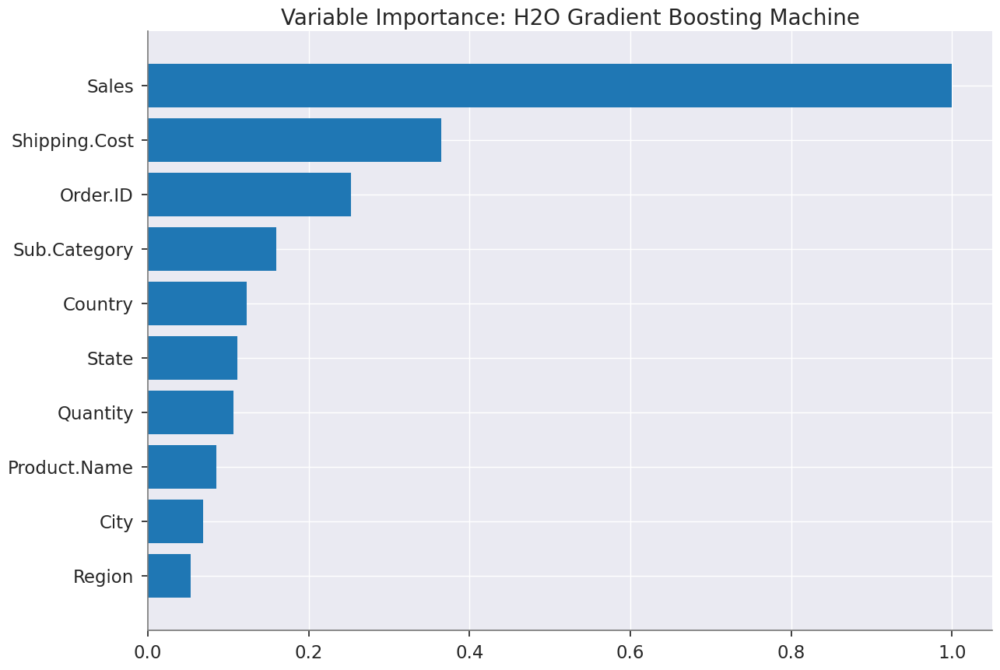

<Figure size 3200x2400 with 0 Axes>

In [77]:
#plot variables in order of their importance for price prediction
if best_model1.algo in ['gbm','drf','xrt','xgboost']:
    best_model1.varimp_plot()

## Question-1: Is the relationship significant?

A relationship is said to be statistically significant when the p value for the variables is less than 0.05. P value is probability of obtaining a result at least as extreme as the current one, assuming null hypothesis is true. A small p value depicts that there is very little similarity between the two groups and hence null hypothesis can be ignored. P-value was calculated by two ways for this model. From the OLS method it was observed that values for 'Customer_Name', 'Order_Date', 'Order_Priority', 'Region', 'Segment', 'Ship_Date', 'Ship_Mode', 'State' and 'weeknum'  were greater than 0.05. So, it can be concluded that p-value for all the variables of dataset is less than 0.05. Hence for the chosen dataset it can be concluded that the relationship is significant.

## Question-2: Are any model assumptions violated?

Checking if the model has violated any assumptions. For linear regression some of the assumptions are:

(1)There needs to be linear relation between the independent and dependent variable.

(2)Homoscedasticity which means normality of the error distribution.The plot for residuals against target variable should be normally distributed.

(3)Thirdly, linear regression assumes that there is little or no multicollinearity in the data. Multicollinearity occurs when the independent variables are too highly correlated with each other.

(4)There should be no or little auto correlation. One way to test this is by Durbin-Watson test. The values should be brtween 1.5-2.5 for no autocorrelation.

### Assumption-1: There needs to be linear relation between the independent and dependent variable

In [45]:
A=df1.drop(['Profit'], axis=1)
B=df1['Profit']

In [46]:
#Splitting the data
A_train, A_test, b_train, b_test = tts(A,B,test_size=0.2,random_state=42)
print(A_train.columns)

Index(['Category', 'City', 'Country', 'Product_Name', 'Quantity', 'Sales',
       'Shipping_Cost', 'Sub_Category', 'Market2'],
      dtype='object')


In [49]:
cols1 = ['Category', 'City', 'Country', 'Product_Name', 'Quantity', 'Sales', 'Shipping_Cost', 'Sub_Category', 'Market2']
model1 = sm.OLS(b_train,sm.add_constant(A_train[cols1])).fit()

In [50]:
b_pred = model1.predict(sm.add_constant(A_train[cols1]))

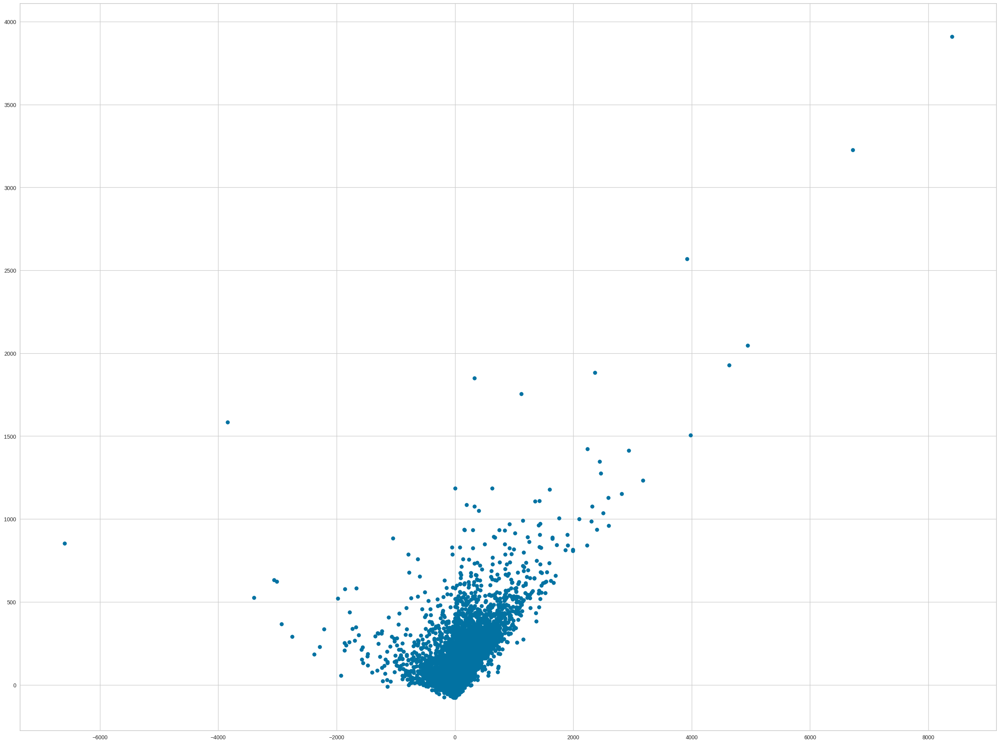

In [51]:
plt.scatter(b_train, b_pred)

There is a linear relaionship between dependent and independent variable. Hence, the assumption1 is not violated.

### Assumption-2: Homoscedasticity which means normality of the error distribution.The plot for residuals against target variable should be normally distributed.

In [52]:
residuals = b_train-b_pred
mean_residuals = np.mean(residuals)
print("Mean of residuals = {}".format(mean_residuals))

Mean of residuals = 5.378862538104611e-12


The difference between train and pred values which is Normality of error distribution is plotted below

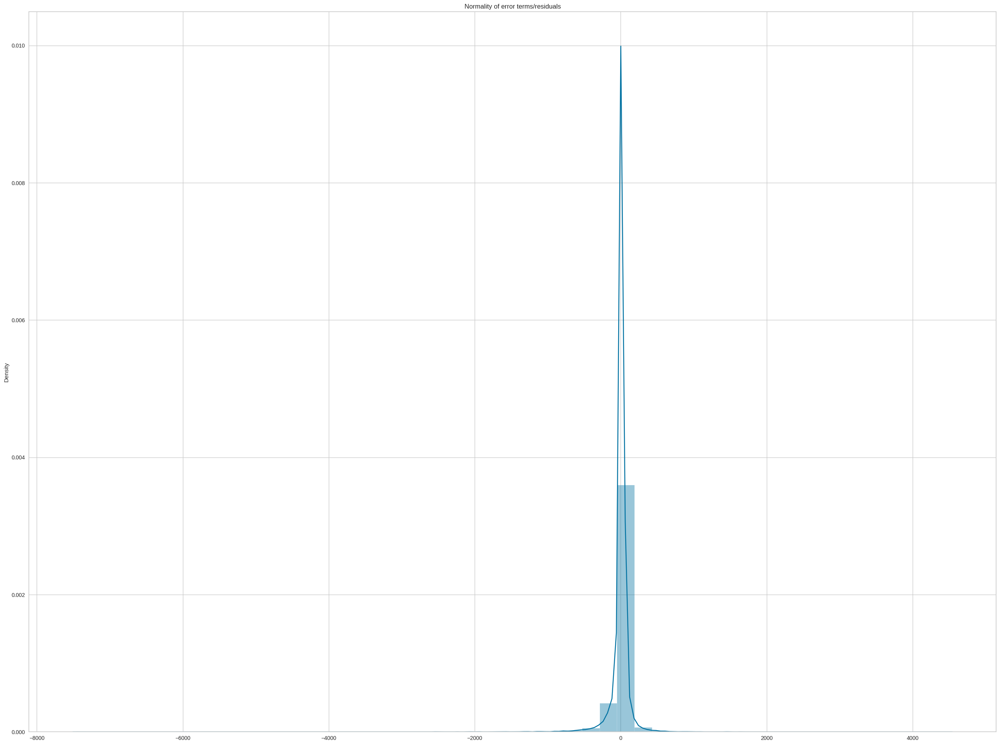

In [53]:
p=sns.distplot(residuals, kde=True)
p=plt.title('Normality of error terms/residuals')

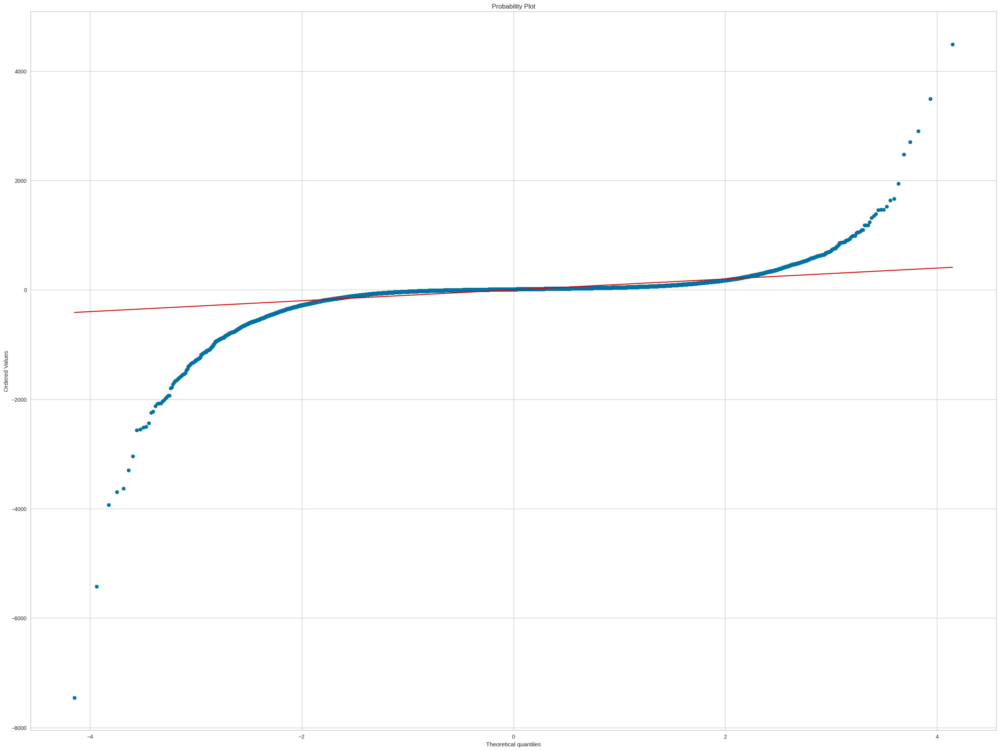

In [54]:
import pylab
import scipy.stats as stats
stats.probplot(residuals, dist="norm", plot=pylab)
pylab.show()

<Axes: xlabel='Profit', ylabel='Count'>

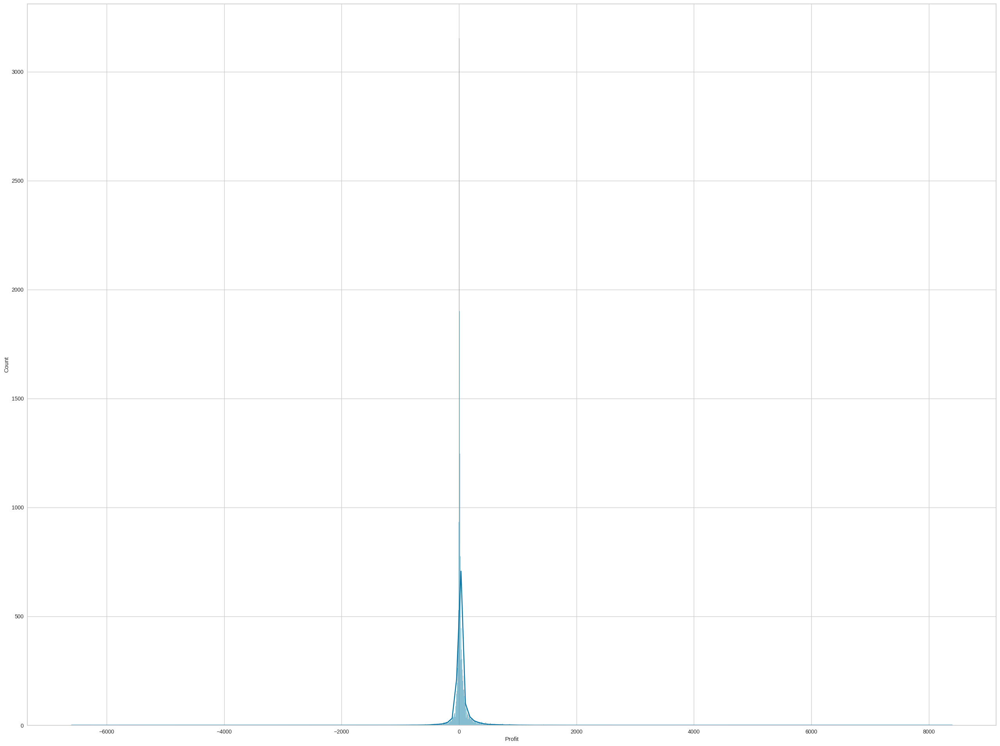

In [55]:
sns.histplot(df_pd.Profit, kde=True)

Ideally for the scatterplot the result should be scattered and it should not have any particular pattern.When the same is plotted as distplot it should follow a bell curve pattern.Both the plots give the expected result so even this assumptions are satisfied.

### Assumption-3: Thirdly, linear regression assumes that there is little or no multicollinearity in the data. Multicollinearity occurs when the independent variables are too highly correlated with each other.

There is no Multicollinearity in the data. All the independent variables which had high multicollinearity have been dropped by using different methods like OLS Regression method, VIF (Variance Inflation Factor) in the above code.

Therefore, the assumption is not violated.

### Assumption-4: No or little auto correlation. One way to test this is by Durbin-Watson test. The values should be brtween 1.5-2.5 for no autocorrelation.

In [57]:
# Auto Correlation is checked with the Durbin Watson test
from statsmodels.stats.stattools import durbin_watson
dw_stat = durbin_watson(model1.resid)
print(dw_stat)


1.994897890028633


As the value is 1.9 which is below 2.5 there is no auto correlation. Hence, the assumption 4 is not violated.

## Question-3:  Is there any multicollinearity in the model?

When one independent variable is related to another independent variable that is its highly correlated then multicollinearity exists in the model. It’s an issue as it undermines the statistical significance of an independent variable. Multicollinearity can be determined by computing correlation matrix or calculating VIF value of all variables. In correlation matrix a coefficient closer to +1 or -1 tells us that those two variables are highly correlated. For VIF values a value above 10 tells us that multicollinearity exists. In this model some variables had VIF value greater than 10 and p value was greater than 0.05.

Yes, there was mutlicollinearity in this model. The independent variables which are highly correlated are ['Customer_Name', 'Discount', 'Market', 'Order_Date', 'Order_Priority', 'Region', 'Segment', 'Ship_Date', 'Ship_Mode', 'State', 'Year', 'weeknum'] as they have p_value greater than 0.5 and VIF value greater than 10. These independent variables are dropped to avoid any further issues with multicollinearity.

In [58]:
df1.corr()

,Category,City,Country,Product_Name,Profit,Quantity,Sales,Shipping_Cost,Sub_Category,Market2
Category,1.000000,-0.002737,-0.007099,0.001946,0.066312,-0.009578,0.036390,0.032526,0.014290,-0.024124
City,-0.002737,1.000000,0.003159,0.001324,0.021860,0.022314,0.007091,0.003557,-0.000884,0.092239
Country,-0.007099,0.003159,1.000000,0.029090,-0.053735,-0.011571,-0.046146,-0.047266,0.003743,0.414575
Product_Name,0.001946,0.001324,0.029090,1.000000,0.004639,0.002443,0.002066,0.005773,0.128905,0.022169
Profit,0.066312,0.021860,-0.053735,0.004639,1.000000,0.104428,0.485172,0.354604,-0.040282,-0.014816
Quantity,-0.009578,0.022314,-0.011571,0.002443,0.104428,1.000000,0.313580,0.272601,0.003890,0.074414
Sales,0.036390,0.007091,-0.046146,0.002066,0.485172,0.313580,1.000000,0.768066,0.017167,-0.049657
Shipping_Cost,0.032526,0.003557,-0.047266,0.005773,0.354604,0.272601,0.768066,1.000000,0.012203,-0.051456
Sub_Category,0.014290,-0.000884,0.003743,0.128905,-0.040282,0.003890,0.017167,0.012203,1.000000,-0.006086
Market2,-0.024124,0.092239,0.414575,0.022169,-0.014816,0.074414,-0.049657,-0.051456,-0.006086,1.000000


Now, the model doesn't have any multicollinearity issues and the most important features to predict the target variable 'Profit' are 'Sales', 'Shipping_Cost', 'Quantity', 'Category'.

## Question-4:  In the multivariate models are predictor variables independent of all the other predictor variables?

Variables are said to be independent when there is no relation between them. To check this relation, correlation matrix can be used, or it can be observed from graphs too whether there is any pattern followed or not.

From the above correlation matrix computed for the model, it can be observed that  ['Customer_Name', 'Discount', 'Market', 'Order_Date', 'Order_Priority', 'Region', 'Segment', 'Ship_Date', 'Ship_Mode', 'State', 'Year', 'weeknum'] are highly correlated to each other. So they are dropped to improve the model's performance. Other than those other predictors are independent from each other.

## Question-5: In the multivariate models rank the most significant predictor variables and exclude insignificant ones from the model.

From the variable importance plot of the best model trained with updated data, the most to least important variables are displayed.

1. Sales - (Feature_Importance=1)
2. Shipping.Cost - (Feature_Importance=0.231446)
3. Country - (Feature_Importance=0.170764)
4. Sub.Category - (Feature_Importance=0.109367)
5. Quantity - (Feature_Importance=0.106227)
6. City - (Feature_Importance=0.0780346)
7. Product.Name - (Feature_Importance=0.0643748)
8. Market2 - (Feature_Importance=0.0505679)
9. Category - (Feature_Importance=0.0346058)

Independent variables such as 'Customer.ID', 'Order.ID', 'Product.ID', 'Row.ID', 'Customer.Name', 'Discount', 'Market', 'Order.Date', 'Order.Priority', 'Region', 'Segment', 'Ship.Date', 'Ship.Mode', 'State', 'Year', 'weeknum' are excluded as they are insignificant.

## Question-6: Does the model make sense?

For a model to make sense it should follow all the assumptions and have p value, VIF between their respective ranges. RMSE should be as low as possible considering the minimum and maximum values of the target variable. Other than that, R2 too is 0.83 which is considered good in terms of accuracy. So overall the model makes sense. To increase the accuracy, some additional variables can be dropped depending on their importance. Furthermore, outliers can be removed or boosting, or ensemble model can be used.

## Question-7: Does regularization help?

### Ridge Regularization in H20

* It's a technique to prevent overfitting of the data. Overfitting occurs when a model learns the data and noise in the training data and performs poorly on new data.

* The main purpose of regression is to find patterns in this underlying dataset and generalize it to predict the corresponding target value for some new values of independent values. But sometimes target dataset is inflicted with some random noise. Although there may not be error for training set it will give huge errors in predicting the correct target values for test dataset.To avoid this condition regularization is used.

* Regularization is a technique used for tuning the random noise function by adding an additional term to noise function. This additional term controls the excessively fluctuating function such that the coefficients don’t take extreme values and the prediction of target value for test data is not highly affected. For this model, Ridge Regularization is used.

* (L2 Regularization) Ridge Regression - Adds a penalty equal to the square of magnitude of co-efficient. This regression doesn't eliminate the features directly instead it shrinks the co-efficients for the predictors which contributes less to the model

Here, we use H2OGeneralizedLinearEstimator which would enable us to fit a generalized linear model, specified by a response variable, a set of predictors and a description of the error distribution.

1. In this regularization, the house_glm lambda_ value=0 which means the regularization is disabled.
2. house_glm_regularization is the model where regularization is implemented as lambda_ value=0.001 which indicates small amount of regularization.
3. alpha value ranges from 0 to 1 where 0 represents Ridge Regression(L2 - Regularization) and 1 represents Lasso Regression (L1 - Regularization) and any value between 0 to 1 represents combination of both which is Elastic Net Regularization
4. Both normal model and regularized model are trained with the training data.

In [127]:
from h2o.estimators.glm import H2OGeneralizedLinearEstimator
house_glm = H2OGeneralizedLinearEstimator(family = 'gaussian', lambda_= 0, compute_p_values= True)
house_glm_regularization = H2OGeneralizedLinearEstimator(family='gaussian', lambda_ = .001, alpha=0)

In [128]:
house_glm_regularization.train(x = X2, y = y2_numeric, training_frame= df2_train)

glm Model Build progress: |██████████████████████████████████████████████████████| (done) 100%


Model Details
=============
H2OGeneralizedLinearEstimator : Generalized Linear Modeling
Model Key: GLM_model_python_1712105305832_63


GLM Model: summary
    family    link      regularization            number_of_predictors_total    number_of_active_predictors    number_of_iterations    training_frame
--  --------  --------  ------------------------  ----------------------------  -----------------------------  ----------------------  ----------------
    gaussian  identity  Ridge ( lambda = 0.001 )  9                             9                              1                       py_46_sid_97dd

ModelMetricsRegressionGLM: glm
** Reported on train data. **

MSE: 23231.10087679348
RMSE: 152.41752155442458
MAE: 56.079516887023054
RMSLE: NaN
Mean Residual Deviance: 23231.10087679348
R^2: 0.22013790923208532
Null degrees of freedom: 41027
Residual degrees of freedom: 41018
Null deviance: 1222171994.3260267
Residual deviance: 953125606.7730829
AIC: 528919.0470154851

Scoring History: 
    timestamp            duration    iterations    negative_log_likelihood    objective          training_rmse       training_deviance    training_mae        training_r2
--  -------------------  ----------  ------------  -------------------------  -----------------  ------------------  -------------------  ------------------  -------------------
    2024-04-03 01:20:00  0.000 sec   0             1222171994.3260267         29788.72950975009
    2024-04-03 01:20:00  0.070 sec   1                                                           152.41752155442458  23231.10087679348    56.079516887023054  0.22013790923208532

Variable Importances: 
variable       relative_importance    scaled_importance    percentage
-------------  ---------------------  -------------------  ------------
Sales          80.7071                1                    0.643723
Category       9.01942                0.111755             0.0719392
Sub.Category   8.5304                 0.105696             0.0680388
Quantity       8.28136                0.10261              0.0660524
Country        8.02532                0.0994376            0.0640102
Market2        4.50532                0.055823             0.0359346
City           3.38287                0.0419154            0.0269819
Product.Name   1.96984                0.0244073            0.0157115
Shipping.Cost  0.953947               0.0118199            0.00760872

[tips]
Use `model.explain()` to inspect the model.
--
Use `h2o.display.toggle_user_tips()` to switch on/off this section.

In [130]:
# Model details without regularization
house_glm.train(x=X2, y=y2_numeric, training_frame=df2_train)

glm Model Build progress: |██████████████████████████████████████████████████████| (done) 100%


Model Details
=============
H2OGeneralizedLinearEstimator : Generalized Linear Modeling
Model Key: GLM_model_python_1712105305832_87


GLM Model: summary
    family    link      regularization    number_of_predictors_total    number_of_active_predictors    number_of_iterations    training_frame
--  --------  --------  ----------------  ----------------------------  -----------------------------  ----------------------  ----------------
    gaussian  identity  None              9                             9                              1                       py_46_sid_97dd

ModelMetricsRegressionGLM: glm
** Reported on train data. **

MSE: 23231.084083948434
RMSE: 152.4174664661122
MAE: 56.09221795737
RMSLE: NaN
Mean Residual Deviance: 23231.084083948434
R^2: 0.22013847296358113
Null degrees of freedom: 41027
Residual degrees of freedom: 41018
Null deviance: 1222171994.3260267
Residual deviance: 953124917.7962364
AIC: 528919.0173579542

Scoring History: 
    timestamp            duration    iterations    negative_log_likelihood    objective          training_rmse      training_deviance    training_mae    training_r2
--  -------------------  ----------  ------------  -------------------------  -----------------  -----------------  -------------------  --------------  -------------------
    2024-04-03 01:24:43  0.000 sec   0             1222171994.3260267         29788.72950975009
    2024-04-03 01:24:43  0.188 sec   1                                                           152.4174664661122  23231.084083948434   56.09221795737  0.22013847296358113

Variable Importances: 
variable       relative_importance    scaled_importance    percentage
-------------  ---------------------  -------------------  ------------
Sales          80.9094                1                    0.644616
Category       9.02541                0.111549             0.0719066
Sub.Category   8.54133                0.105567             0.0680498
Quantity       8.31488                0.102768             0.0662457
Country        8.03748                0.0993392            0.0640356
Market2        4.51951                0.0558589            0.0360075
City           3.3848                 0.0418344            0.0269671
Product.Name   1.97385                0.0243958            0.0157259
Shipping.Cost  0.809085               0.00999988           0.00644608

[tips]
Use `model.explain()` to inspect the model.
--
Use `h2o.display.toggle_user_tips()` to switch on/off this section.

From the above results, the accuracy and other related variables were same for both the cases. When dataset was regularized and when dataset was not regularized. This tells that for this specific model regularization does not help.

## Question-8: Which independent variables are significant?

According to the data report below, the independent variables which are significant are: Sales, Shipping.Cost, Country, Sub.Category.

### Data Report

# Leaderboard

> Leaderboard shows models with their metrics. When provided with H2OAutoML object, the leaderboard shows 5-fold cross-validated metrics by default (depending on the H2OAutoML settings), otherwise it shows metrics computed on the frame. At most 20 models are shown by default.

model_id,rmse,mse,mae,rmsle,mean_residual_deviance,training_time_ms,predict_time_per_row_ms,algo
StackedEnsemble_BestOfFamily_2_AutoML_4_20240403_11551,133.668,17867.2,45.7543,nan,17867.2,752,0.09118,StackedEnsemble
StackedEnsemble_AllModels_1_AutoML_4_20240403_11551,134.269,18028.2,45.0192,nan,18028.2,2224,0.061926,StackedEnsemble
StackedEnsemble_AllModels_2_AutoML_4_20240403_11551,134.272,18029,45.2047,nan,18029,1570,0.106636,StackedEnsemble
StackedEnsemble_BestOfFamily_3_AutoML_4_20240403_11551,134.435,18072.8,46.4052,nan,18072.8,1132,0.02283,StackedEnsemble
GBM_2_AutoML_4_20240403_11551,135.194,18277.4,48.2965,nan,18277.4,2886,0.050367,GBM
GBM_4_AutoML_4_20240403_11551,135.353,18320.3,46.3177,nan,18320.3,2142,0.042863,GBM
XGBoost_1_AutoML_4_20240403_11551,135.778,18435.7,48.3504,nan,18435.7,10520,0.004095,XGBoost
GBM_3_AutoML_4_20240403_11551,136.382,18600,47.4483,nan,18600,2715,0.033333,GBM
XGBoost_2_AutoML_4_20240403_11551,137.148,18809.6,47.3081,nan,18809.6,1956,0.010001,XGBoost
StackedEnsemble_BestOfFamily_1_AutoML_4_20240403_11551,137.997,19043.3,45.1959,nan,19043.3,1606,0.029502,StackedEnsemble


# Residual Analysis

> Residual Analysis plots the fitted values vs residuals on a test dataset. Ideally, residuals should be randomly distributed. Patterns in this plot can indicate potential problems with the model selection, e.g., using simpler model than necessary, not accounting for heteroscedasticity, autocorrelation, etc. Note that if you see "striped" lines of residuals, that is an artifact of having an integer valued (vs a real valued) response variable.

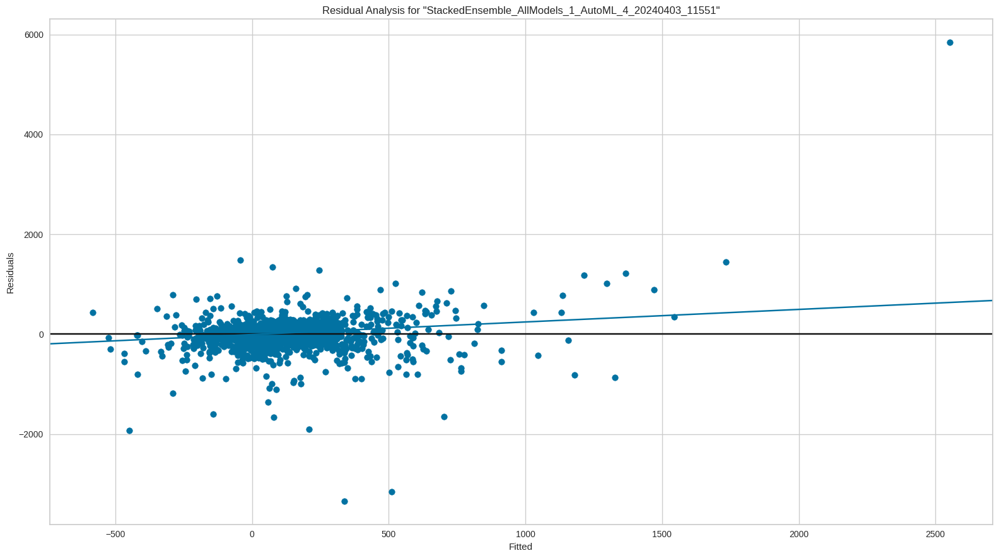

# Learning Curve Plot

> Learning curve plot shows the loss function/metric dependent on number of iterations or trees for tree-based algorithms. This plot can be useful for determining whether the model overfits.

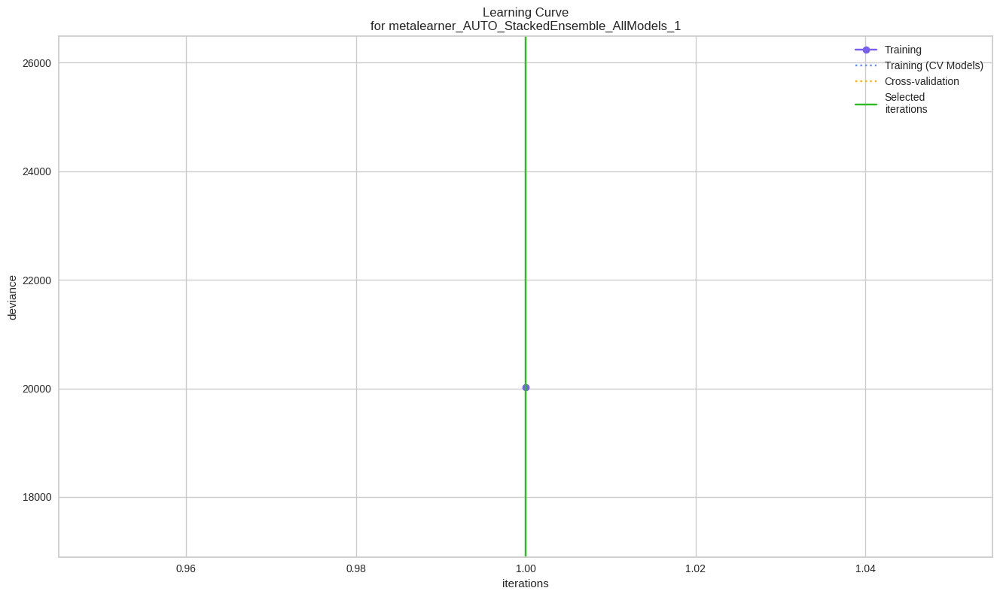

# Variable Importance

> The variable importance plot shows the relative importance of the most important variables in the model.

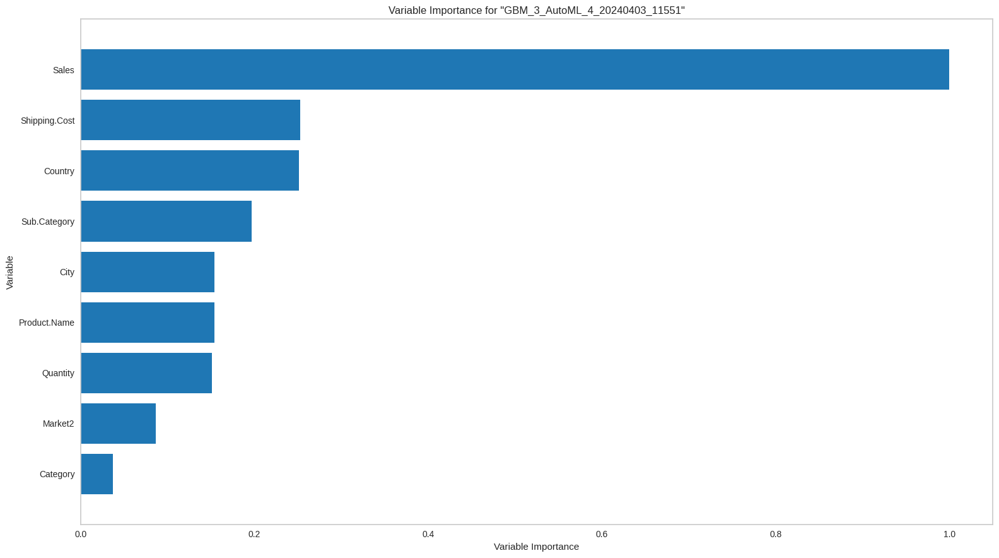

# Variable Importance Heatmap

> Variable importance heatmap shows variable importance across multiple models. Some models in H2O return variable importance for one-hot (binary indicator) encoded versions of categorical columns (e.g. Deep Learning, XGBoost). In order for the variable importance of categorical columns to be compared across all model types we compute a summarization of the the variable importance across all one-hot encoded features and return a single variable importance for the original categorical feature. By default, the models and variables are ordered by their similarity.

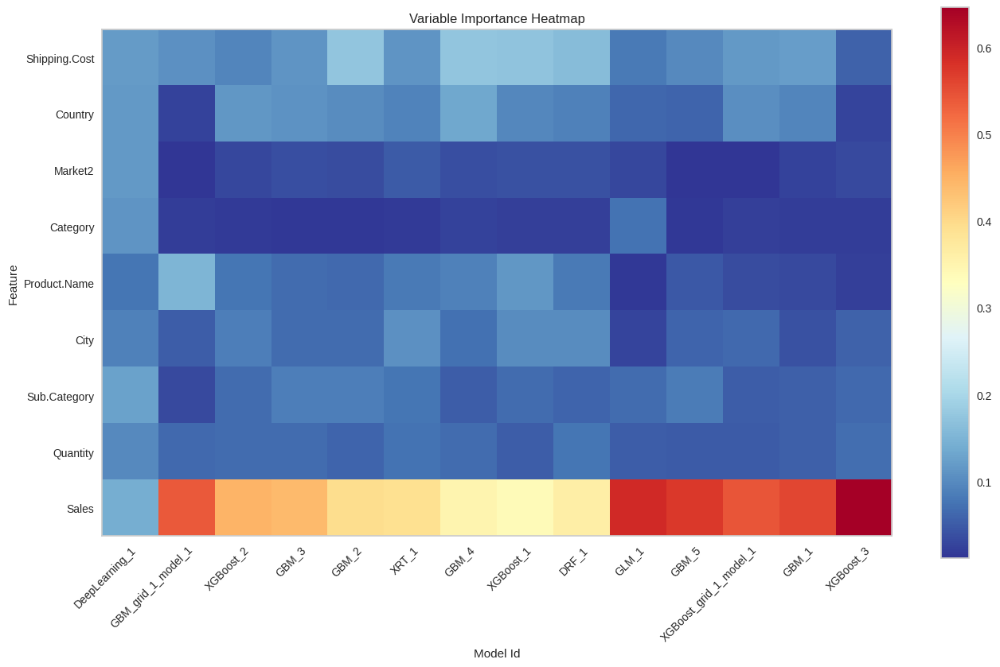

# Model Correlation

> This plot shows the correlation between the predictions of the models. For classification, frequency of identical predictions is used. By default, models are ordered by their similarity (as computed by hierarchical clustering). Interpretable models, such as GAM, GLM, and RuleFit are highlighted using red colored text.

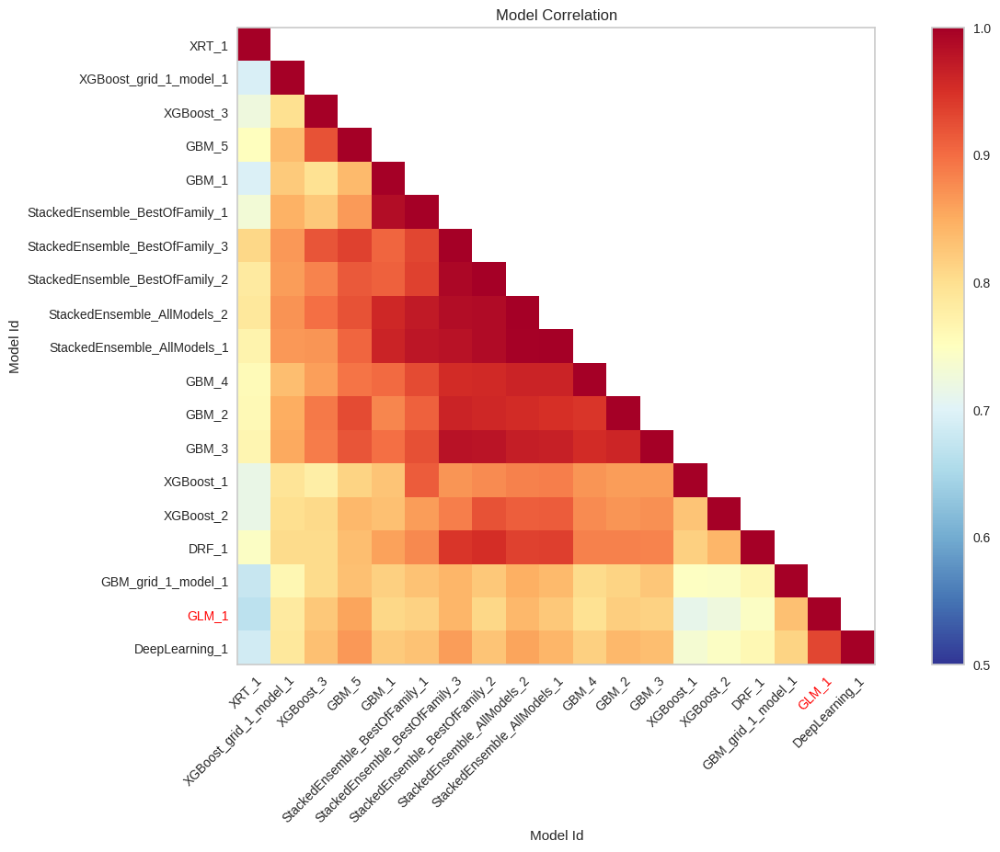

# SHAP Summary

> SHAP summary plot shows the contribution of the features for each instance (row of data). The sum of the feature contributions and the bias term is equal to the raw prediction of the model, i.e., prediction before applying inverse link function.

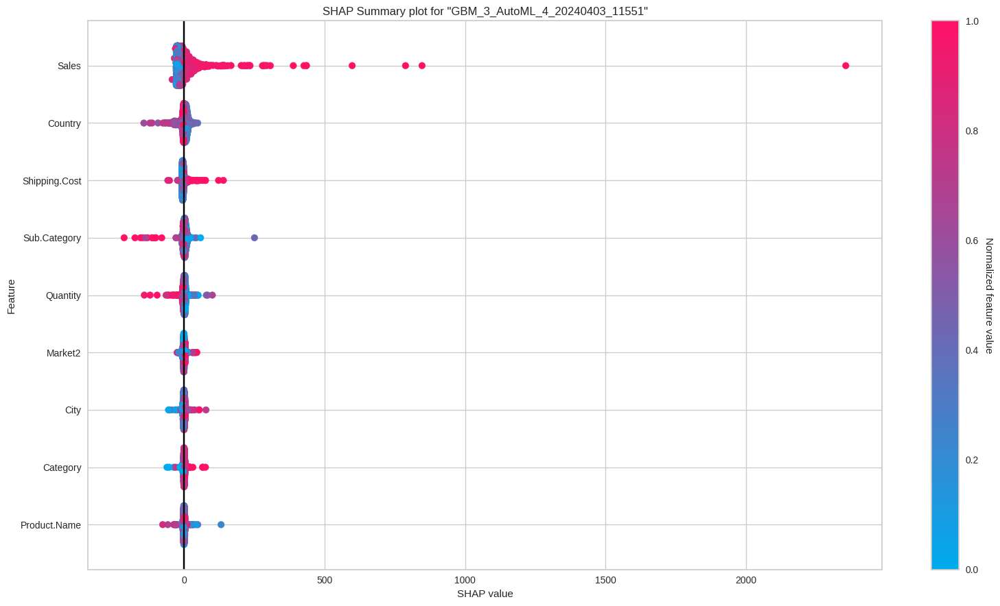

# Partial Dependence Plots

> Partial dependence plot (PDP) gives a graphical depiction of the marginal effect of a variable on the response. The effect of a variable is measured in change in the mean response. PDP assumes independence between the feature for which is the PDP computed and the rest.

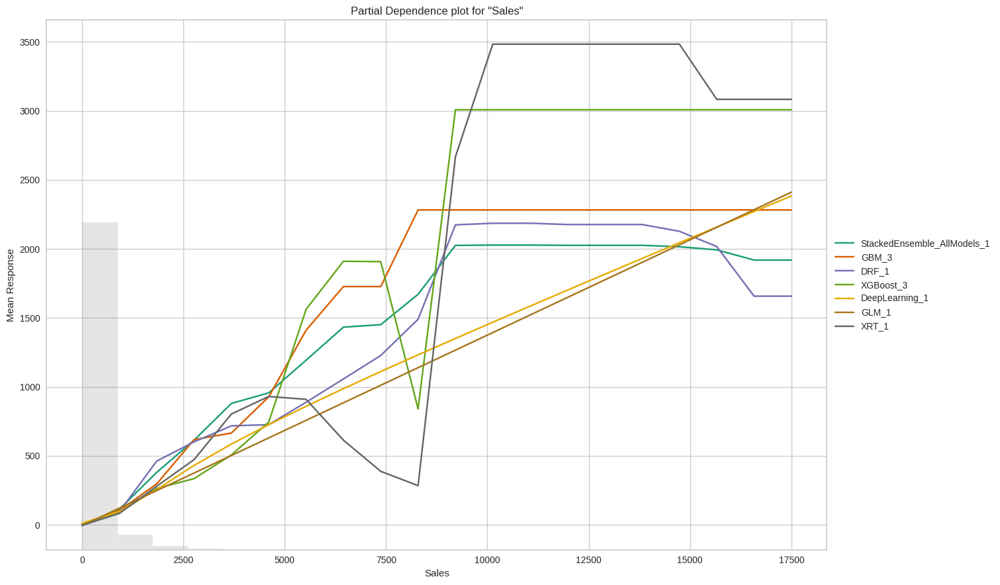

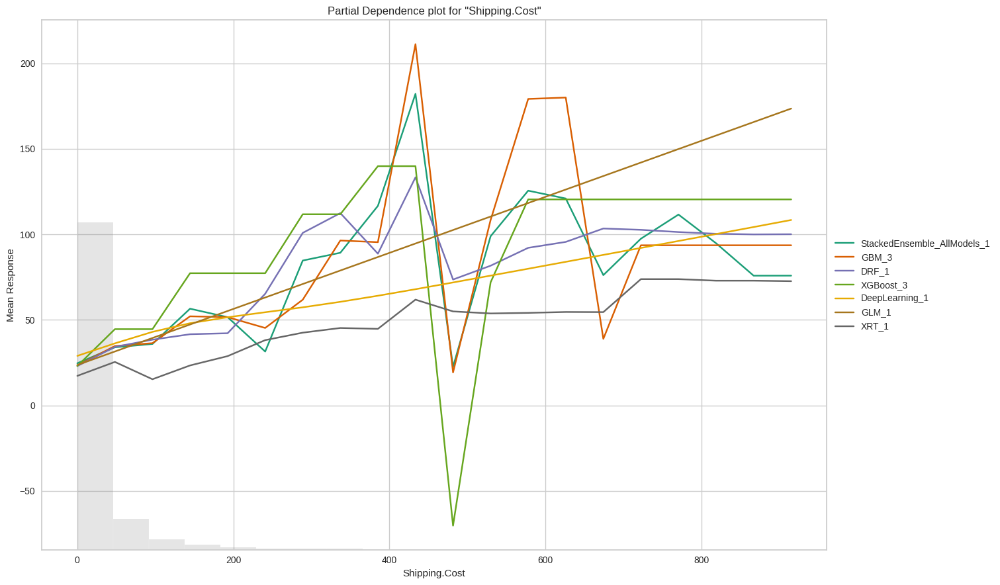

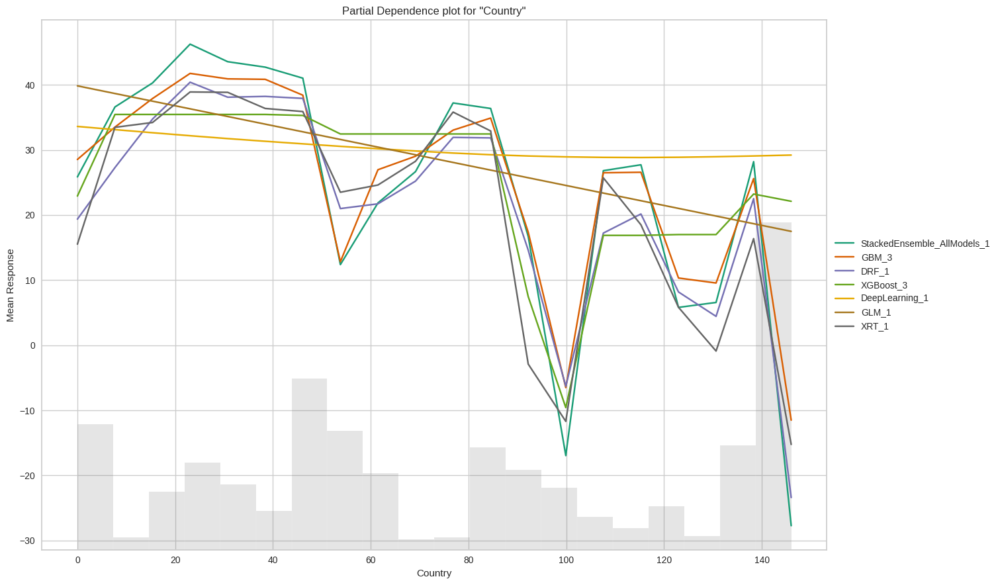

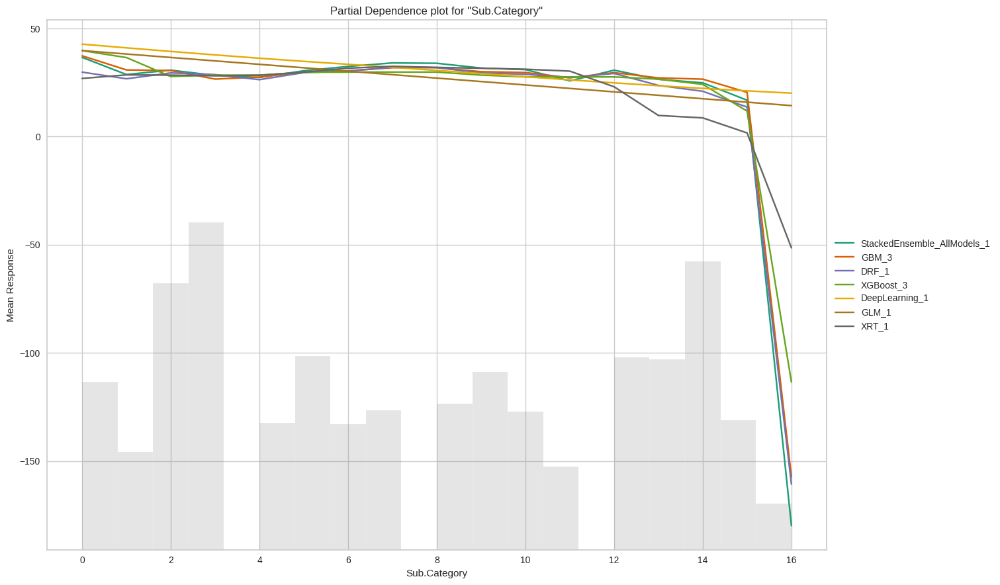

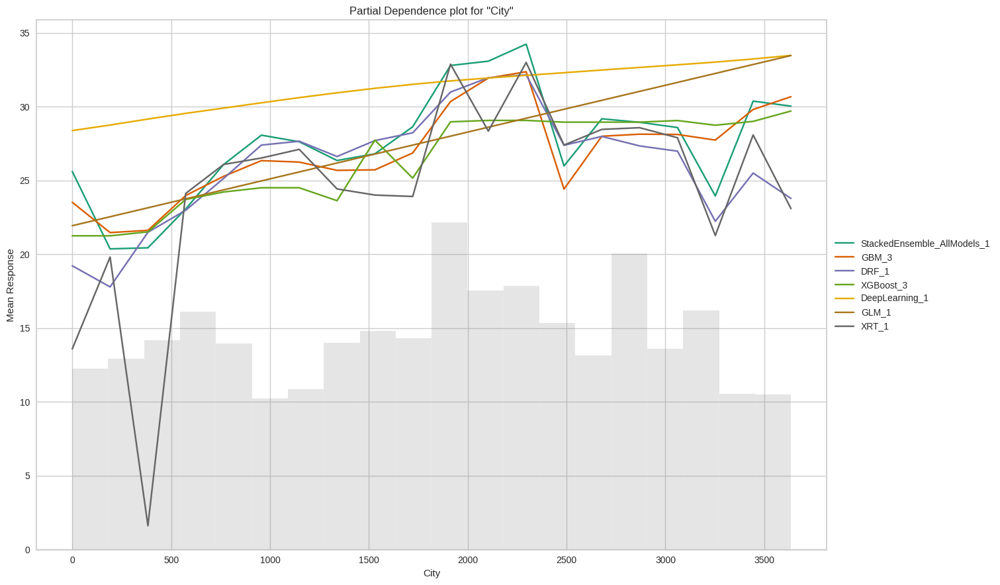

# Individual Conditional Expectation

> An Individual Conditional Expectation (ICE) plot gives a graphical depiction of the marginal effect of a variable on the response. ICE plots are similar to partial dependence plots (PDP); PDP shows the average effect of a feature while ICE plot shows the effect for a single instance. This function will plot the effect for each decile. In contrast to the PDP, ICE plots can provide more insight, especially when there is stronger feature interaction.

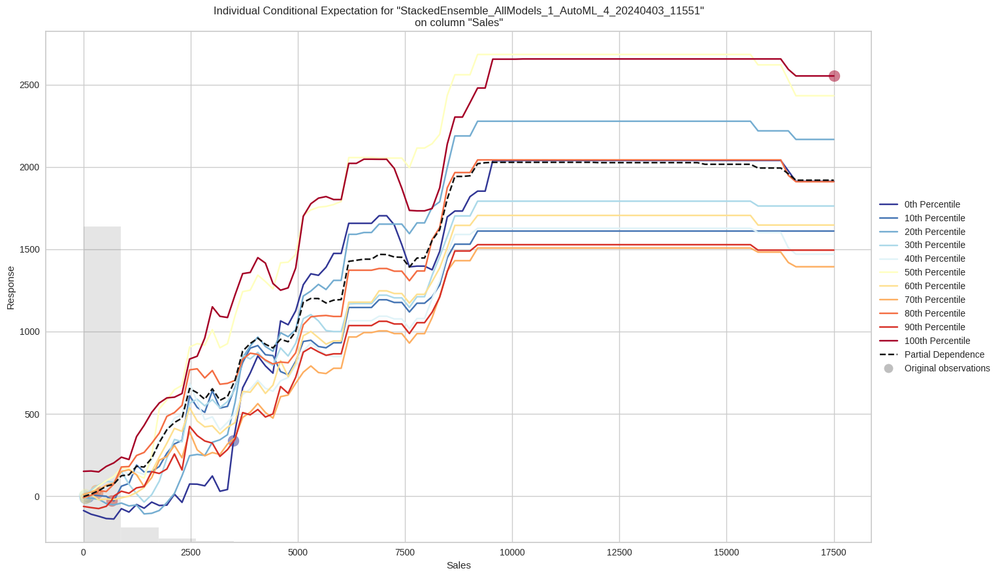

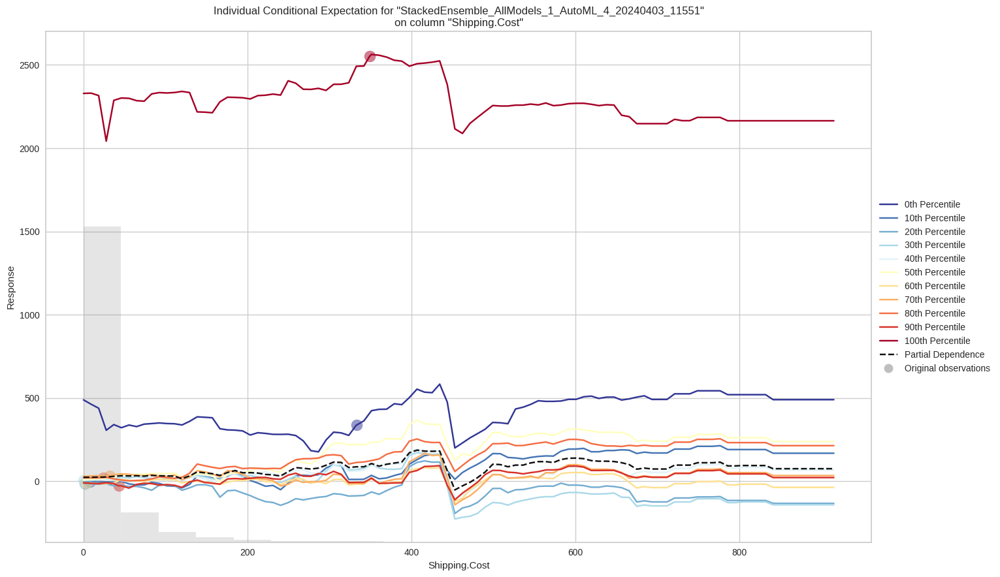

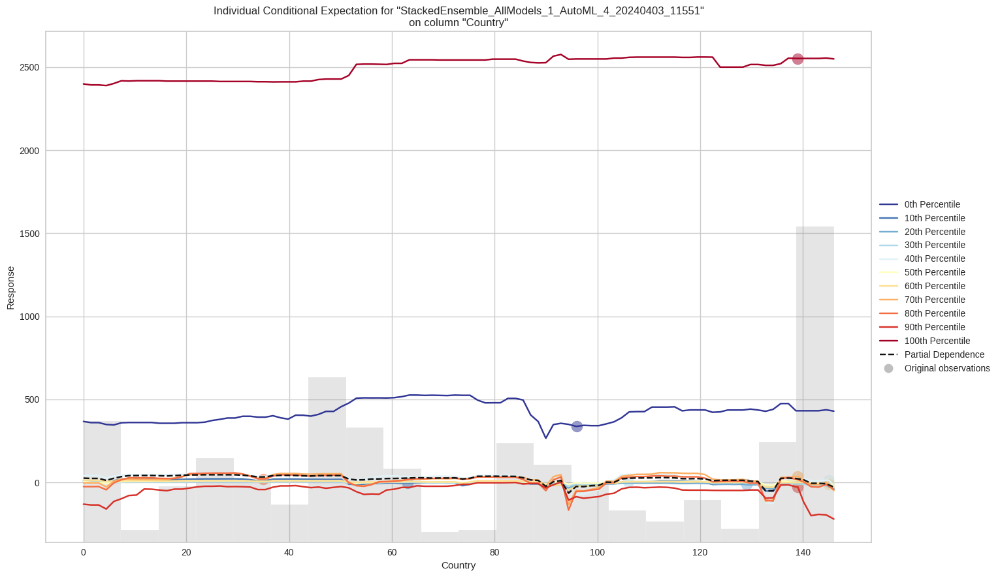

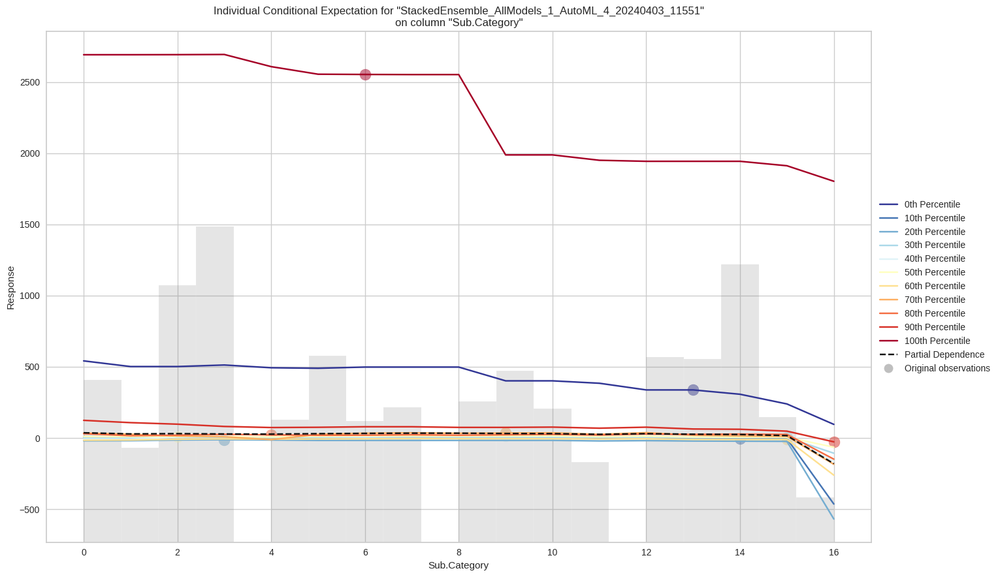

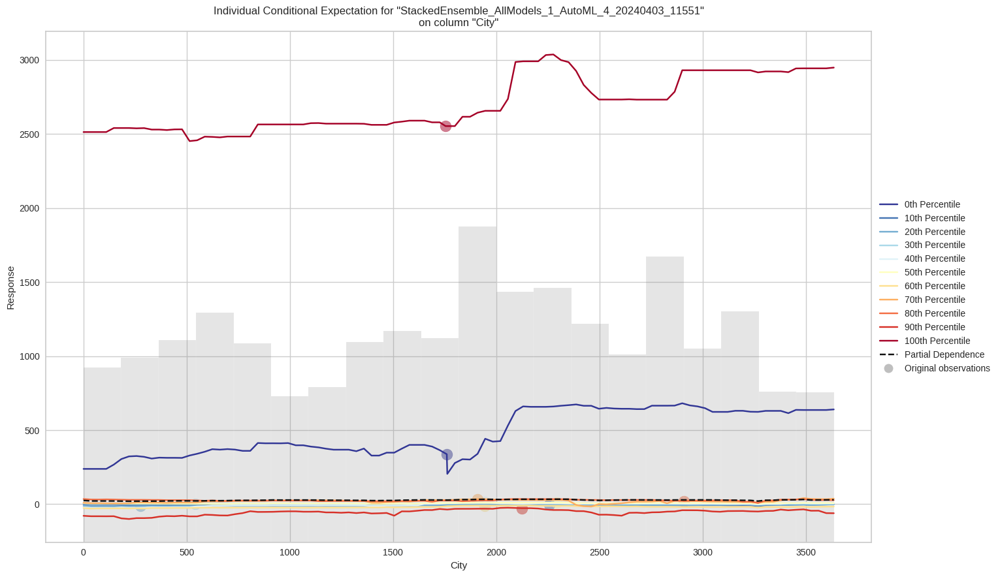

In [132]:
exa = aml2.explain(df2_test)

## Question-9: Which hyperparameters are important?

### Hyperparameter Tuning

* Hyperparameter tuning is the process of finding the optimal hyperparameters for a machine learning algorithm.
* Hyperparameter tuning involves searching for the best combination of hyperparameters that results in the highest performance of the model on a validation dataset.

To find best set a hyperparameter and combinations of interacting hyperparameters for a given dataset hyperparameters tuning is used. It objectively searches different values for model hyperparameters and chooses a subset that results in a model that achieves the best performance on a given dataset.

In [91]:
s=df1['Profit']
t=df1.drop(['Profit'], axis=1)

In [92]:
t_train, t_test, s_train, s_test = train_test_split(t, s, random_state=101, test_size=0.2)

In [93]:
from sklearn.model_selection import RandomizedSearchCV
from sklearn.ensemble import RandomForestRegressor
mode = RandomForestRegressor()
param_vals = {'max_depth' : [200,800], 'n_estimators': [100,300], 'min_samples_split': [2,3]}
random_rf = RandomizedSearchCV(estimator=mode, param_distributions=param_vals, n_iter=10, scoring='accuracy', cv=5, refit=True, n_jobs=-1)

# Training and prediction
random_rf.fit(t_train, s_train)
preds = random_rf.best_estimator_.predict(t_test)

In [94]:
random_rf.best_params_

{'n_estimators': 100, 'min_samples_split': 2, 'max_depth': 200}

The random forest best_params_ attribute is used to find the best parameters found during the tuning process. These parameters include:

{'n_estimators': 100, 'min_samples_split': 2, 'max_depth': 200}

where,

1. n_estimators: This is the number of decision trees in the forest. Increasing this hyperparameter can often lead to better performance, but it also increases the computational cost of training and prediction.

2. max_depth: This hyperparameter controls the maximum depth of each decision tree in the forest. Increasing this hyperparameter can lead to more complex models that are better able to capture intricate relationships in the data, but it can also increase the risk of overfitting.

3. min_samples_split: This hyperparameter controls the minimum number of samples required to split an internal node in each decision tree. Increasing this hyperparameter can help prevent overfitting by enforcing a minimum number of samples required to form a split.

## Conclusion

A fundamental algorithm based on the linear regression method to predict profit is constructed. VIF, p-values and other methods are considered to ignore some of the independent variables. H2O.ai framework is used to train and test the variables of the dataset of the Global SuperStore profit. This gave the best model as ‘gbm’. From the results shown it can be concluded that the proposed linear regression model can effectively analyze and predict the profit to some extent. Admittedly, the prediction accuracy is still limited at specific points, and the model still needs to be improved in further research. In further research into the corresponding models, different techniques like removing outliers and using ensemble or booster can help achieve better prediction.

# **Model Interpretability**

In [135]:
data.head()

,Category,City,Country,Customer.ID,Customer.Name,Discount,Market,Order.Date,Order.ID,Order.Priority,...,Sales,Segment,Ship.Date,Ship.Mode,Shipping.Cost,State,Sub.Category,Year,Market2,weeknum
0,1,1910,139,2909,481,0,6,281,722,1,...,19,0,388,2,4,192,12,2011,5,2
1,1,1910,139,3341,498,0,6,939,920,3,...,19,0,1203,3,0,192,12,2011,5,4
2,1,1910,139,1057,141,0,6,213,572,3,...,21,0,416,3,1,192,12,2011,5,32
3,1,1910,139,1057,141,0,6,213,572,3,...,111,0,416,3,4,192,12,2011,5,32
4,1,1910,139,277,60,0,6,1342,905,1,...,6,0,133,3,1,192,12,2011,5,40


In [145]:
data.columns

Index(['Category', 'City', 'Country', 'Customer.ID', 'Customer.Name',
       'Discount', 'Market', 'Order.Date', 'Order.ID', 'Order.Priority',
       'Product.ID', 'Product.Name', 'Profit', 'Quantity', 'Region', 'Row.ID',
       'Sales', 'Segment', 'Ship.Date', 'Ship.Mode', 'Shipping.Cost', 'State',
       'Sub.Category', 'Year', 'Market2', 'weeknum'],
      dtype='object')

In [146]:
data = data.drop(columns = ['Customer.ID', 'Order.ID', 'Row.ID', 'Product.ID'])

In [147]:
X = data.drop(columns = ['Profit'])
y = data['Profit']

In [149]:
# Splitting Data into Training and Test
(x_train, x_test, y_train, y_test) = train_test_split(X, y, test_size=0.1, random_state=42)

# Taking 100 samples out for SHAP analysis as it is a computationally expensive process
x_train_100 = shap.utils.sample(x_train, 100)
x_test_100 = shap.utils.sample(x_test, 100)

## Fitting a Linear Model

In [150]:
# Initializing a linear model
linear_model = sklearn.linear_model.LinearRegression()
# Training linear model
linear_model.fit(x_train, y_train)

LinearRegression()

In [151]:
# Scaling the data using Min-Max scaling for the purpose of evaluating Co-efficients, as non scaled data may mislead while we evaluate the co-efficients
df = data.drop('Profit', axis=1)
df_norm = (df - df.min()) / (df.max() - df.min())
df_norm = pd.concat((df_norm, data.Profit), 1)

In [152]:
df_norm.head()

,Category,City,Country,Customer.Name,Discount,Market,Order.Date,Order.Priority,Product.Name,Quantity,...,Segment,Ship.Date,Ship.Mode,Shipping.Cost,State,Sub.Category,Year,Market2,weeknum,Profit
0,0.5,0.525447,0.952055,0.605793,NaN,1.0,0.196641,0.333333,0.986533,0.153846,...,0.0,0.265208,0.666667,0.004287,0.175663,0.75,0.0,1.0,0.019231,9
1,0.5,0.525447,0.952055,0.627204,NaN,1.0,0.657103,1.000000,0.942435,0.076923,...,0.0,0.822283,1.000000,0.000000,0.175663,0.75,0.0,1.0,0.057692,9
2,0.5,0.525447,0.952055,0.177582,NaN,1.0,0.149055,1.000000,0.046211,0.153846,...,0.0,0.284347,1.000000,0.001072,0.175663,0.75,0.0,1.0,0.596154,9
3,0.5,0.525447,0.952055,0.177582,NaN,1.0,0.149055,1.000000,0.953789,0.076923,...,0.0,0.284347,1.000000,0.004287,0.175663,0.75,0.0,1.0,0.596154,53
4,0.5,0.525447,0.952055,0.075567,NaN,1.0,0.939118,0.333333,0.986005,0.000000,...,0.0,0.090909,1.000000,0.001072,0.175663,0.75,0.0,1.0,0.750000,3


In [153]:
df_norm.columns = df_norm.columns.str.replace('.', '_')

### Interpreting Regression Coefficients

In [155]:
import statsmodels.formula.api as smf
# Assuming dfpd is the correct DataFrame and all columns are appropriately named
results = smf.ols('Profit ~ Category + City + Country + Customer_Name + Order_Date + Order_Priority + Product_Name + Quantity + Region + Sales + Segment + Ship_Date + Ship_Mode + Shipping_Cost + State + Sub_Category + Market2 + weeknum', data=df_norm).fit()
results_summary = results.summary()
print(results_summary)

                            OLS Regression Results                            
Dep. Variable:                 Profit   R-squared:                       0.246
Model:                            OLS   Adj. R-squared:                  0.245
Method:                 Least Squares   F-statistic:                     927.7
Date:                Wed, 03 Apr 2024   Prob (F-statistic):               0.00
Time:                        02:02:34   Log-Likelihood:            -3.3021e+05
No. Observations:               51290   AIC:                         6.605e+05
Df Residuals:                   51271   BIC:                         6.606e+05
Df Model:                          18                                         
Covariance Type:            nonrobust                                         
                     coef    std err          t      P>|t|      [0.025      0.975]
----------------------------------------------------------------------------------
Intercept         -2.0783      4.112     -0.

Linear model has very limited predicting capability as R-square value is 0.248. It only explains 24.8% of variance in 'Profit'. Independent variables like 'Sales', 'Shipping Cost' has significant impact in predicting the target variable 'Profit' as indicated by the p-values.

**Model Summary**

* R-squared:  0.248 which means that approximately 24.8% of the variance in the dependent variable is explained by the independent variables in the model

* Adjusted R-squared: 0.247. In this case, the adjusted R-squared value is slightly lower than the R-squared. This suggests that the addition of predictors may not have substantially improved the model's explanatory power.

* F-statistic: 938.2 indicates that the regression model is statistically significant at a high level.

## Fit Tree Based Model

In [158]:
# Setting the max_dept to 3 for the purpose of ease of explainbility and readability
tree_model = RandomForestRegressor(max_depth=3, random_state=0, n_estimators=10)
tree_model.fit(x_train, y_train)

RandomForestRegressor(max_depth=3, n_estimators=10, random_state=0)

### Interpreting Nodes of a tree based model

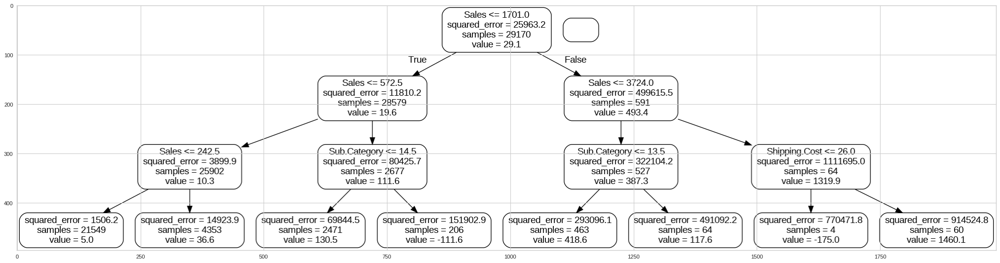

In [159]:
# Visualization of Nodes
figure(figsize=(32, 24), dpi=80)
tree = tree_model.estimators_[0]
export_graphviz(
    tree,
    out_file="tree.dot",
    feature_names=list(x_train.columns),
    rounded=True,
    precision=1,
)
(graph,) = pydot.graph_from_dot_file("tree.dot")
graph.write_png("tree.png")
img = mpimg.imread("tree.png")
imgplot = plt.imshow(img)
plt.show()

The decision tree from the model reveals that 'Sales', 'Sub_Category', 'Shipping.Cost' are the independent variables that has strong influence on the model's predictions. Further split which is based on 'Product ID' and 'Shipping Cost' also contribute significantly to the variance in the data.

In [160]:
# Get numerical feature importances
tree_importances = list(tree_model.feature_importances_)
# List of tuples with variable and importance
feature_importances = [
    (feature, round(importance, 2))
    for feature, importance in zip(x_train.columns, tree_importances)
]
# Sort the feature importances by most important first
feature_importances = sorted(feature_importances, key=lambda x: x[1], reverse=True)

In [161]:
# Print out the feature and importances
[print("Variable: {:20} Importance: {}".format(*pair)) for pair in feature_importances];

Variable: Sales                Importance: 0.87
Variable: Sub.Category         Importance: 0.07
Variable: Order.Date           Importance: 0.02
Variable: Ship.Date            Importance: 0.01
Variable: Shipping.Cost        Importance: 0.01
Variable: Year                 Importance: 0.01
Variable: weeknum              Importance: 0.01
Variable: Category             Importance: 0.0
Variable: City                 Importance: 0.0
Variable: Country              Importance: 0.0
Variable: Customer.Name        Importance: 0.0
Variable: Discount             Importance: 0.0
Variable: Market               Importance: 0.0
Variable: Order.Priority       Importance: 0.0
Variable: Product.Name         Importance: 0.0
Variable: Quantity             Importance: 0.0
Variable: Region               Importance: 0.0
Variable: Segment              Importance: 0.0
Variable: Ship.Mode            Importance: 0.0
Variable: State                Importance: 0.0
Variable: Market2              Importance: 0.0


Variables which has the most importance are:


*   Variable: Sales, Importance: 0.87
*   Variable: Sub.Category, Importance: 0.07
*   Variable: Order.Date, Importance: 0.02
*   Variable: Shipping.Cost, Importance: 0.01

The above independent variables can be considered as features in predicting the target variable 'Profit' based on the trained tree based model.

## AutoML to find best model

In [162]:
# Converting Pandas dataframe in H2O dataframe
data_hf = h2o.H2OFrame(data)

Parse progress: |████████████████████████████████████████████████████████████████| (done) 100%


In [163]:
# Split into training and test dataset.
pct_rows = 0.80
df_train, df_test = data_hf.split_frame([pct_rows])

In [166]:
# Setting up AutoML
def autoML(df_train, df_test):
    X = df_train.columns
    y = "Profit"

    X.remove(y)  # Removing the result frm our predictors data

    aml = H2OAutoML(max_runtime_secs=222, seed=1)  # Setting of AutoML
    aml.train(
        x=X, y=y, training_frame=df_train
    )  # Trainig the dataset on different models

    return df_train, df_test, aml


# Function to get best model from the AutoML leaderboard
def getBestModel(aml):
    model_index = 0
    glm_index = 0
    glm_model = ""
    aml_leaderboard_df = aml.leaderboard.as_data_frame()
    models_dict = {}

    for m in aml_leaderboard_df["model_id"]:
        models_dict[m] = model_index
        if "StackedEnsemble" not in m:
            break
        model_index = model_index + 1

    for m in aml_leaderboard_df["model_id"]:
        if "GLM" in m:
            models_dict[m] = glm_index
            break
        glm_index = glm_index + 1

    print(model_index)
    best_model = h2o.get_model(aml.leaderboard[model_index, "model_id"])
    return best_model

In [167]:
# Training AutoML
autoML = autoML(df_train, df_test)

AutoML progress: |
02:07:10.800: _train param, Dropping bad and constant columns: [Discount]

█████████
02:07:40.722: _train param, Dropping bad and constant columns: [Discount]

█
02:07:43.679: _train param, Dropping bad and constant columns: [Discount]

█████████████████
02:08:45.440: _train param, Dropping unused columns: [Discount]


02:08:46.254: _train param, Dropping bad and constant columns: [Discount]

█████
02:09:03.822: _train param, Dropping bad and constant columns: [Discount]

██████
02:09:23.359: _train param, Dropping bad and constant columns: [Discount]

█████
02:09:41.574: _train param, Dropping bad and constant columns: [Discount]

█████
02:09:59.361: _train param, Dropping bad and constant columns: [Discount]

█████
02:10:20.211: _train param, Dropping unused columns: [Discount]

█
02:10:20.735: _train param, Dropping unused columns: [Discount]
02:10:21.830: _train param, Dropping bad and constant columns: [Discount]

██
02:10:27.851: _train param, Dropping bad and 

In [168]:
# Leaderbord of AutoML output
autoML[2].leaderboard

model_id,rmse,mse,mae,rmsle,mean_residual_deviance
StackedEnsemble_AllModels_1_AutoML_6_20240403_20710,143.081,20472.3,45.4836,nan,20472.3
GBM_3_AutoML_6_20240403_20710,144.495,20878.8,47.6,nan,20878.8
StackedEnsemble_BestOfFamily_2_AutoML_6_20240403_20710,144.551,20895.1,46.7732,nan,20895.1
GBM_4_AutoML_6_20240403_20710,144.633,20918.7,46.3751,nan,20918.7
StackedEnsemble_BestOfFamily_3_AutoML_6_20240403_20710,145.692,21226.1,47.2375,nan,21226.1
StackedEnsemble_AllModels_2_AutoML_6_20240403_20710,145.996,21314.8,46.3844,nan,21314.8
GBM_2_AutoML_6_20240403_20710,146.098,21344.6,48.6947,nan,21344.6
StackedEnsemble_BestOfFamily_1_AutoML_6_20240403_20710,146.353,21419.1,46.8952,nan,21419.1
GBM_1_AutoML_6_20240403_20710,146.758,21537.9,46.5264,nan,21537.9
XGBoost_3_AutoML_6_20240403_20710,149.935,22480.6,50.8601,nan,22480.6


In [169]:
best_model = autoML[2].get_best_model()
print(best_model)

Model Details
H2OStackedEnsembleEstimator : Stacked Ensemble
Model Key: StackedEnsemble_AllModels_1_AutoML_6_20240403_20710


Model Summary for Stacked Ensemble: 
key                                   value
------------------------------------  ----------------
Stacking strategy                     cross_validation
Number of base models (used / total)  6/8
# GBM base models (used / total)      3/4
# XGBoost base models (used / total)  2/2
# DRF base models (used / total)      1/1
# GLM base models (used / total)      0/1
Metalearner algorithm                 GLM
Metalearner fold assignment scheme    Random
Metalearner nfolds                    5
Metalearner fold_column
Custom metalearner hyperparameters    None

ModelMetricsRegressionGLM: stackedensemble
** Reported on train data. **

MSE: 9476.482647890942
RMSE: 97.34722722240701
MAE: 35.893982071202885
RMSLE: NaN
Mean Residual Deviance: 9476.482647890942
R^2: 0.7524922290237289
Null degrees of freedom: 10028
Residual degrees of freed

In [170]:
# Getting Best Model
autoML_model = getBestModel(autoML[2])
print(autoML_model)

1
Model Details
H2OGradientBoostingEstimator : Gradient Boosting Machine
Model Key: GBM_3_AutoML_6_20240403_20710


Model Summary: 
    number_of_trees    number_of_internal_trees    model_size_in_bytes    min_depth    max_depth    mean_depth    min_leaves    max_leaves    mean_leaves
--  -----------------  --------------------------  ---------------------  -----------  -----------  ------------  ------------  ------------  -------------
    33                 33                          39180                  8            8            8             19            164           89.7273

ModelMetricsRegression: gbm
** Reported on train data. **

MSE: 11648.752681284928
RMSE: 107.92938747757688
MAE: 41.614143625444136
RMSLE: NaN
Mean Residual Deviance: 11648.752681284928

ModelMetricsRegression: gbm
** Reported on cross-validation data. **

MSE: 20878.831852698677
RMSE: 144.49509283258956
MAE: 47.60003343349082
RMSLE: NaN
Mean Residual Deviance: 20878.831852698677

Cross-Validation Metric

The best model is Gradient Boosting Machine with 33 trees. The most important feature in predicting the target variable is 'Sales', 'Shipping Cost', 'Sub.Category'. These features are the most influential for the model's predictions. The features like 'Ship.Date', 'Ship.Mode', 'Segment', 'Year' does not contribute much in predicting the target variable.

## SHAP, Partial Dependence Plot, Individual Conditional Expectation Analysis for AutoML Best Model

# Residual Analysis

> Residual Analysis plots the fitted values vs residuals on a test dataset. Ideally, residuals should be randomly distributed. Patterns in this plot can indicate potential problems with the model selection, e.g., using simpler model than necessary, not accounting for heteroscedasticity, autocorrelation, etc. Note that if you see "striped" lines of residuals, that is an artifact of having an integer valued (vs a real valued) response variable.

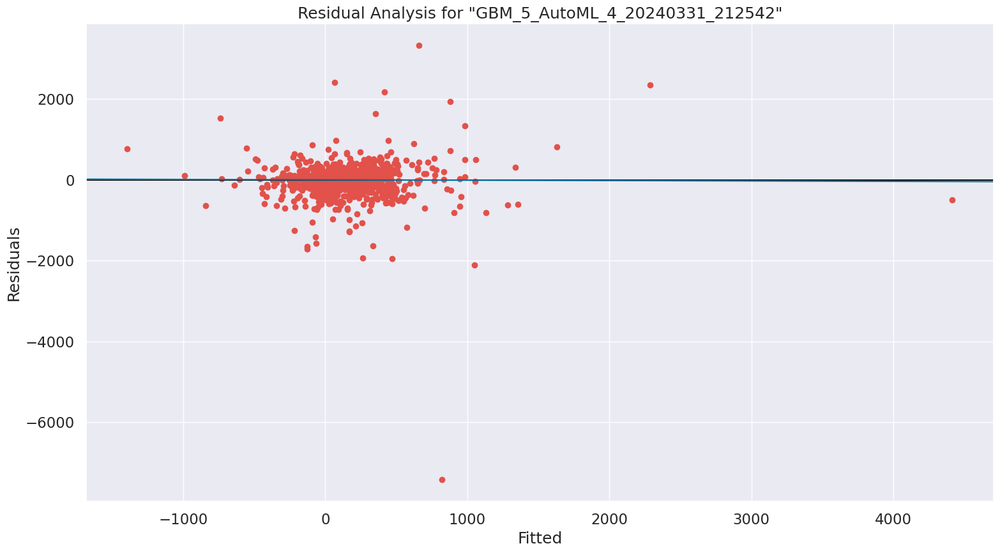

# Learning Curve Plot

> Learning curve plot shows the loss function/metric dependent on number of iterations or trees for tree-based algorithms. This plot can be useful for determining whether the model overfits.

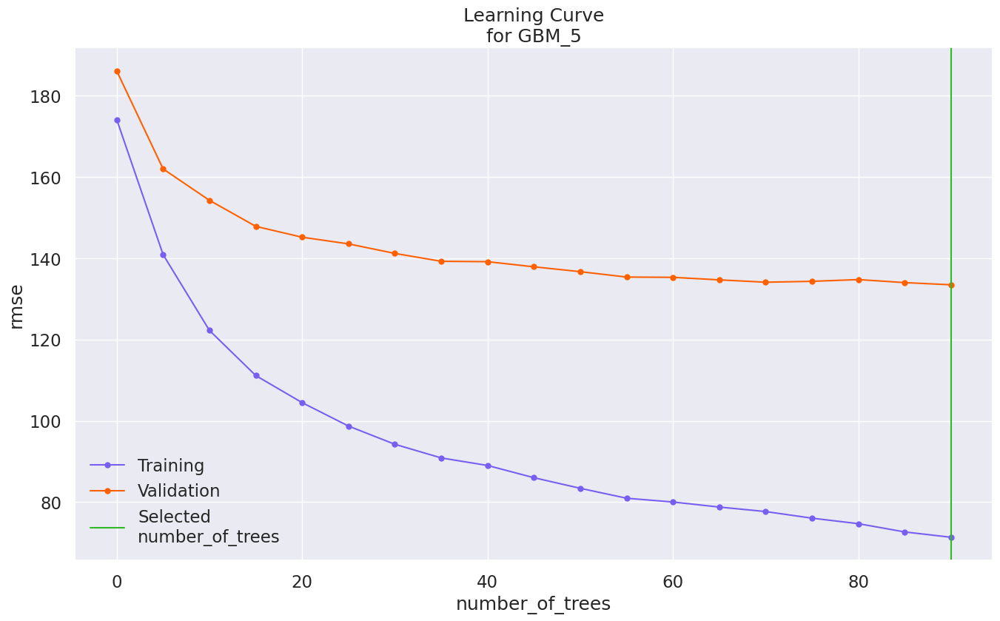

# Variable Importance

> The variable importance plot shows the relative importance of the most important variables in the model.

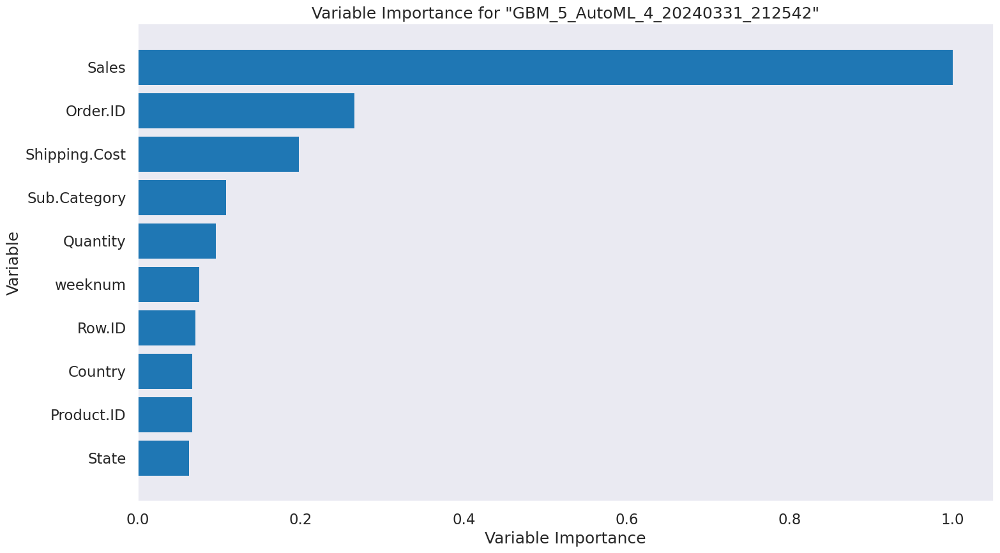

# SHAP Summary

> SHAP summary plot shows the contribution of the features for each instance (row of data). The sum of the feature contributions and the bias term is equal to the raw prediction of the model, i.e., prediction before applying inverse link function.

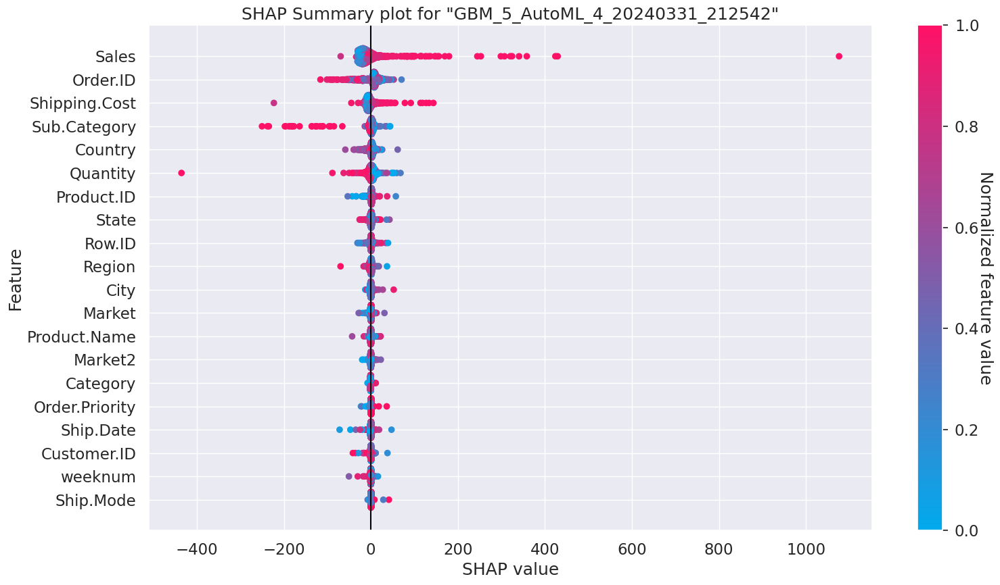

# Partial Dependence Plots

> Partial dependence plot (PDP) gives a graphical depiction of the marginal effect of a variable on the response. The effect of a variable is measured in change in the mean response. PDP assumes independence between the feature for which is the PDP computed and the rest.

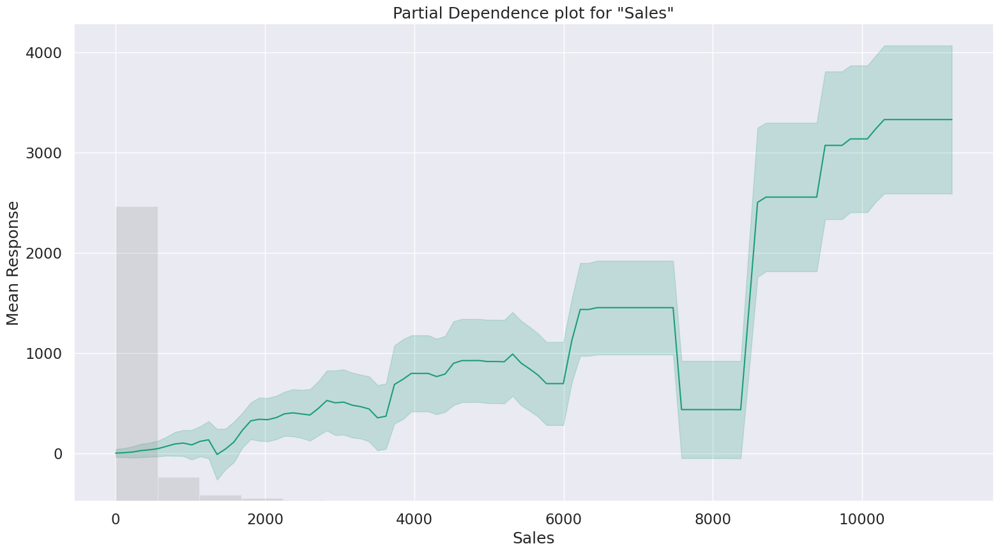

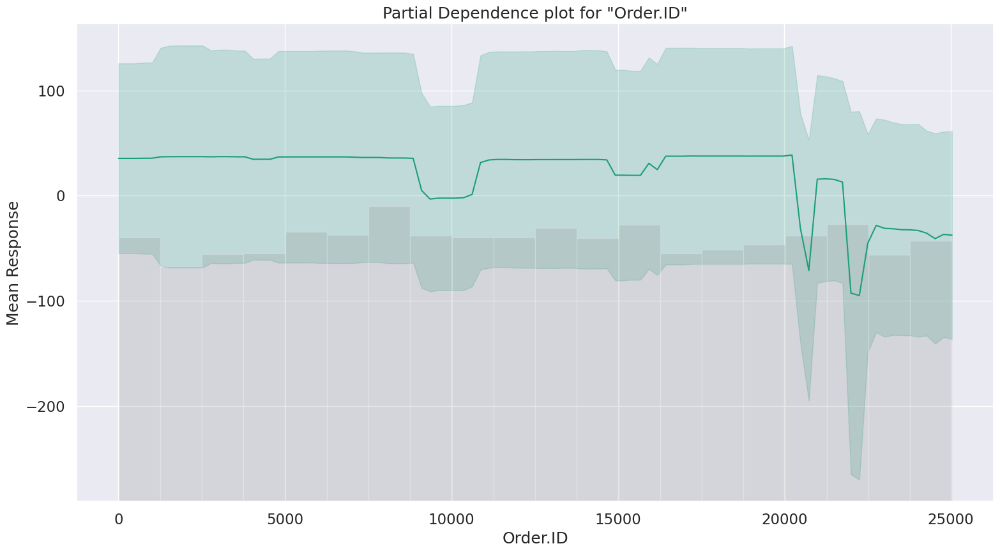

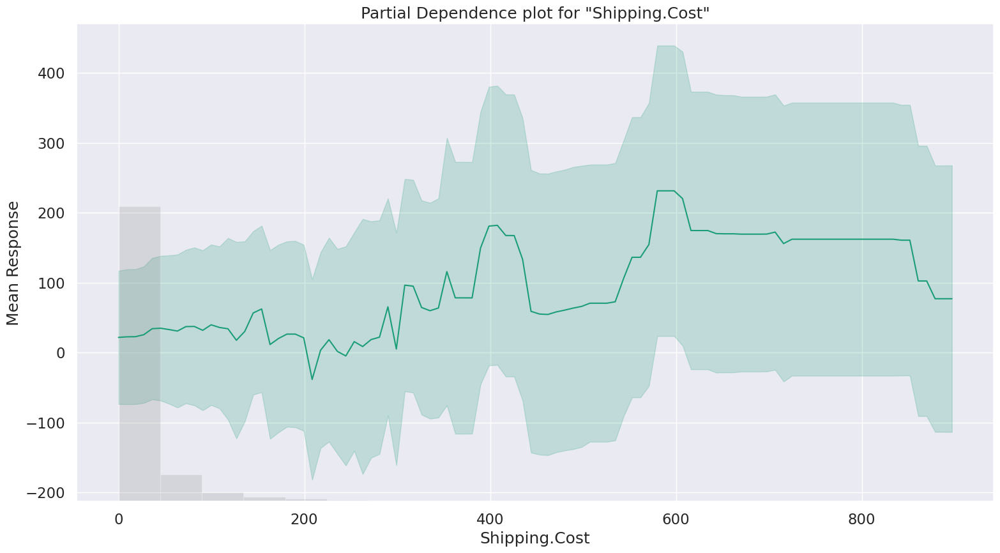

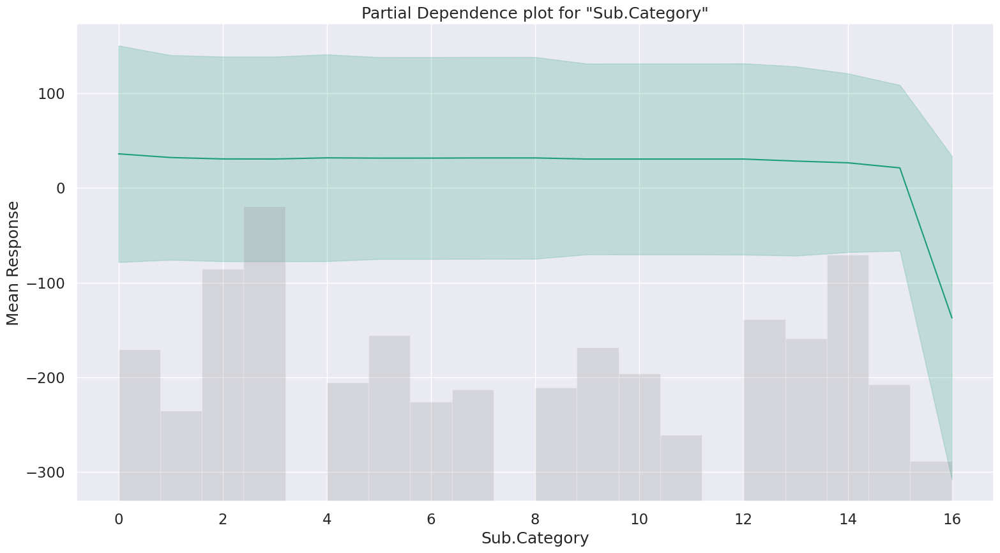

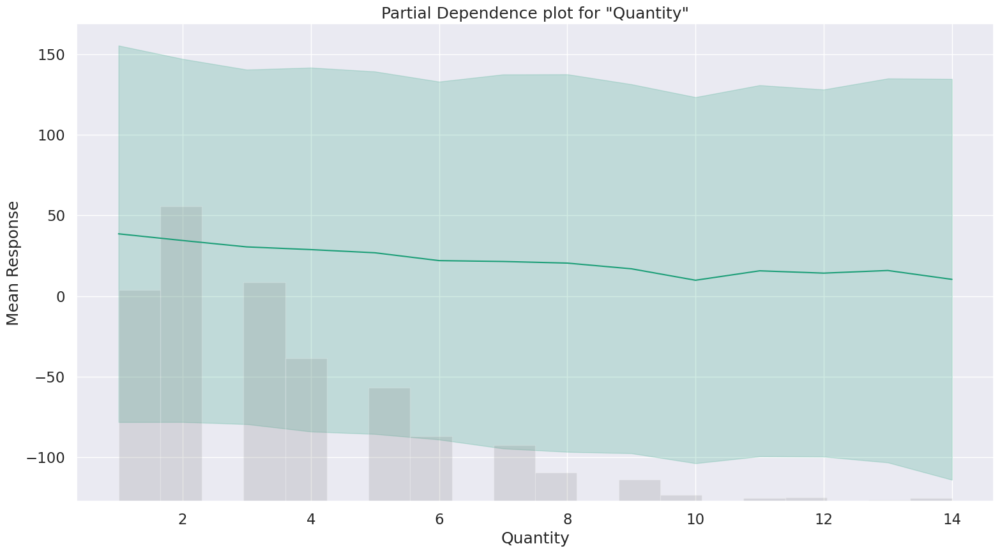

# Individual Conditional Expectation

> An Individual Conditional Expectation (ICE) plot gives a graphical depiction of the marginal effect of a variable on the response. ICE plots are similar to partial dependence plots (PDP); PDP shows the average effect of a feature while ICE plot shows the effect for a single instance. This function will plot the effect for each decile. In contrast to the PDP, ICE plots can provide more insight, especially when there is stronger feature interaction.

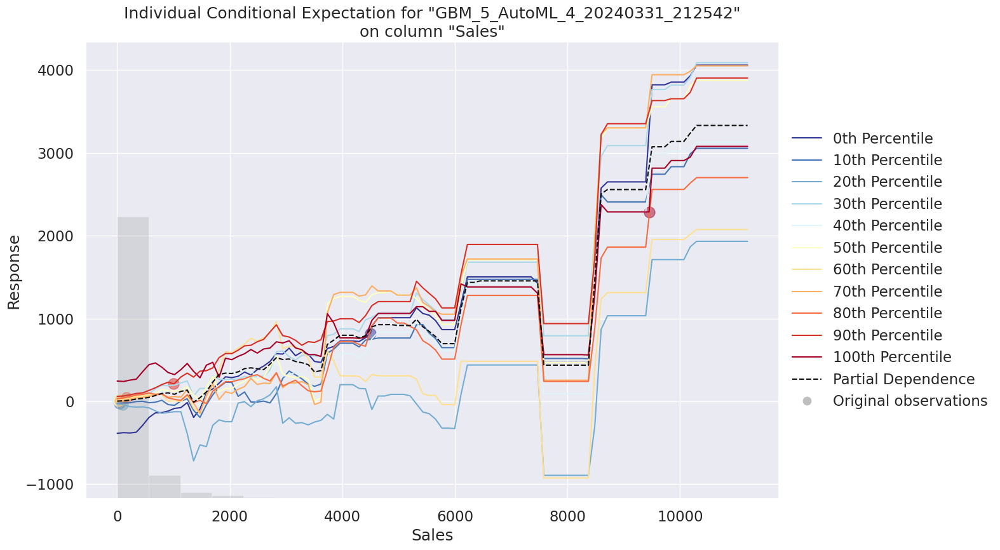

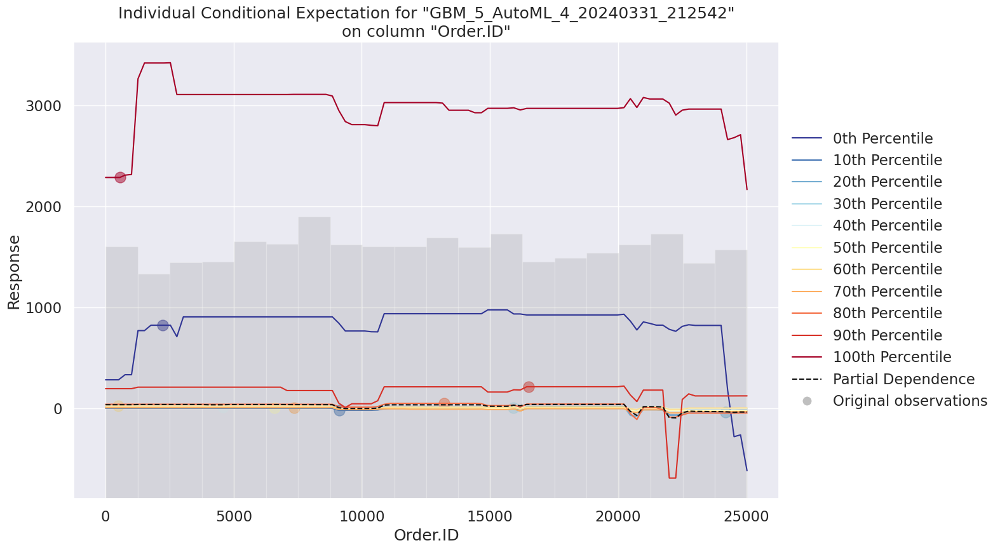

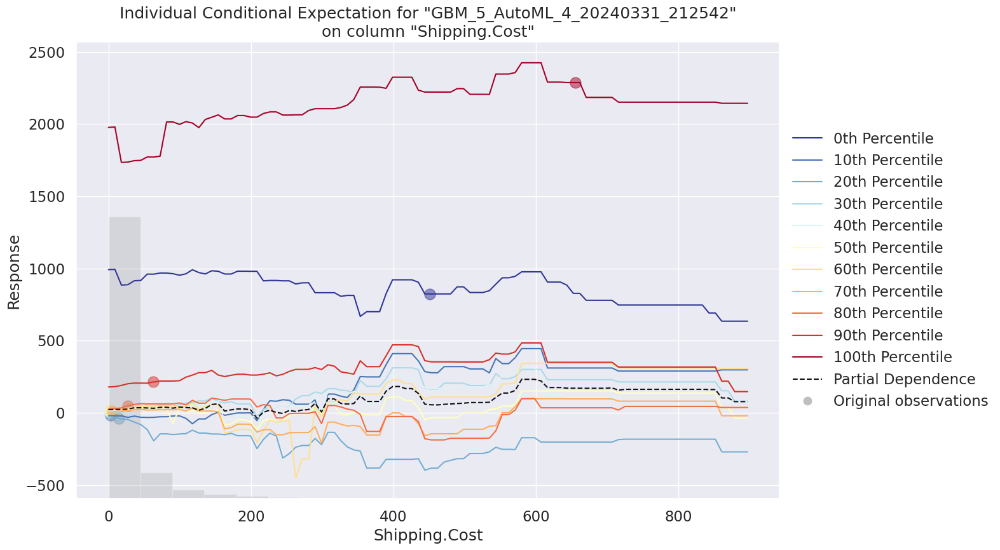

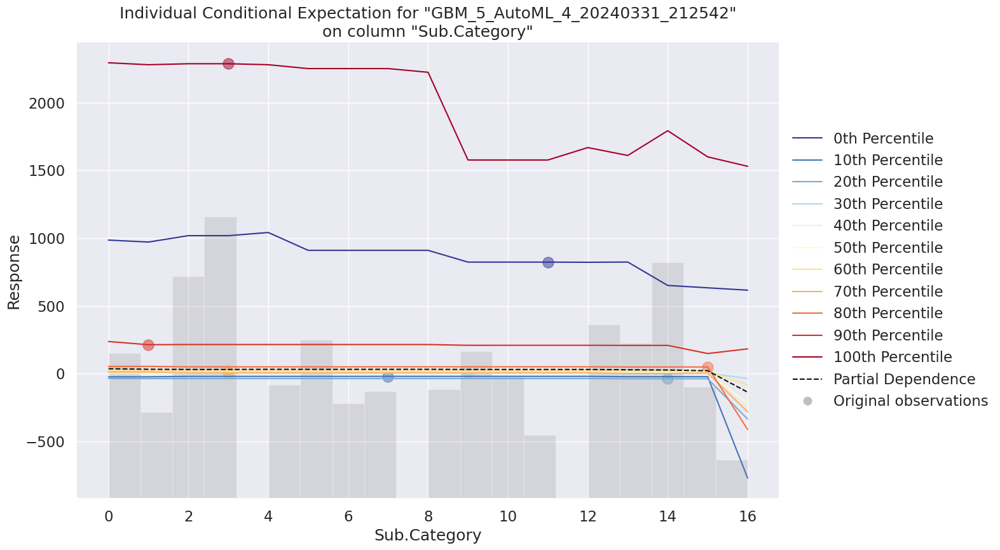

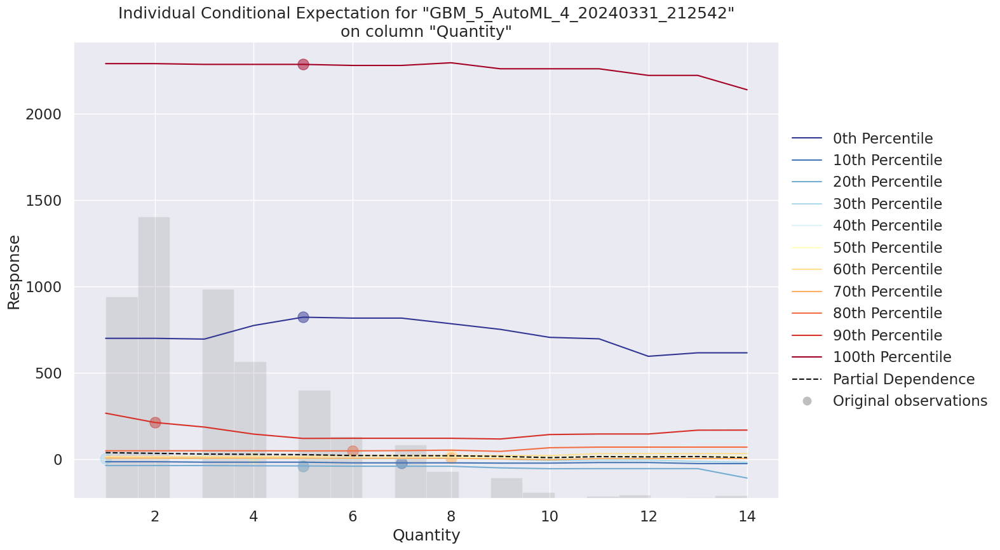

# Residual Analysis

> Residual Analysis plots the fitted values vs residuals on a test dataset. Ideally, residuals should be randomly distributed. Patterns in this plot can indicate potential problems with the model selection, e.g., using simpler model than necessary, not accounting for heteroscedasticity, autocorrelation, etc. Note that if you see "striped" lines of residuals, that is an artifact of having an integer valued (vs a real valued) response variable.

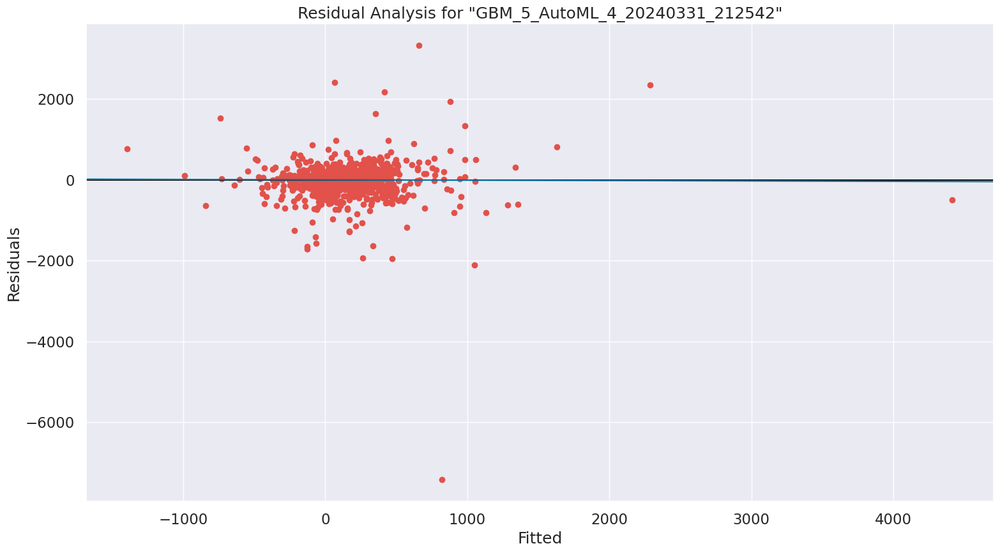

# Learning Curve Plot

> Learning curve plot shows the loss function/metric dependent on number of iterations or trees for tree-based algorithms. This plot can be useful for determining whether the model overfits.

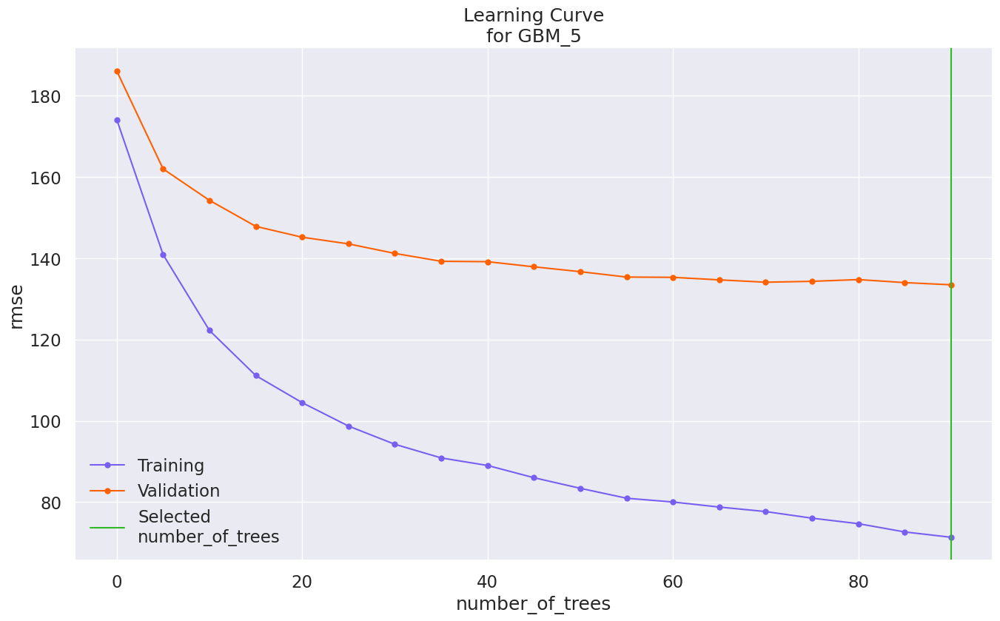

# Variable Importance

> The variable importance plot shows the relative importance of the most important variables in the model.

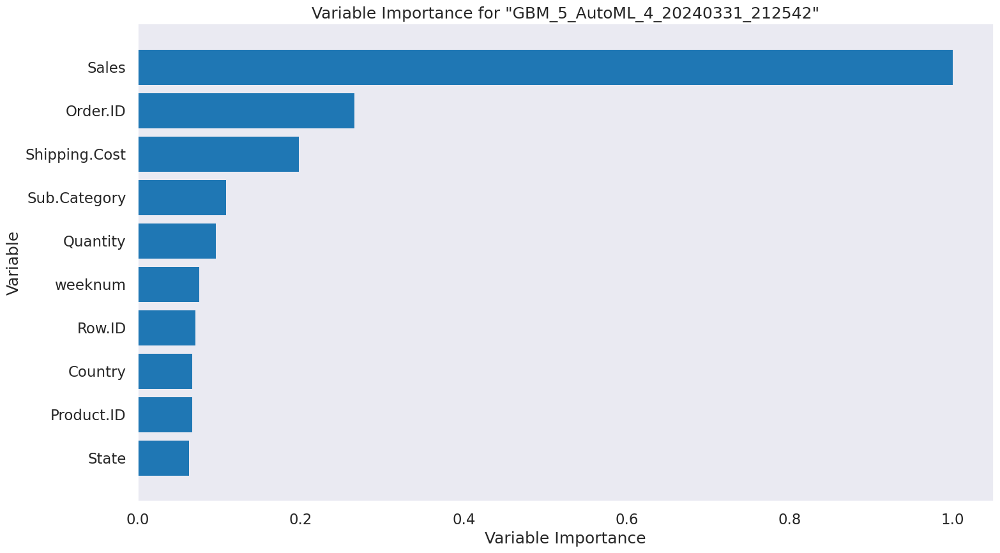

# SHAP Summary

> SHAP summary plot shows the contribution of the features for each instance (row of data). The sum of the feature contributions and the bias term is equal to the raw prediction of the model, i.e., prediction before applying inverse link function.

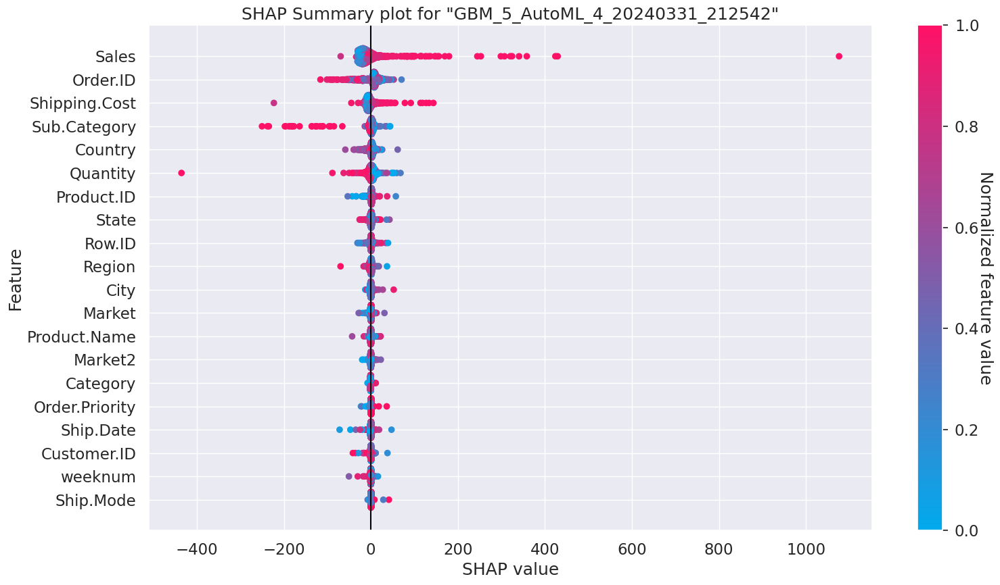

# Partial Dependence Plots

> Partial dependence plot (PDP) gives a graphical depiction of the marginal effect of a variable on the response. The effect of a variable is measured in change in the mean response. PDP assumes independence between the feature for which is the PDP computed and the rest.

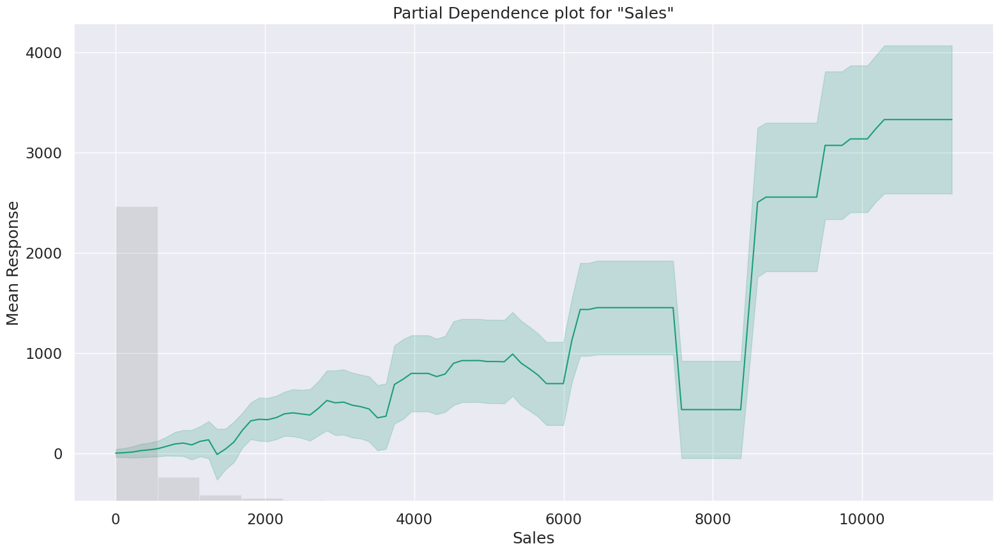

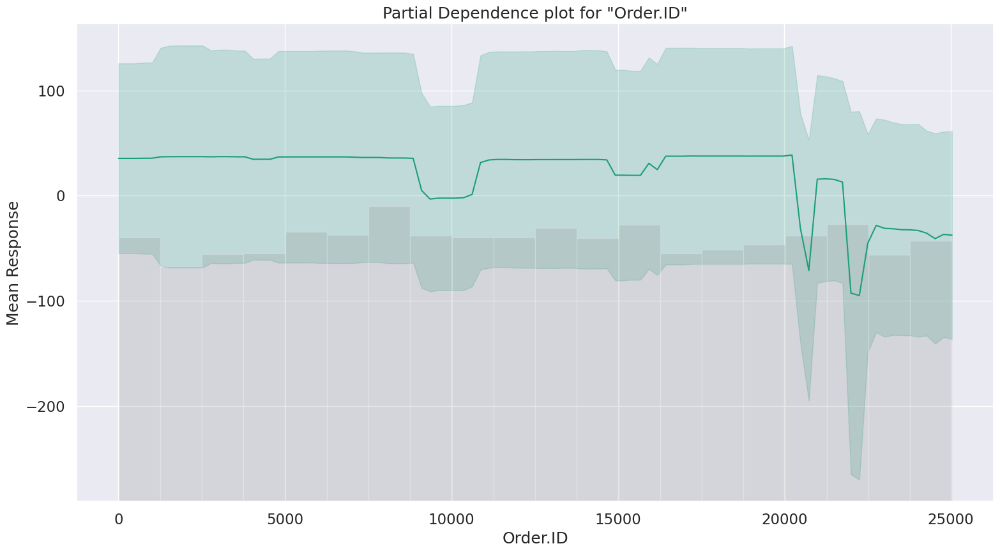

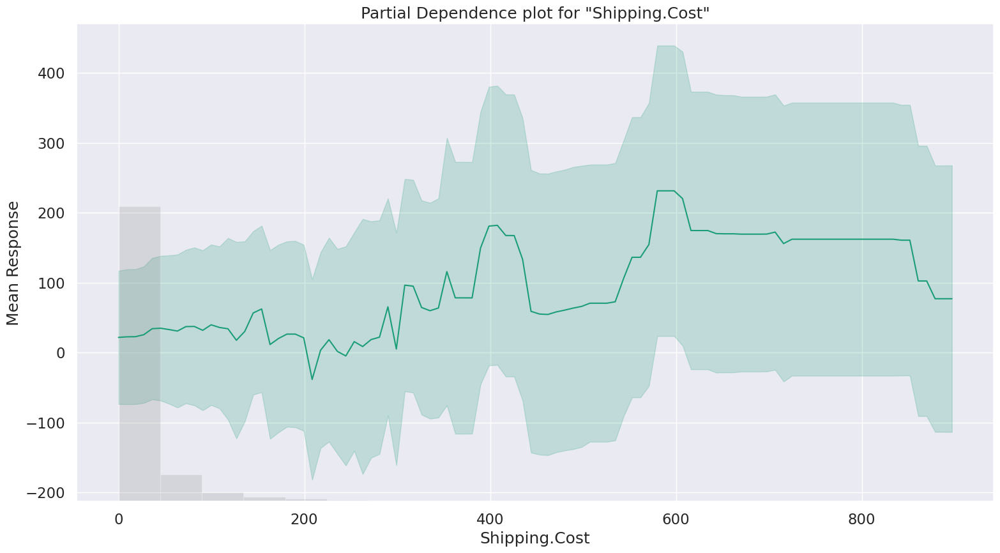

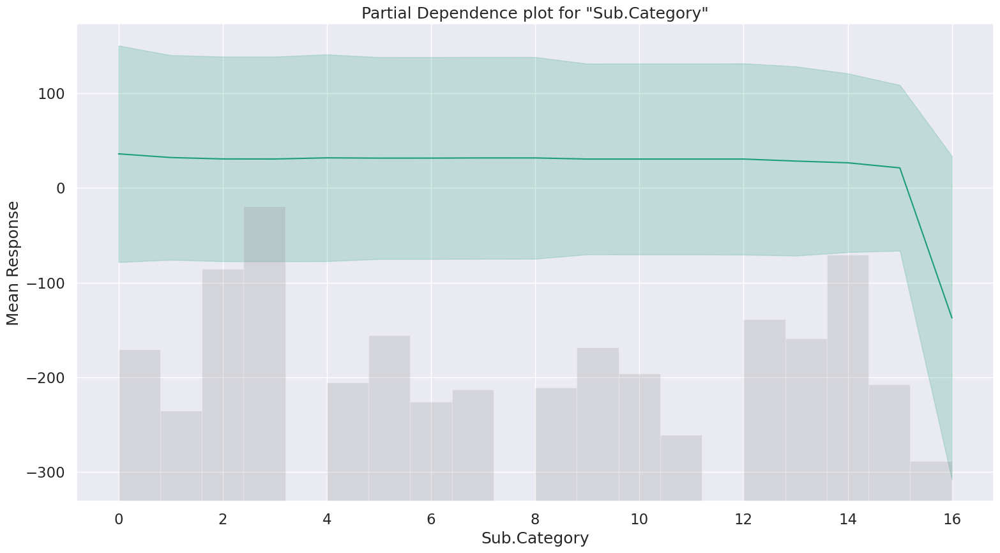

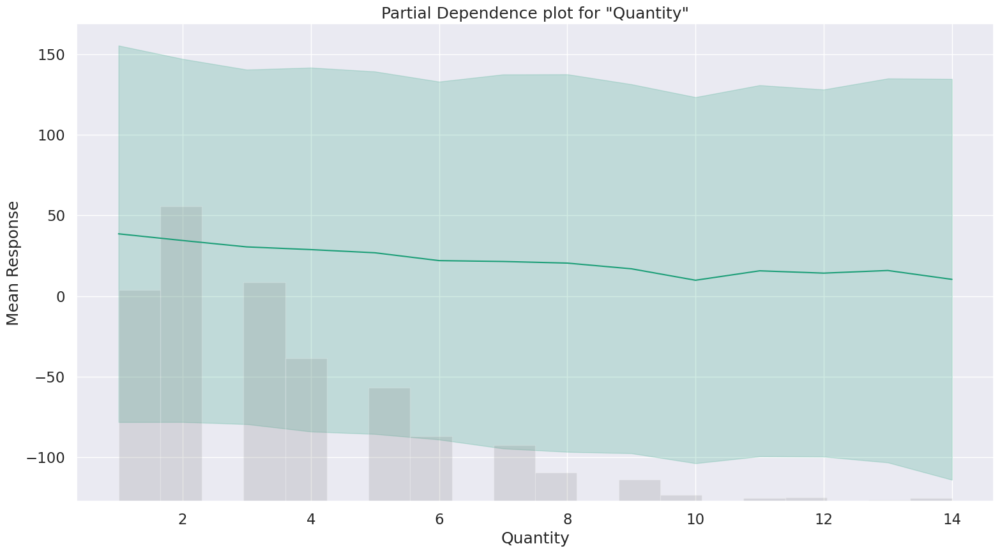

# Individual Conditional Expectation

> An Individual Conditional Expectation (ICE) plot gives a graphical depiction of the marginal effect of a variable on the response. ICE plots are similar to partial dependence plots (PDP); PDP shows the average effect of a feature while ICE plot shows the effect for a single instance. This function will plot the effect for each decile. In contrast to the PDP, ICE plots can provide more insight, especially when there is stronger feature interaction.

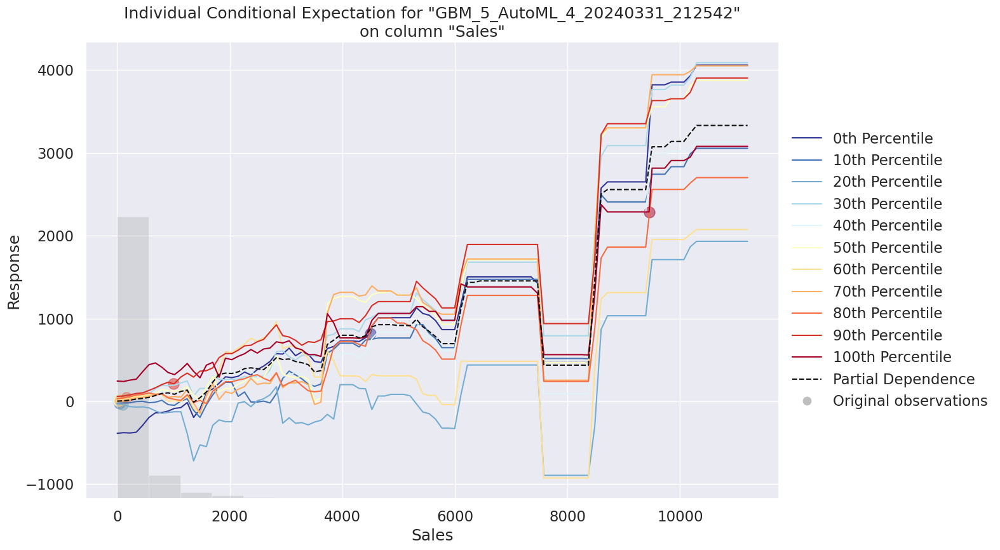

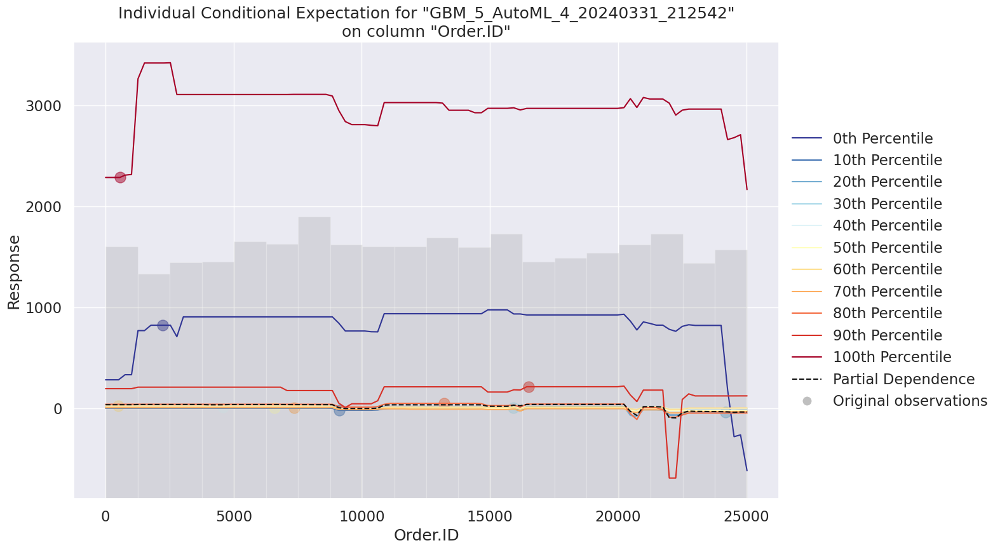

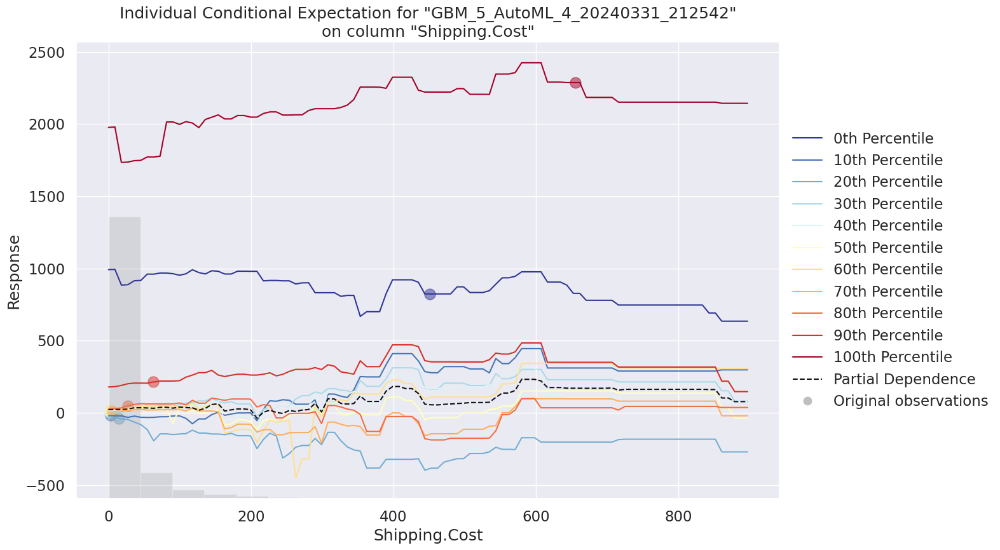

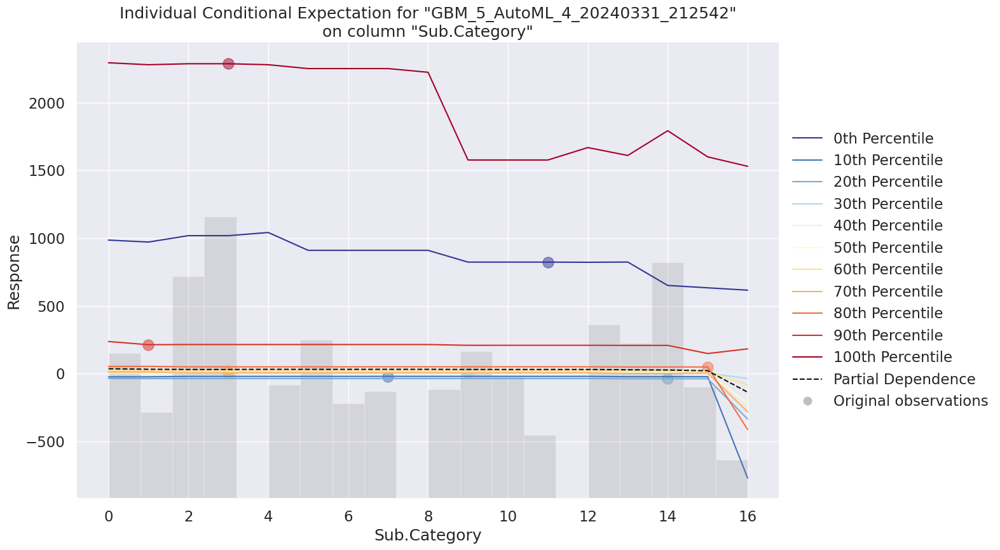

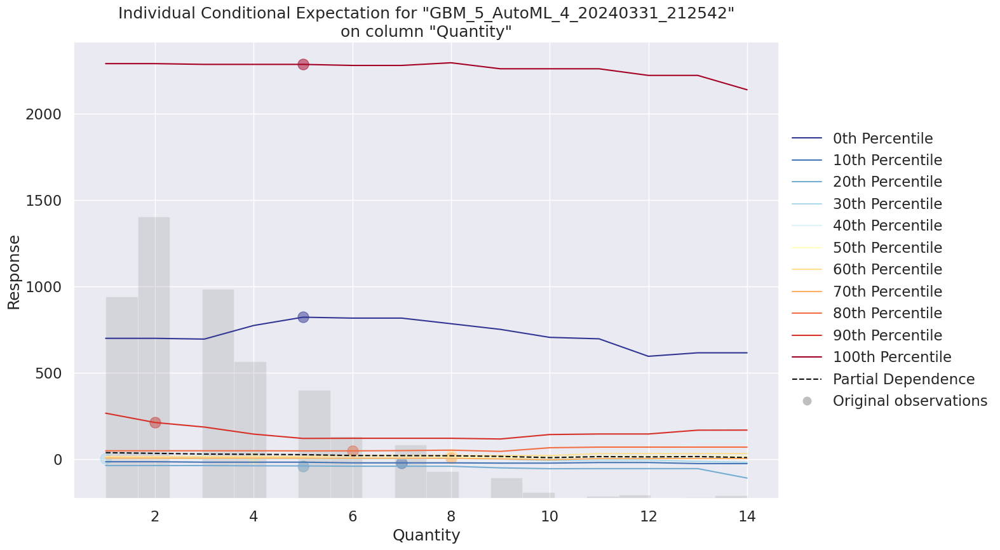

In [127]:
# AutoML Explainability
autoML_model.explain(autoML[1])

## LIME (Local Interpretation Model-Agnostic Explanation) Analysis

### Linear Model

In [175]:
# Initializing LIME explainer for Linear Model
lime_linear_explainer = lime_tabular.LimeTabularExplainer(
    training_data=np.array(x_train), feature_names=x_train.columns, mode="regression"
)

In [176]:
# Getting LIME interpretation for a sample data
idx = 18
np_x_test = np.array(x_test)
np_y_test = np.array(y_test)
print("Prediction : ", linear_model.predict(np_x_test[0].reshape(1, -1)))
print("Actual :     ", np_y_test[idx])

lime_linear_explanation = lime_linear_explainer.explain_instance(
    np_x_test[idx], linear_model.predict, num_features=np_x_test.shape[1]
)
lime_linear_explanation

Prediction :  [17.76329229]
Actual :      11


In [177]:
lime_linear_explanation.show_in_notebook()

In the LIME analysis of linear model, we can conclude that variables like Quantity, Sub.Category has positive impact and Sales has negative impact in predicting the target variable

### Tree Based Model

In [178]:
# Initializing LIME explainer for Tree Based Model
lime_tree_explainer = lime_tabular.LimeTabularExplainer(
    training_data=np.array(x_train), feature_names=x_train.columns, mode="regression"
)

In [179]:
# Getting LIME interpretation for a sample data
idx = 18
np_x_test = np.array(x_test)
np_y_test = np.array(y_test)
print("Prediction : ", tree_model.predict(np_x_test[0].reshape(1, -1)))
print("Actual :     ", np_y_test[idx])

lime_tree_explanation = lime_linear_explainer.explain_instance(
    np_x_test[idx], tree_model.predict, num_features=np_x_test.shape[1]
)
lime_tree_explanation

Prediction :  [6.41431731]
Actual :      11


In [180]:
lime_tree_explanation.show_in_notebook()

In the LIME analysis of tree based model, we can conclude that variables like Market2, Sub.Category has positive impact and Sales has negative impact in predicting the target variable

## Partial Dependence Plot

### Linear Model

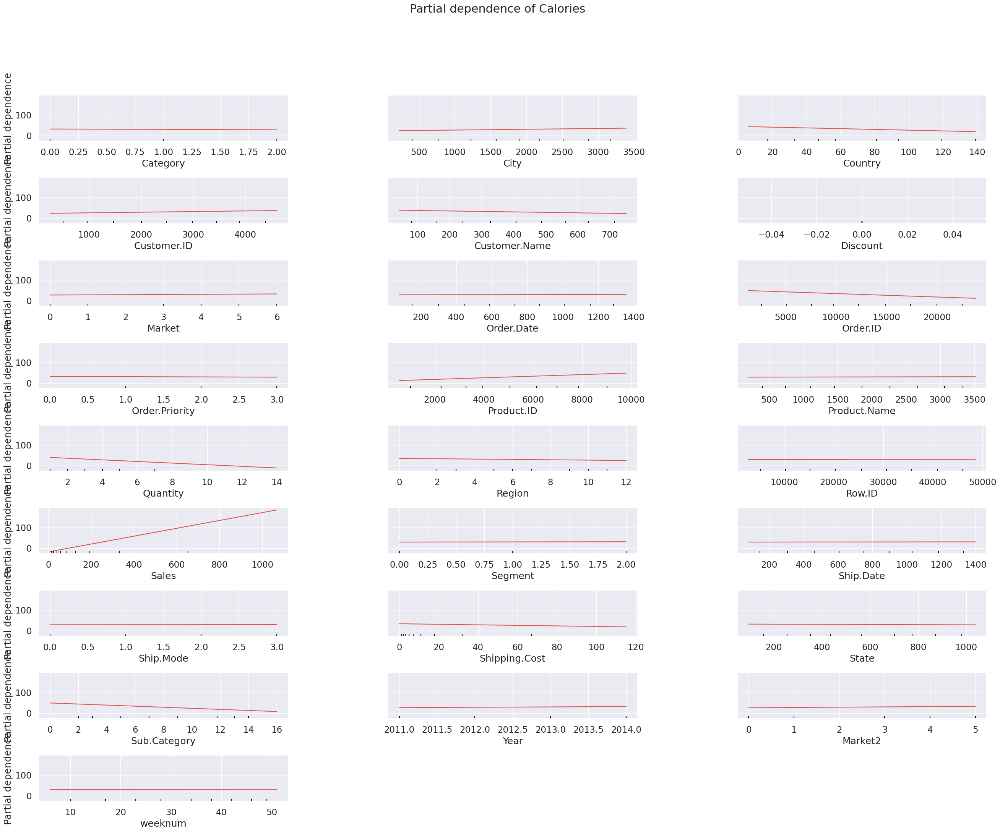

In [132]:
# PDP Plot for Linear Model
PartialDependenceDisplay.from_estimator(linear_model, x_test, x_test.columns, n_jobs=3, grid_resolution=20)

fig = plt.gcf()
fig.suptitle("Partial dependence of Calories")
fig.subplots_adjust(wspace=0.4, hspace=0.8)
plt.show()
plt.rcParams["figure.figsize"] = (32, 24)

In the PDP analysis of linear model, the features with straight lines indicate that they have no significant contribution in predicting the target variable. Slant lines represent that they are in a linear relationship with the target variable.

### Tree Based Model

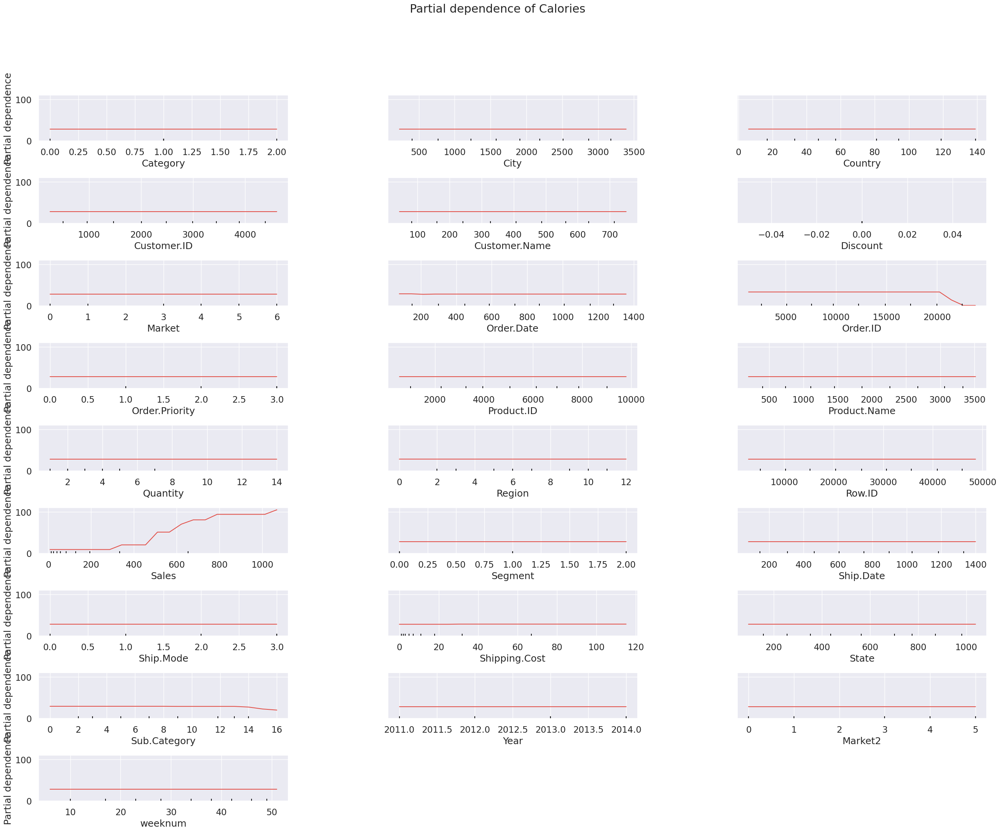

In [133]:
# PDP Plot for Tree based Model
PartialDependenceDisplay.from_estimator(tree_model, x_test, x_test.columns, n_jobs=3, grid_resolution=20)

fig = plt.gcf()
fig.suptitle("Partial dependence of Calories")
fig.subplots_adjust(wspace=0.4, hspace=0.8)
plt.show()
plt.rcParams["figure.figsize"] = (32, 24)

In the PDP analysis of tree based model, the features with straight lines indicate that they have no significant contribution in predicting the target variable. Slant lines represent that they are in a linear relationship with the target variable.

## SHAP Analysis

### Linear Model

Here the x-axis is the feature and the y-axis is the output as we vary the feature. The grey histogram is the distribution of variables in the dataset and the cross made by E[Feature], E[f(x)] is the expected values.

Let us consider a feature 'Sales'

For Linear Model, the cross is made at approc E[f(x)] which is slightly below 0

In [172]:
# SHAP analysis of Linear Model
linear_explainer = shap.Explainer(linear_model.predict, x_train_100)
linear_shap_values = linear_explainer(x_train)

PermutationExplainer explainer: 46162it [44:06, 17.42it/s]                           


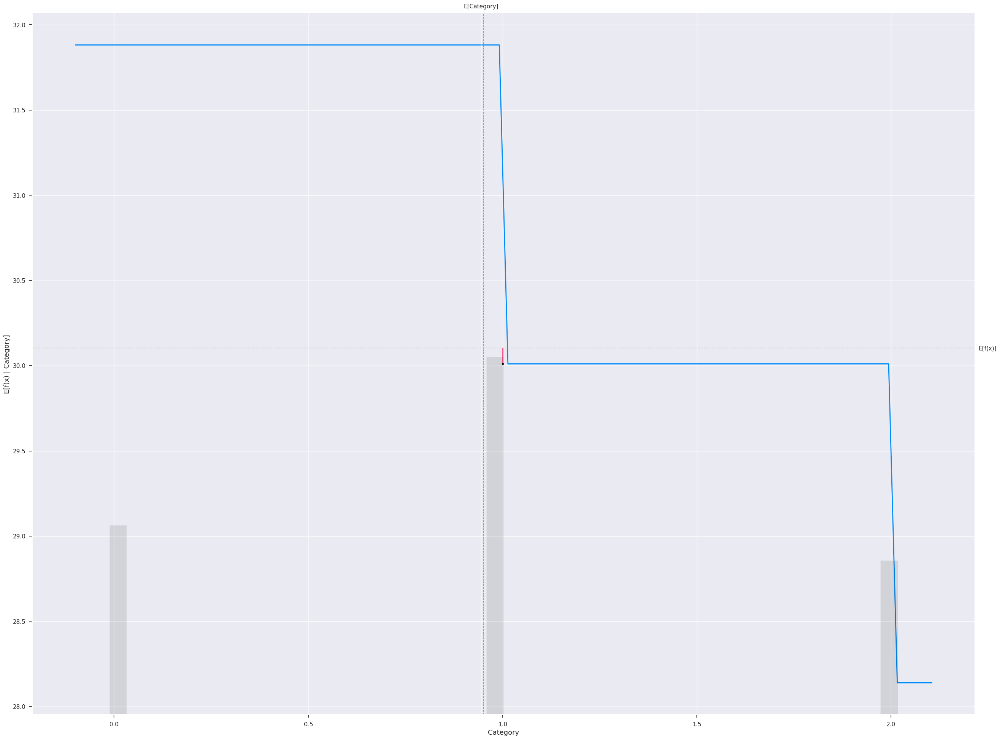

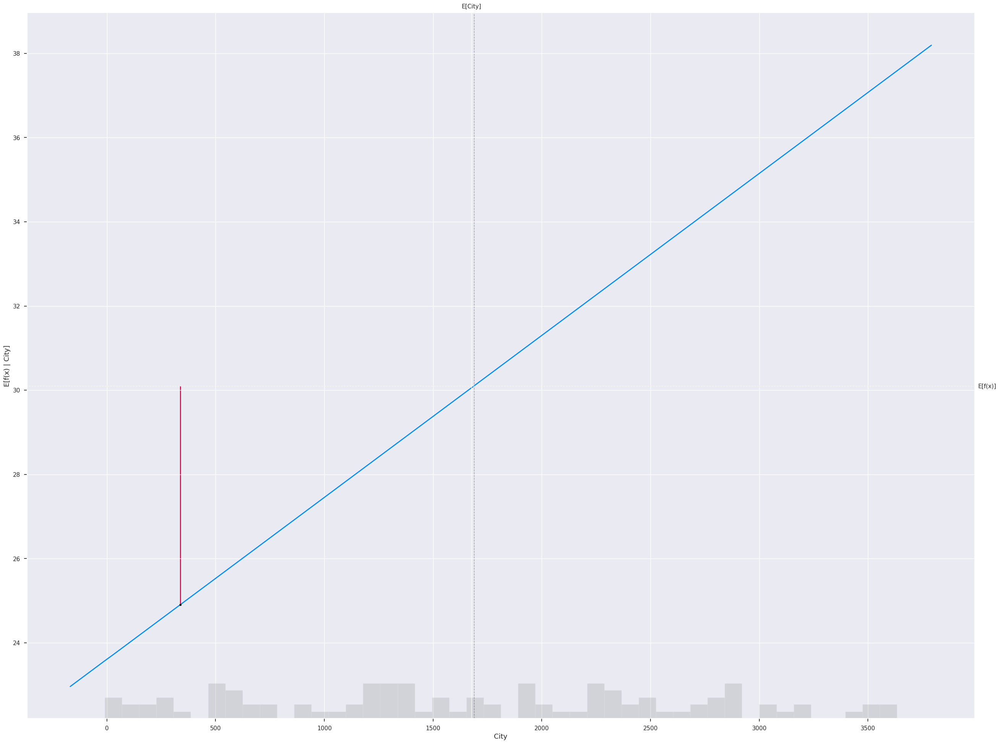

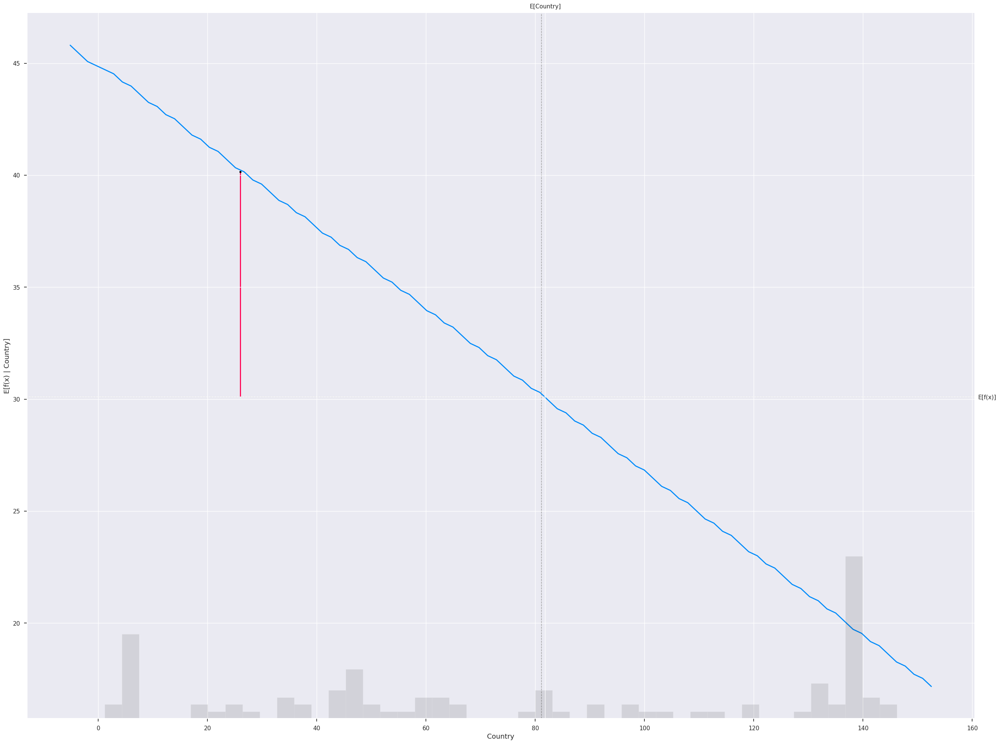

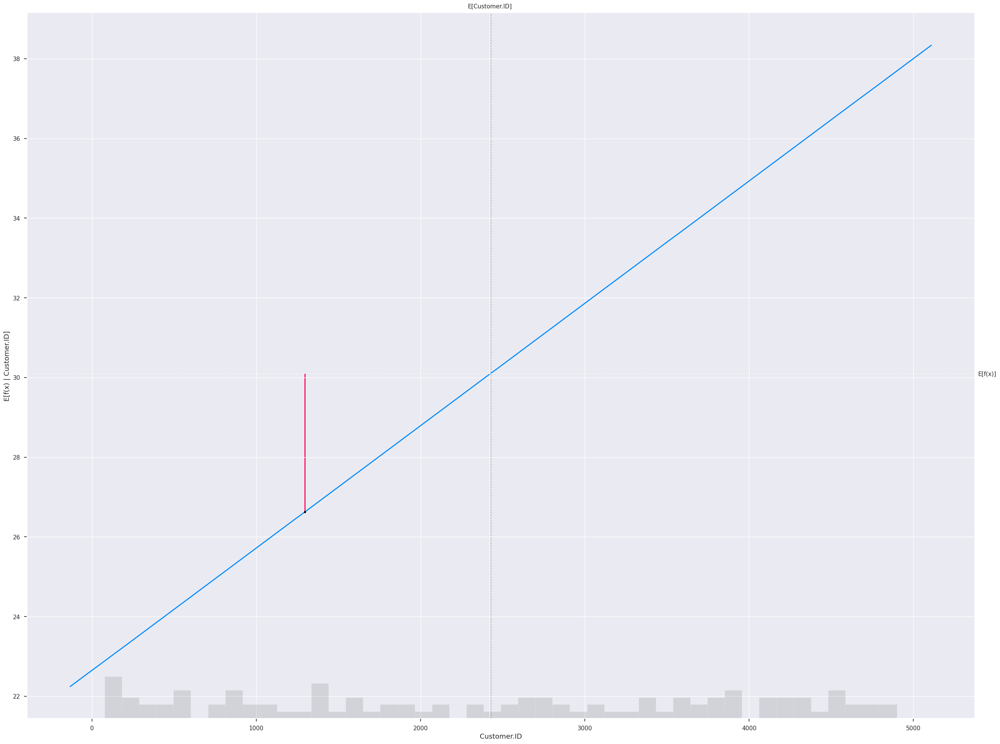

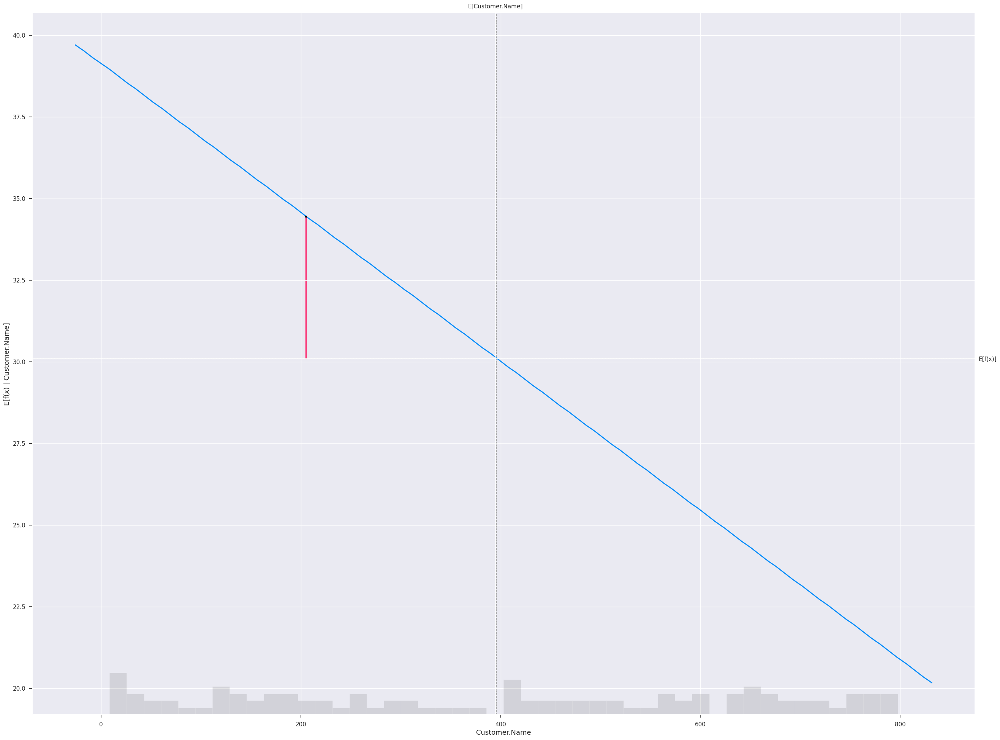

...

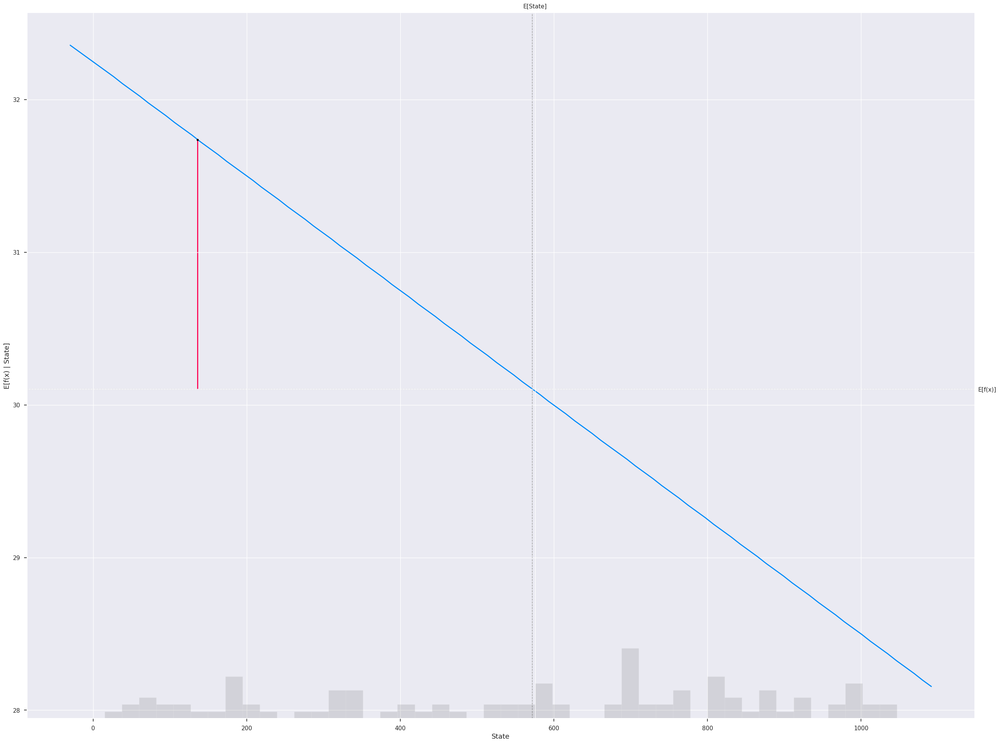

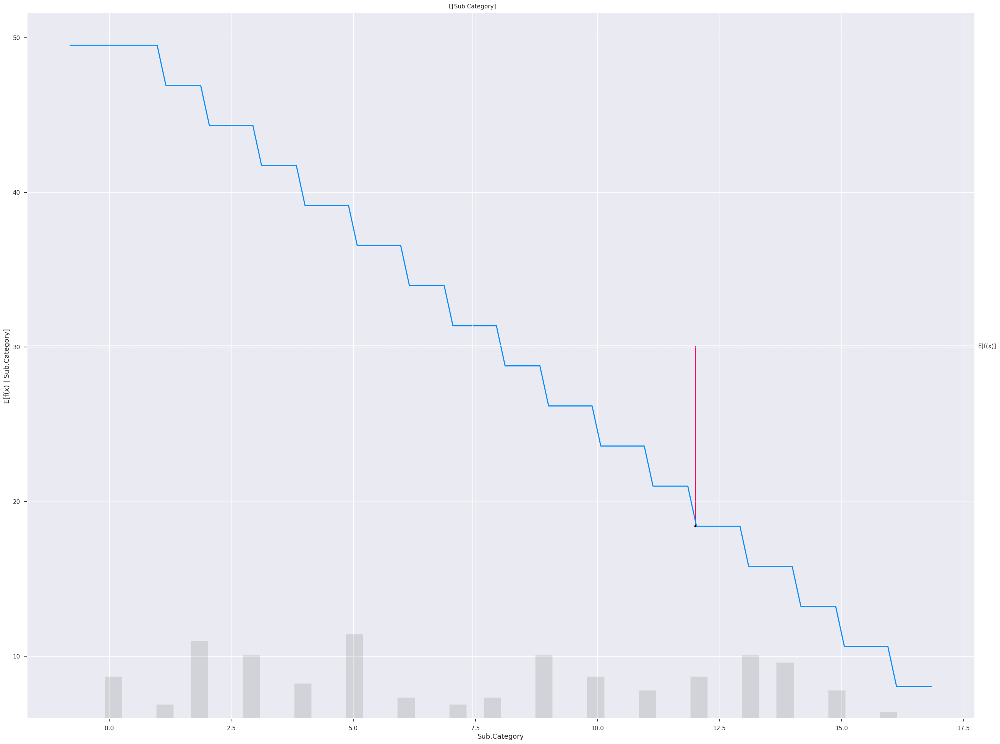

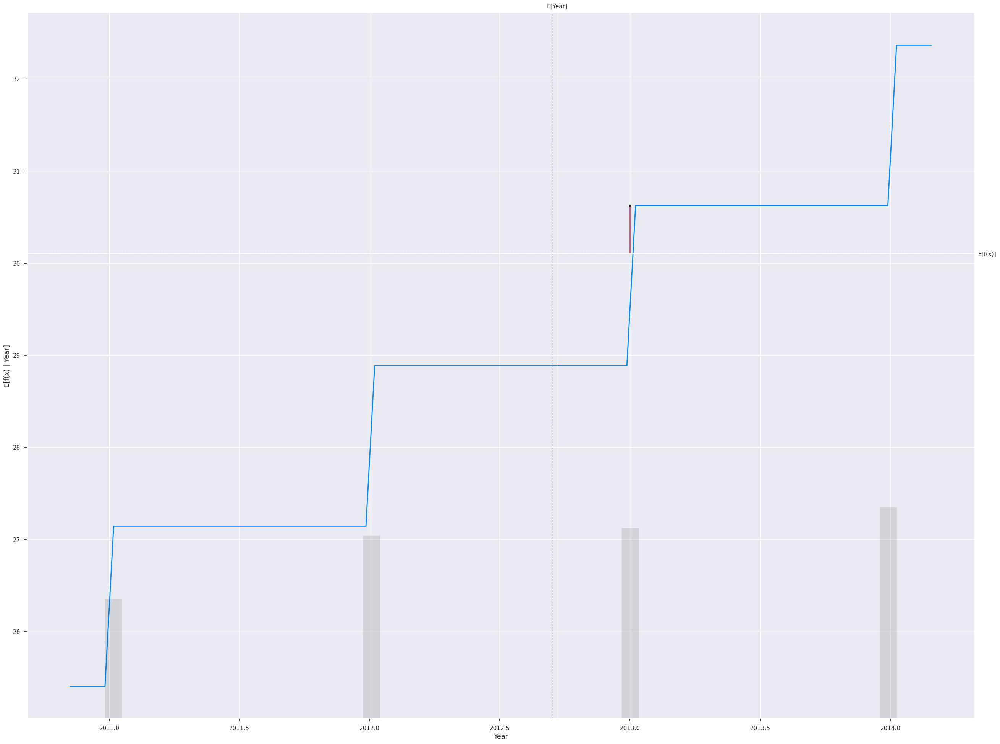

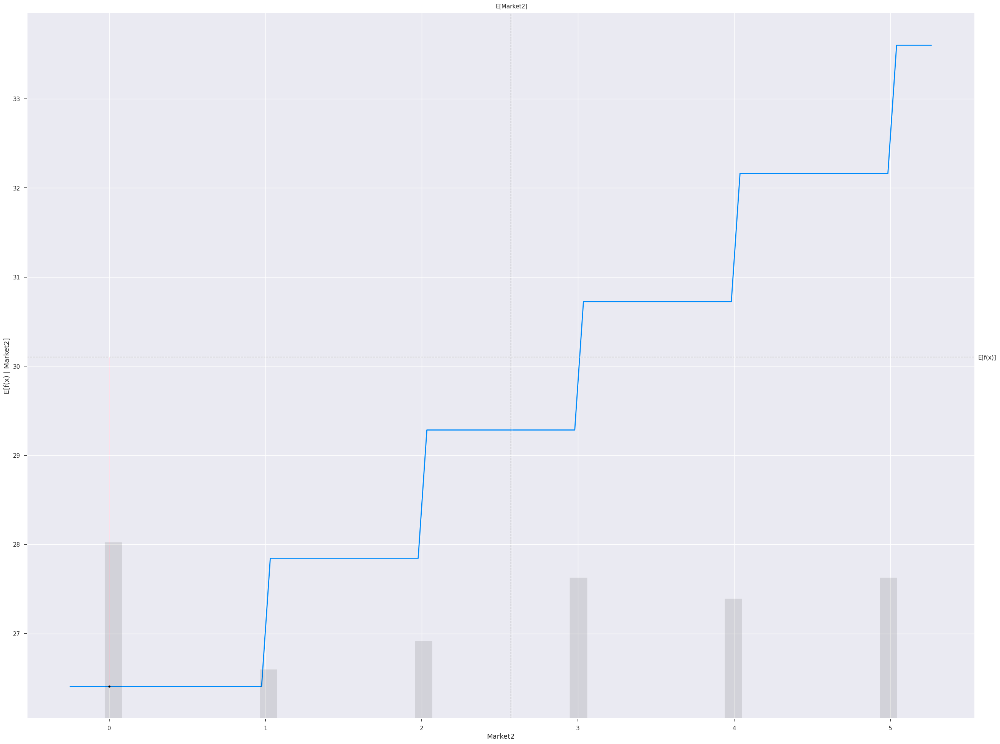

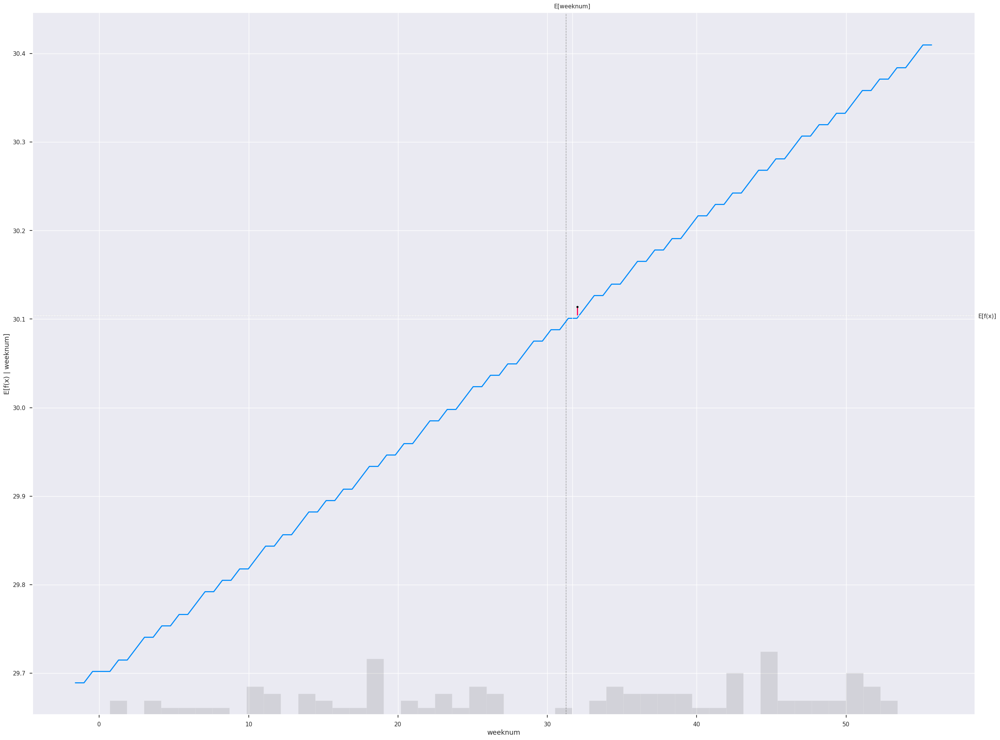

In [135]:
for i in x_train.columns:
     # Standard Partial Dependence Plot
     sample_ind = 18
     shap.partial_dependence_plot(
         i,
         linear_model.predict,
         x_train_100,
         model_expected_value=True,
         feature_expected_value=True,
         ice=False,
         shap_values=linear_shap_values[sample_ind : sample_ind+1, :],
    )

### Tree Based Model

Here the x-axis is the feature and the y-axis is the output as we vary the feature. The grey histogram is the distribution of variables in the dataset and the cross made by E[Feature], E[f(x)] is the expected values.

Let us consider a feature 'Sales'

For Tree Based Model, the cross is made at approc E[f(x)] which is around 10-20

In [136]:
# Shap analysis of a tree based model
tree_explainer = shap.Explainer(tree_model.predict, x_train_100)
tree_shap_values = tree_explainer(x_train)

PermutationExplainer explainer: 46162it [45:15, 16.93it/s]


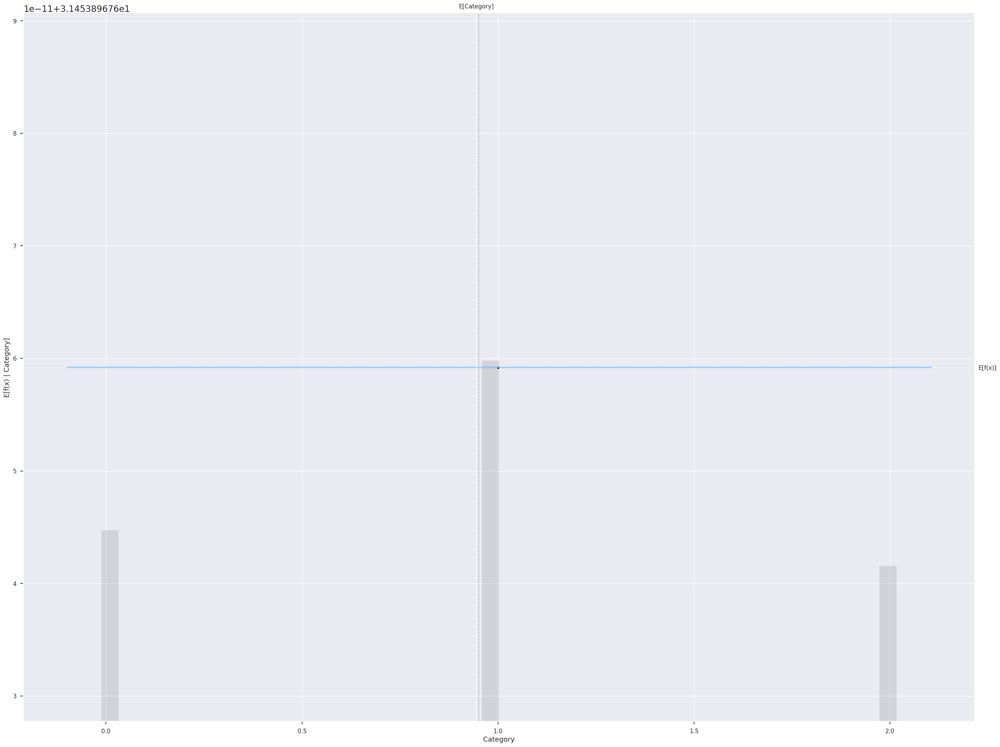

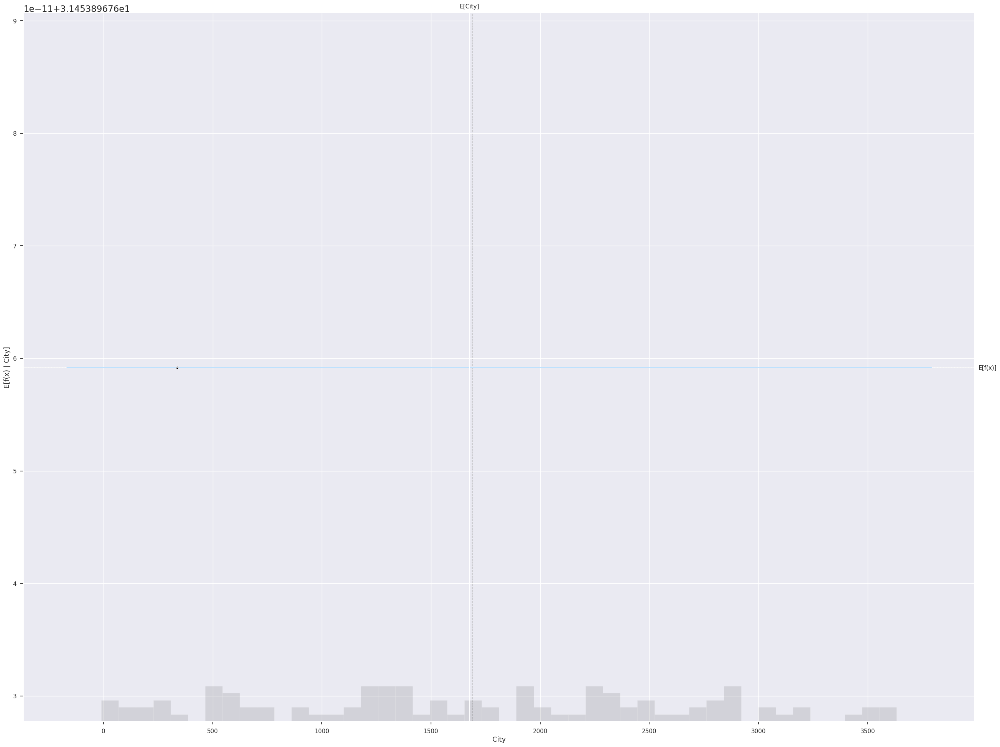

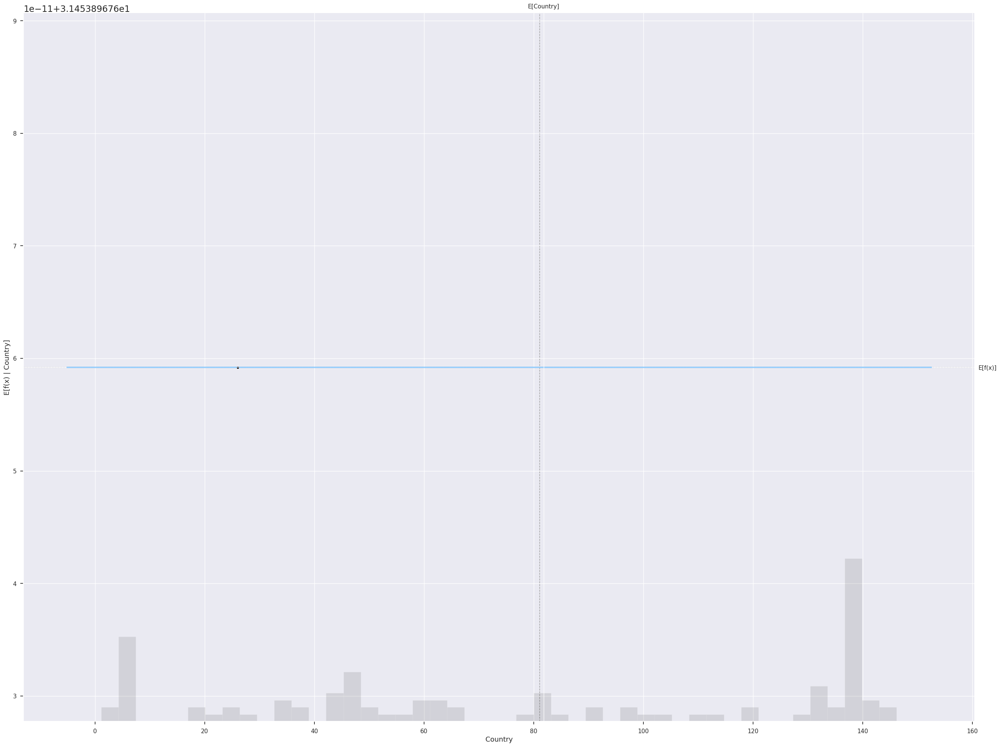

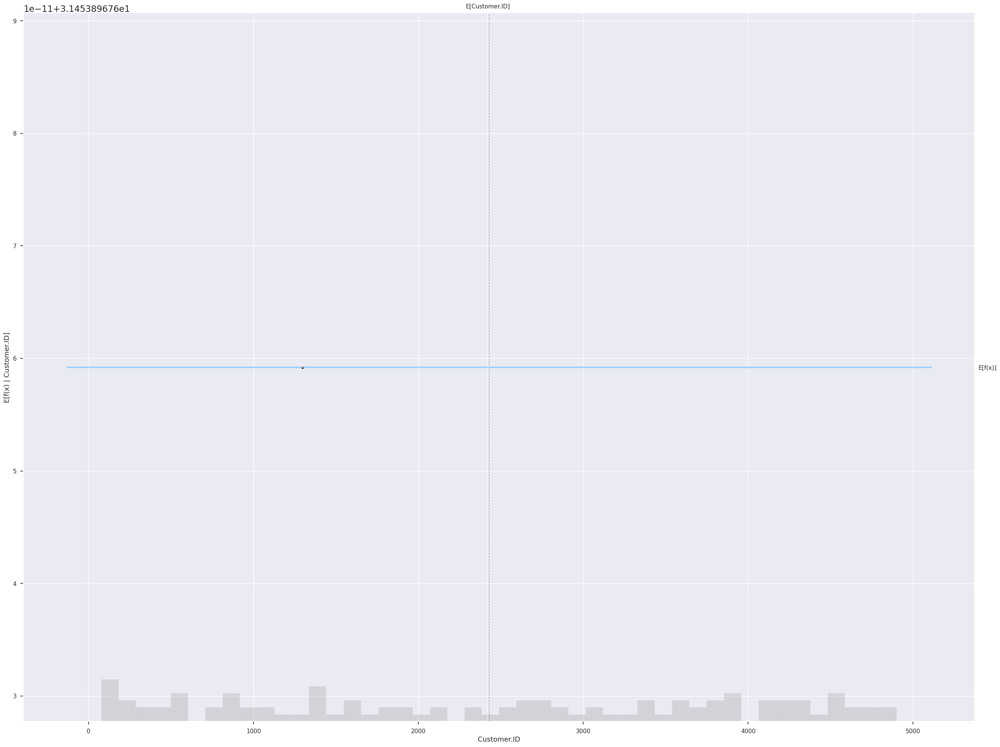

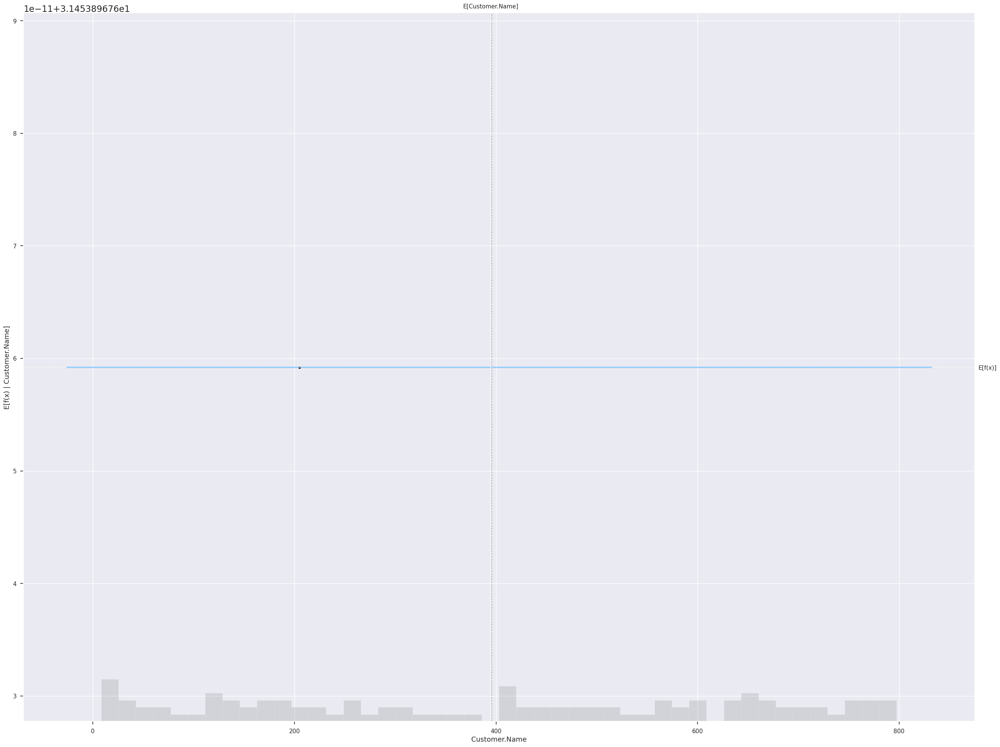

...

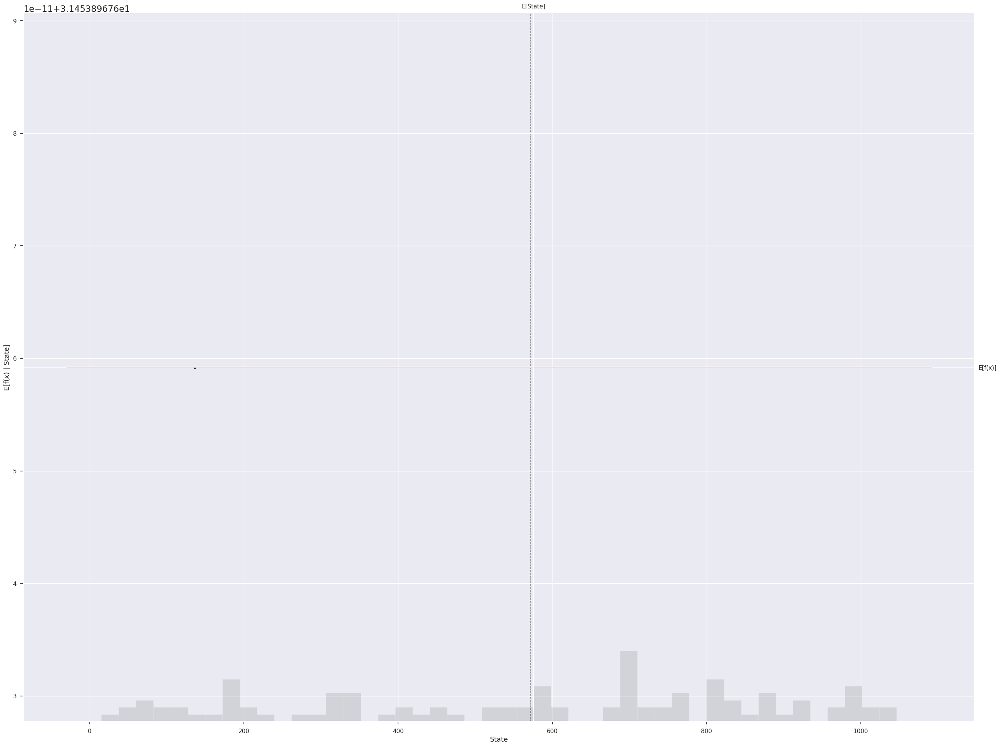

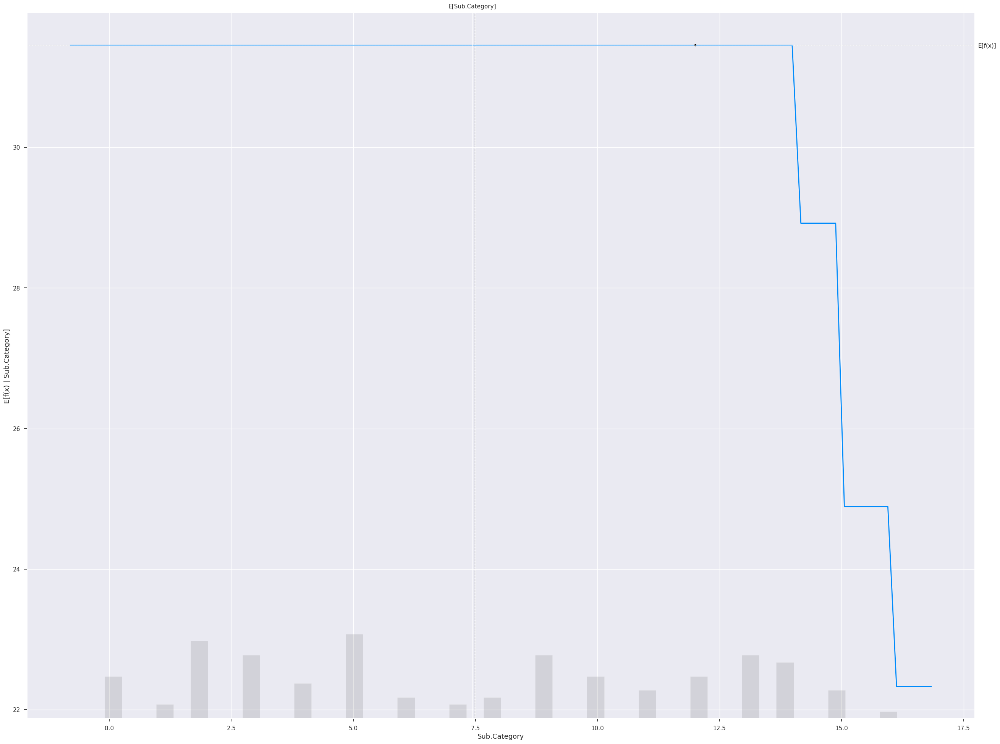

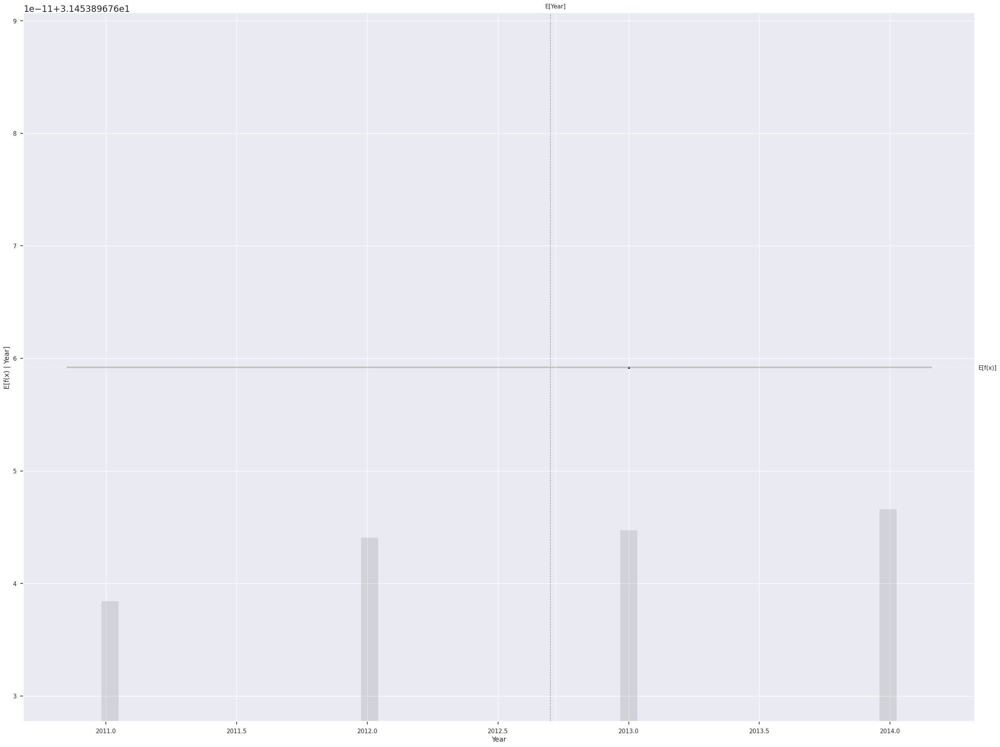

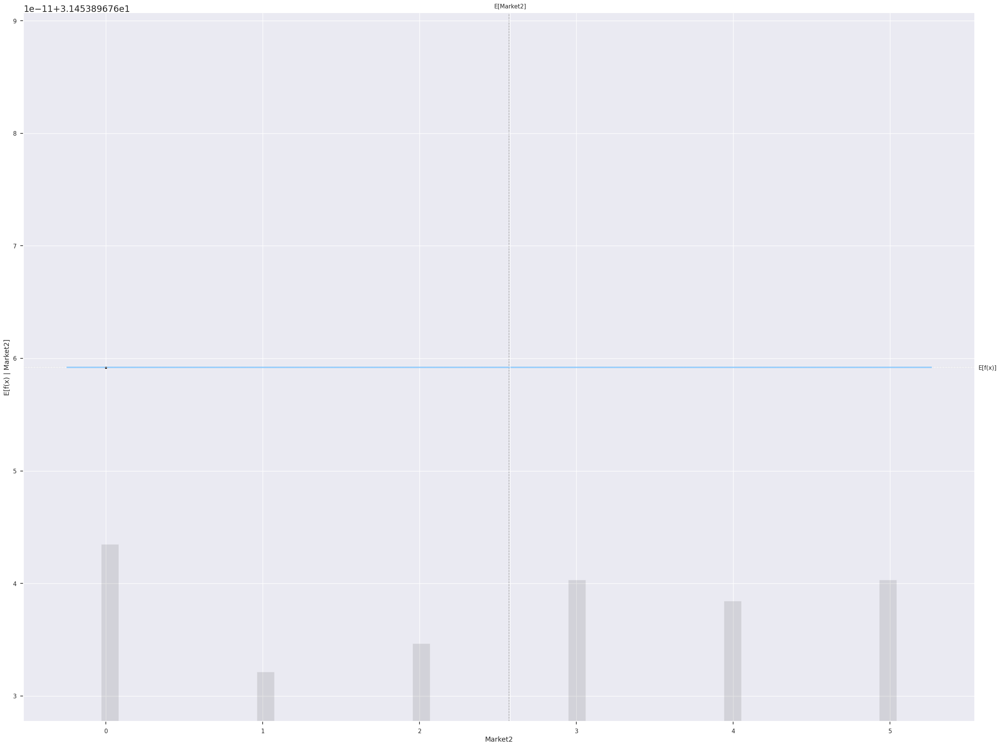

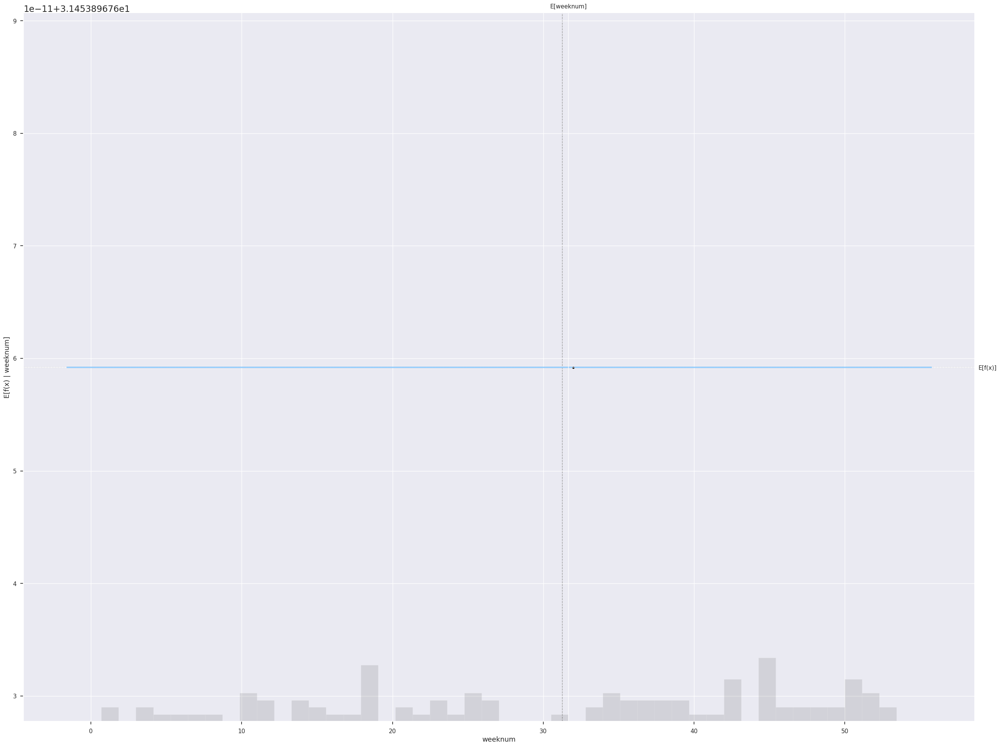

In [137]:
for i in x_train.columns:
     # Standard Partial Dependence Plot
     sample_ind = 18
     shap.partial_dependence_plot(
         i,
         tree_model.predict,
         x_train_100,
         model_expected_value=True,
         feature_expected_value=True,
         ice=False,
         shap_values=tree_shap_values[sample_ind : sample_ind+1, : ],
     )

## Interpreting SHAP Feature Importance


It measures the importance of each feature in a model by looking at the magnitude of their corresponding Shapley values. To obtain a global measure of feature importance, the absolute Shapley values are averaged across all data points. The resulting values are then sorted in descending order and plotted to display the relative importance of each feature.

The SHAP feature importance plots for a linear model and a tree-based model demonstrate that there are differences in the feature importance rankings between the two types of models. This suggests that the relative importance of different features may vary depending on the modeling approach used, and that SHAP analysis can provide valuable insights into the factors driving model predictions.

### Linear Model

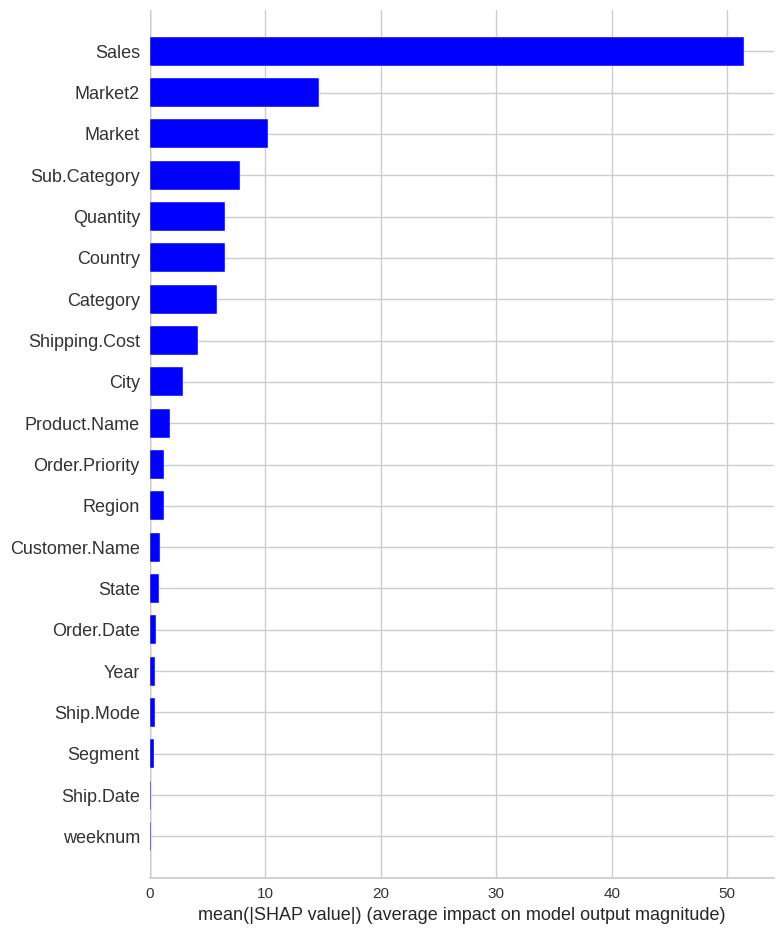

In [173]:
# SHAP variable importance for a Linear Model
shap.summary_plot(linear_shap_values, x_train, plot_type="bar", color="blue")

For the linear model, Sales is the most important feature.

### Tree Based Model

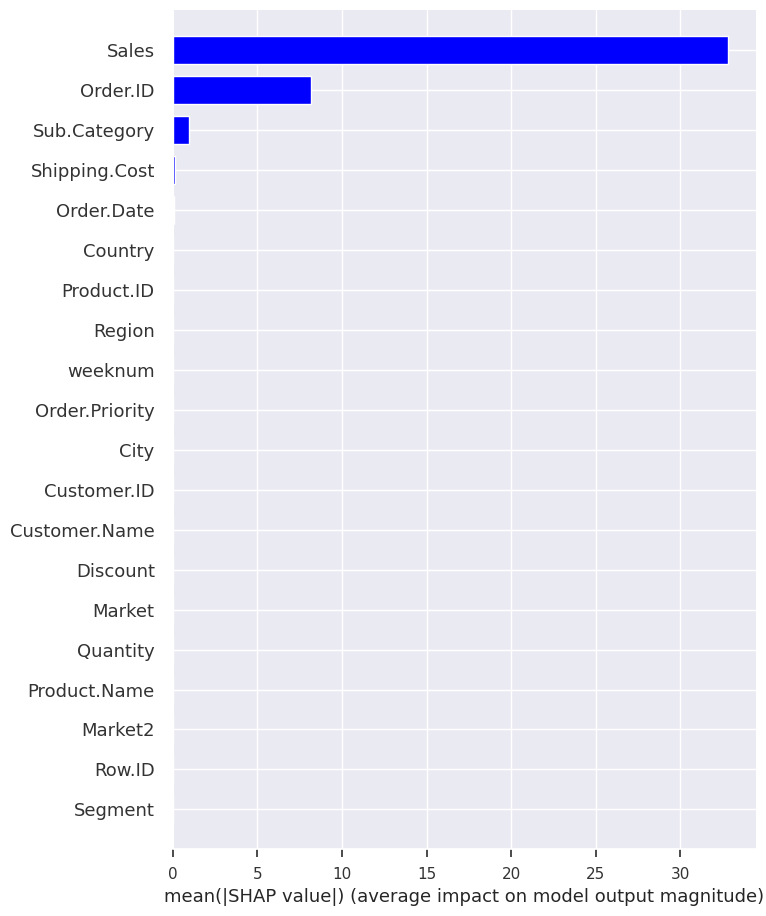

In [139]:
# SHAP variable importance for a Linear Model
shap.summary_plot(tree_shap_values, x_train, plot_type="bar", color="blue")

For tree based model, Sales is the most important feature.

## Interpreting Waterfall SHAP Visualization

### Linear Model

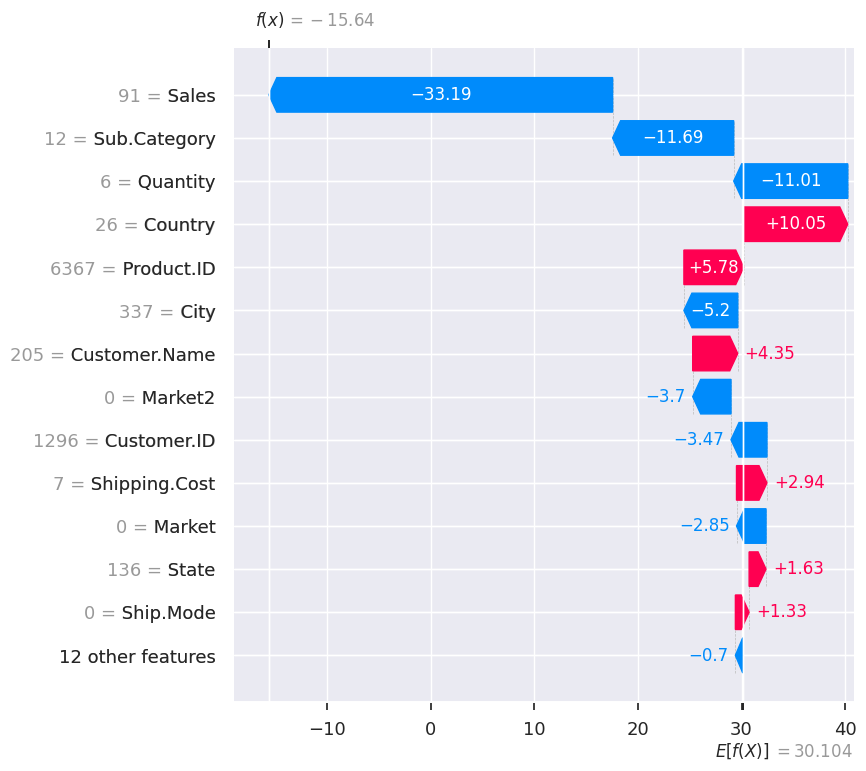

In [140]:
# Waterfall plot for linear model
shap.plots.waterfall(linear_shap_values[sample_ind], max_display=14)

For the linear model,  Sales with a value of 91 has a significant negative impact on the prediction, decreasing it by 33.19 from the base value. Country with a value of 26 push the prediction higher than the base value by 10.05.

### Tree Based Model

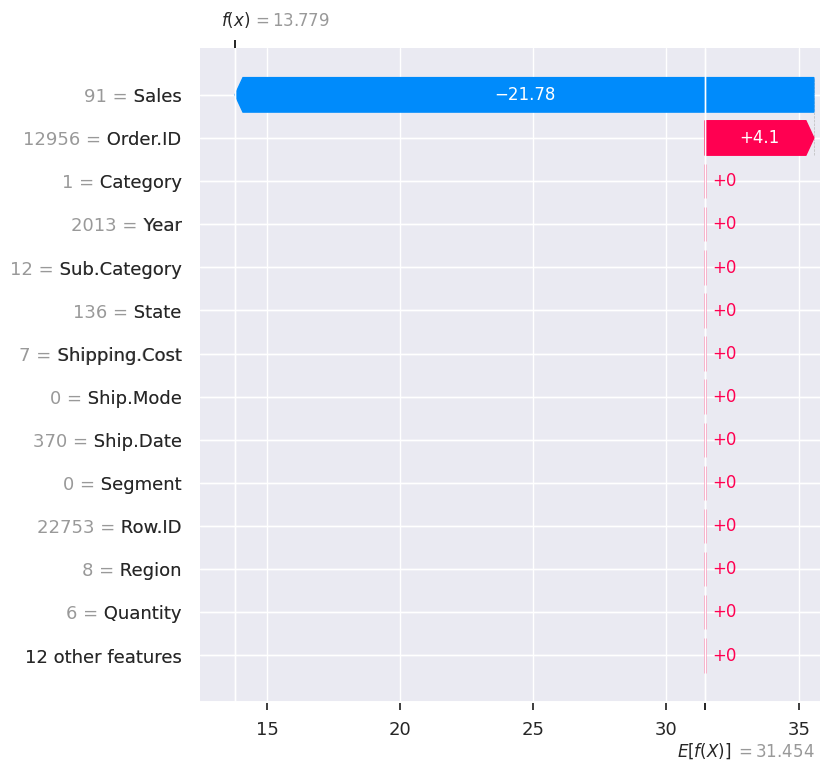

In [141]:
# Waterfall plot for Tree Based Model
shap.plots.waterfall(tree_shap_values[sample_ind], max_display=14)


* Base Value (E[f(X)]) : The base value represents the average model output over the training dataset passed to the SHAP explainer. This can be interpreted as the starting point for predictions before individual feature effects are considered.

* Output Value (f(X)): The output value is the actual prediction for the individual instance being explained by this SHAP plot.

* Feature Contributions: Each feature contributes either positively or negatively towards moving the prediction from the base value to the output value. The plot shows these contributions for each feature for the specific instance:

* Red Bars (Negative Impact): Features that push the prediction lower than the base value. For instance, Sales with a value of 91 has a significant negative impact on the prediction, decreasing it by 21.78 from the base value.

* Blue Bars (Positive Impact): Features that push the prediction higher than the base value.

* Feature Values: The value of each feature for this particular instance is given on the left.

## Summary Plot

Here the features are listed in descending order of their importance. This is one of the easiest ways to analyze an ML model and how the features are affecting the target and to what extent.

This visual representation shows the red dots representing higher values and blue dots representing lower values. The position of each dot on the x-axis indicates the intensity of its impact, with dots further from the y-axis having a greater impact. Positive impacts are shown on the right side of the y-axis, while negative impacts are on the left.


This visualization is very useful when it comes to interpreting how our model is working.

### Linear Model

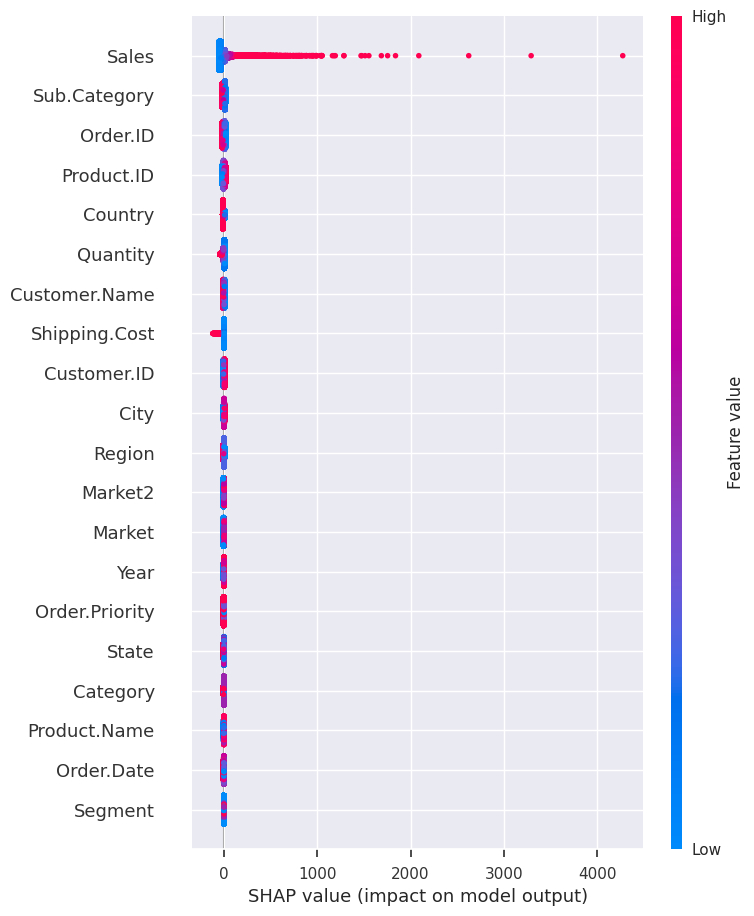

In [142]:
# SHAP summary for Linear Model
shap.summary_plot(linear_shap_values, x_train)

### Tree Based Model

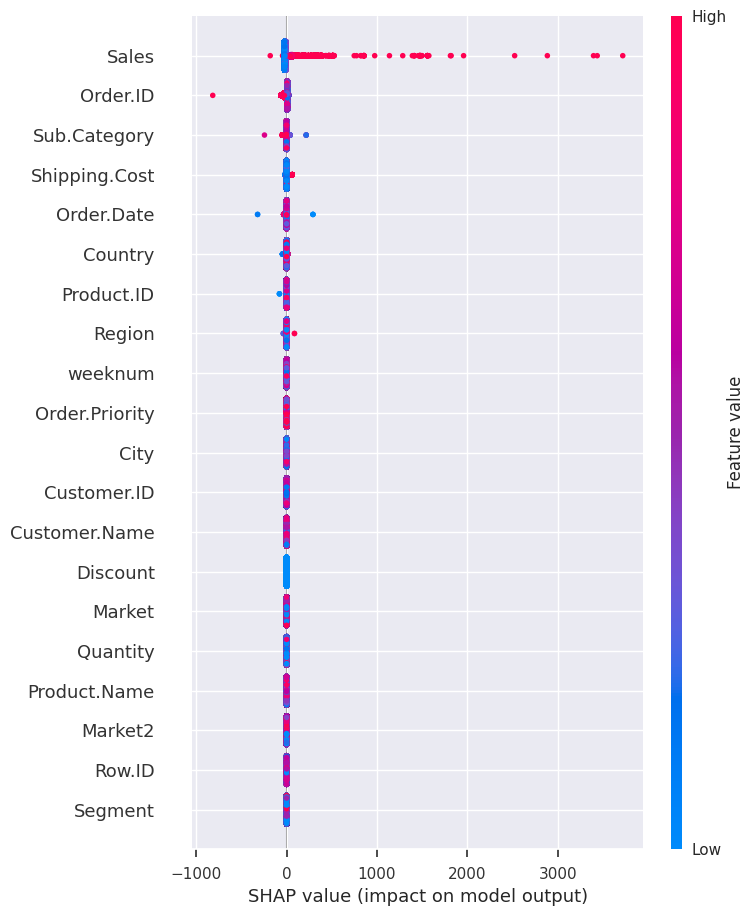

In [143]:
# SHAP summary for Tree Based Model
shap.summary_plot(tree_shap_values, x_train)

From both the models sales is the most important feature in predicting the target variable Profit.

## Comparision between SHAP, LIME, Partial Dependence Plot Analysis

SHAP (SHapley Additive exPlanations), LIME (Local Interpretable Model-agnostic Explanations), and Partial Dependence Plots (PDP) are all techniques used for interpreting and explaining the predictions of machine learning models

* SHAP values provide a global understanding of feature importance and how each feature contributes to each individual prediction.
* LIME provides local interpretations of model predictions, focusing on explaining the model's behavior for a specific instance rather than the overall behavior of the model.
* PDP plots show how the predicted outcome changes as the value of a specific feature varies, while holding the values of other features constant at their average or a specified value

# Question-1: What is the question?

The question is to train the regression model for predicting the target variable 'Profit' with significant set of features. Data should be cleaned and the missing values should be imputed with mean, median or mode. Features should be selected based on the feature importance by implementing different methods. Different models like Linear Regression model, Random Forest Regression Model, AutoML model should be trained on the given dataset. The models shoudl be interpreted with different analysis methods like SHAP analysis, LIME analysis, PDP plots.

# Question-2: What did you do?

1. With the given dataset, I have encoded the data before training the regression model and converted categorical data into numeric data.
2. Performed several checks if there is missing data, whether independent variables are dependent on each other or not, multicollinearity between variables.
3. Removed outliers and checked the performance of model before and after. After removing the outliers, the error have been reduced.
4. The data is deleted randomly and imputed back with mean, median, mode imputation methods and bias, variance is checked. Imputing by mean is the best practice as there is less bias and variance in this method.
5. AutoML is implemented and the best model is Stacked Ensemble which has an r^2 value of 0.83 for training data, 0.52 on validation data.
6. By checking VIF, p_values few insignificant variables are dropped and then the model is trained with the updated dataset. The r^2 has been decreased when compared to the original dataset.
7. Performed checks whether regularization helped in improving model's performance or not
8. Performed hyperparameter tuning
9. Trained linear model, random forest model, AutoML model and performed SHAP, LIME, PDP analysis.
10. All the model's performances are interpreted with different analysis techniques.

# Question-3: How well did it work?

1. When the AutoML model is trained on the original data it worked better than the model trained after dropping certain insignificant variables.
2. The multicollinearity issue is resolved by dropping variables which are highly correlated with each other.
3. The most important features in predicting the target variable are Sales, Shipping.Cost, Category, Quantity.
4. AutoML helps us finding the best model automatedly without actually training different models on the dataset which reduces the time consumes and the effort and increases the accuracy, model's performance.
5. Initially when the model is trained, the model's accuracy is around 22% but with the best model trained by AutoML the model's accuracy increased to 82% for training data.

# Question-4: What did you learn?

I have learnt multiple things when working on the assignment like:

1. Encoding the data and converting categorical to numerical data
2. Training linear regression model
3. Identifying the significant features which has strong contribution towards predicting the target variable with multiple methods
4. Performing VIF, OLS analysis and dropping the variables which has high multicollinearity
5. Identifying the best model by training h2O AutoML and the broad scope of AutoML also gives the performace metrics of all the models trained by it which makes the user to understand easily and pick the model which fits best for their use case.
6. The need of scaling the data before interpreting the coefficients
7. Performing regularization and understanding about L1, L2 Regression methods
8. Hyperparameter tuning
9. Performing SHAP, LIME, PDP analysis on different models trained on the dataset.
10. Analyzing the graphs to understand how the model is performing on the dataset.

# Conclusion

For the global superstore dataset, a linear model, tree based model (Random Forest Regressor), AutoML model is trained. With the AutoML, the best model is  Stacked Ensemble with the r^2 value of 0.83 for training data, 0.52 for validation data. Imputation with mean is the best imputation method when checked by removing 1%, 5%, 10% of data and imputed back with mean, median, and mode. Regularization has no impact on the model's performance. With the hyperparameter tuning, the best parameters are: {'n_estimators': 100, 'min_samples_split': 2, 'max_depth': 200}. SHAP, LIME, PDP analysis are performed on all the models and the feature importance is identified. Independent variables which are highly correlated with each other are dropped to avoid further multicollinearity issue. After dropping the insignificant variables, the AutoML model is trained on the updated where the model's performance has been decreased when compared to the model's performance trained on original data.

# References

1. OLS Model- http://net-informations.com/ds/mla/ols.html

2. Linear Regression- https://www.analyticsvidhya.com/blog/2021/05/all-you-need-to-know-about-your-first-machine-learning-model-linear-regression/

3. Linear Regression Assumptions- https://www.statisticssolutions.com/free-resources/directory-of-statistical-analyses/assumptions-of-linear-regression/

4. Professor's AutoML Notebook- https://github.com/nikbearbrown/AI_Research_Group/tree/main/Kaggle_Datasets/AutoML